1. Importación de librerías
Se importan librerías estándar de Python para manejo de datos (numpy, pandas, polars), visualización (matplotlib, seaborn), procesamiento paralelo (joblib, more_itertools), y machine learning (sklearn). Esto prepara el entorno para análisis, ingeniería de features y modelado.

In [1]:
# --- Standard Library ---
import os
import gc
import json
import glob
from calendar import monthrange
from functools import reduce
from typing import List

# --- Third-Party Libraries ---
import numpy as np
import pandas as pd
import polars as pl
import matplotlib.pyplot as plt
import joblib
from joblib import Parallel, delayed
from more_itertools import chunked
from scipy.stats import skew, kurtosis
import holidays

# --- Machine Learning ---
import optuna
from lightgbm import LGBMRegressor, early_stopping
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import LabelEncoder, StandardScaler

# --- PyTorch (if needed) ---
# import torch.nn as nn


/opt/conda/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Se descarga y carga el dataset principal desde Google Drive, almacenándolo en el DataFrame df_agrupado.

In [ ]:
url = "https://drive.google.com/uc?export=download&id=1jX8gtd7hpLwSrjwkasjG3TZJ3TGIvNzF"
df_agrupado = pd.read_csv(url)

🧠 Generación de características estadísticas sobre series temporales
En esta sección se definen funciones que generan un conjunto enriquecido de features estadísticas y temporales a partir de la evolución histórica de ventas (TN) por producto. Estas características permiten capturar patrones, tendencias, estacionalidades y comportamientos atípicos en la serie temporal, mejorando el poder predictivo de los modelos.

⚙️ add_global_features(group)
Esta función toma como entrada un subconjunto de datos correspondiente a un producto (o grupo) ordenado por periodo (PERIODO), y genera variables globales útiles para el análisis temporal:

- FECHA, MES: extracción de componentes temporales a partir del periodo.
- IS_FEBRERO: indicador binario para meses de febrero.
- ESTOY_PREDICIENDO_FEBRERO: flag para detectar si el periodo actual es diciembre (clave al predecir febrero en t+2).
- CAIDA_ABRUPTA: identifica caídas fuertes de un periodo a otro usando el umbral CAIDA_UMBRAL.
- PROM_ULT_3_FEBREROS: promedio de los últimos 3 valores de febrero previos al periodo actual.
- DIF_TN_VS_FEBREROS_ULT_3: diferencia entre el valor actual y dicho promedio.
- TN_MAX_HISTORICO: valor máximo de TN observado hasta el momento.
- TN_DIST_A_MAX_HIST y TN_RATIO_VS_MAX_HIST: diferencia y proporción del valor actual respecto al máximo histórico.
- Estas features globales permiten capturar efectos estacionales y de referencia en relación a eventos pasados del mismo mes.

Estas features globales permiten capturar efectos estacionales y de referencia en relación a eventos pasados del mismo mes.

🔁 calcular_pendientes_grupo(group, periodos_list)
Esta función extiende add_global_features y calcula una gran cantidad de estadísticas móviles (rolling features) sobre ventanas temporales de tamaños especificados en periodos_list (por ejemplo, 3, 6, 12 meses).

Para cada ventana cant, se calculan:

📊 Estadísticas básicas:
TN_MEAN_xx, TN_MEDIAN_xx, TN_MIN_xx, TN_MAX_xx, TN_STD_xx, TN_SUM_xx, TN_IQR_xx, TN_GROWTH_xx, etc.

📈 Tendencia y dispersión:
- PENDIENTE_TENDENCIA_xx: pendiente de una regresión lineal sobre la ventana.
- TN_SKEW_xx, TN_KURT_xx: asimetría y curtosis.

📌 Indicadores útiles:
- TN_COUNT_POS_xx: cantidad de valores positivos.
- TN_PCT_ZERO_xx: proporción de ceros.
- TN_LAST_xx, TN_LAST_DIFF_xx: último valor y su variación respecto al anterior.
- TN_LAST_PCT_SUM_xx: cuánto representa el último valor del total. 
- TN_ZEROS_END_xx: cuántos ceros consecutivos hay al final de la ventana.
- TN_PCT10_xx, TN_PCT90_xx, TN_PCT_WIDTH_xx: percentiles y amplitud interpercentil.

🔄 Comparaciones del valor actual (TN) con estadísticas móviles:
- TN_MINUS_MEAN_xx, TN_MINUS_MEDIAN_xx, TN_MINUS_EWMA_xx: diferencia respecto a media, mediana y suavizado exponencial.
- TN_OVER_MEAN_xx, TN_OVER_MEDIAN_xx, TN_OVER_EWMA_xx: razón del valor actual sobre estas estadísticas.

🧭 Dinámica temporal:
- TN_CHANGE_PREV_WINDOW_xx: cambio entre la media de la ventana actual y la anterior.
- TN_LAST_VS_MEDIAN_xx: diferencia entre el último valor y la mediana de la ventana.

In [ ]:
# --- Configuración de feriados para Argentina ---
feriados_ar = holidays.AR()

# --- Función auxiliar para PERIODO + 2 ---
def extraer_info_calendario(periodo):
    try:
        anio = int(str(periodo)[:4])
        mes = int(str(periodo)[4:])
        mes_pred = mes + 2
        anio_pred = anio
        if mes_pred > 12:
            mes_pred -= 12
            anio_pred += 1
        
        dias_mes = monthrange(anio_pred, mes_pred)[1]
        fechas_mes = pd.date_range(start=f"{anio_pred}-{mes_pred:02d}-01", periods=dias_mes)

        dias_habiles = fechas_mes[fechas_mes.weekday < 5]
        feriados = [f for f in fechas_mes if f in feriados_ar]
        dias_laborables = [d for d in dias_habiles if d not in feriados]

        return pd.Series({
            "DIAS_MES_PRED": dias_mes,
            "DIAS_HABILES_PRED": len(dias_habiles),
            "FERIADOS_PRED": len(feriados),
            "DIAS_LABORABLES_PRED": len(dias_laborables),
        })
    except:
        return pd.Series({
            "DIAS_MES_PRED": np.nan,
            "DIAS_HABILES_PRED": np.nan,
            "FERIADOS_PRED": np.nan,
            "DIAS_LABORABLES_PRED": np.nan,
        })

# --- Aplicar al DataFrame ---
df_agrupado = df_agrupado.copy()
df_agrupado = df_agrupado.join(df_agrupado['PERIODO'].apply(extraer_info_calendario))

# --- Verificación rápida ---
print(df_agrupado[['PERIODO', 'DIAS_MES_PRED', 'DIAS_HABILES_PRED', 'FERIADOS_PRED', 'DIAS_LABORABLES_PRED']].head())


In [ ]:
ROLL_BASE = 12
CAIDA_UMBRAL = -100

def add_global_features(group):
    group = group.sort_values('PERIODO').copy()
    group['FECHA'] = pd.to_datetime(group['PERIODO'].astype(str), format='%Y%m')
    group['MES'] = group['FECHA'].dt.month
    group['IS_FEBRERO'] = (group['MES'] == 2).astype(int)
    group['ESTOY_PREDICIENDO_FEBRERO'] = (group['MES'] == 12).astype(int)

    group['CAIDA_ABRUPTA'] = (group['TN'].diff(1) < CAIDA_UMBRAL).astype(int)
    
    # Tomar solo los febreros históricos
    febreros = group[group['MES'] == 2][['PERIODO', 'TN']].sort_values('PERIODO').reset_index(drop=True)
    # Calcular el rolling promedio (sin el actual, siempre pasado)
    febreros['PROM_ULT_3_FEBREROS'] = febreros['TN'].shift(1).rolling(window=3, min_periods=1).mean()
    
    # Hacer merge con el original: para cada PERIODO, ¿cuál fue el último promedio disponible?
    # Vamos a usar merge_asof para asignar el promedio más reciente antes o igual al periodo actual
    group = group.sort_values('PERIODO').reset_index(drop=True)
    group = pd.merge_asof(
        group, 
        febreros[['PERIODO', 'PROM_ULT_3_FEBREROS']],
        by=None, left_on='PERIODO', right_on='PERIODO', 
        direction='backward', 
        allow_exact_matches=False
    )
    # Si no hay historial, pone cero (puede cambiar a np.nan si preferís)
    group['PROM_ULT_3_FEBREROS'] = group['PROM_ULT_3_FEBREROS'].fillna(0)
    group['DIF_TN_VS_FEBREROS_ULT_3'] = group['TN'] - group['PROM_ULT_3_FEBREROS']



    # Max histórico HASTA el momento (expanding + shift)
    group['TN_MAX_HISTORICO'] = group['TN'].shift(1).expanding().max().fillna(0)
    group['TN_DIST_A_MAX_HIST'] = group['TN_MAX_HISTORICO'] - group['TN']
    group['TN_RATIO_VS_MAX_HIST'] = (group['TN'] / (group['TN_MAX_HISTORICO'] + 1e-8)).clip(lower=0, upper=5)


    return group


def calcular_pendientes_grupo(group, periodos_list):
    group = add_global_features(group)
    group = group.sort_values(by='PERIODO').copy()
    n = len(group)
    y_values = group['TN'].values
    for cant in periodos_list:
        means = np.zeros(n)
        pendientes = np.zeros(n)
        ewmas = np.zeros(n)
        medians = np.zeros(n)
        minimo = np.zeros(n)
        maximo = np.zeros(n)
        stds = np.zeros(n)
        skews = np.zeros(n)
        kurts = np.zeros(n)
        growths = np.zeros(n)
        iqrs = np.zeros(n)
        sums = np.zeros(n)
        count_pos = np.zeros(n)
        pct_zero = np.zeros(n)
        last = np.zeros(n)
        last_diff = np.zeros(n)

        coef_var = np.zeros(n)
        maxmin_ratio = np.zeros(n)
        rango = np.zeros(n)
        rango_rel = np.zeros(n)
        last_vs_median = np.zeros(n)
        cambio_ventana = np.zeros(n)
        zeros_end = np.zeros(n)
        last_pct_sum = np.zeros(n)
        pct_90 = np.zeros(n)
        pct_10 = np.zeros(n)
        pct_width = np.zeros(n)

        # --- Comparaciones TN vs rolling stats ---
        tn_minus_mean = np.zeros(n)
        tn_minus_median = np.zeros(n)
        tn_minus_ewma = np.zeros(n)
        tn_over_mean = np.zeros(n)
        tn_over_median = np.zeros(n)
        tn_over_ewma = np.zeros(n)

        x = np.arange(cant)
        for i in range(n):
            # Solo procesar si la ventana está completa
            if i >= cant - 1:
                y = y_values[i - (cant - 1): i + 1]
                means[i] = np.mean(y)
                try:
                    pendientes[i] = np.polyfit(x, y, 1)[0]
                except:
                    pendientes[i] = 0
                ewmas[i] = pd.Series(y).ewm(span=cant, adjust=False).mean().iloc[-1]
                medians[i] = np.median(y)
                minimo[i] = np.min(y)
                maximo[i] = np.max(y)
                std_y = np.std(y)
                mean_y = means[i]
                stds[i] = std_y
                skews[i] = skew(y) if std_y > 0 else 0
                kurts[i] = kurtosis(y) if std_y > 0 else 0
                growths[i] = (y[-1] - y[0]) / (y[0] + 1e-8) if y[0] != 0 else 0
                iqrs[i] = np.percentile(y, 75) - np.percentile(y, 25)
                sums[i] = np.sum(y)
                count_pos[i] = np.sum(y > 0)
                pct_zero[i] = np.mean(y == 0)
                last[i] = y[-1]
                last_diff[i] = y[-1] - y[-2] if cant > 1 else 0

                coef_var[i] = std_y / (mean_y + 1e-8) if mean_y != 0 else 0
                maxmin_ratio[i] = maximo[i] / (minimo[i] + 1e-8) if minimo[i] != 0 else 0
                rango[i] = maximo[i] - minimo[i]
                rango_rel[i] = rango[i] / (minimo[i] + 1e-8) if minimo[i] != 0 else 0
                last_vs_median[i] = y[-1] - np.median(y)
                # Cambio de ventana anterior a actual
                if i >= 2 * cant - 1:
                    y_prev = y_values[i - (2 * cant - 1):i - cant + 1]
                    mean_prev = np.mean(y_prev)
                    cambio_ventana[i] = (mean_y - mean_prev) / (mean_prev + 1e-8) if mean_prev != 0 else 0
                zeros_end[i] = np.argmax(y[::-1] != 0)
                last_pct_sum[i] = y[-1] / (np.sum(y) + 1e-8) if np.sum(y) != 0 else 0
                pct_90[i] = np.percentile(y, 90)
                pct_10[i] = np.percentile(y, 10)
                pct_width[i] = pct_90[i] - pct_10[i]

                # Comparaciones TN vs rolling stats
                tn_actual = y_values[i]
                tn_minus_mean[i] = tn_actual - means[i]
                tn_minus_median[i] = tn_actual - medians[i]
                tn_minus_ewma[i] = tn_actual - ewmas[i]
                tn_over_mean[i] = tn_actual / (means[i] + 1e-8) if means[i] != 0 else 0
                tn_over_median[i] = tn_actual / (medians[i] + 1e-8) if medians[i] != 0 else 0
                tn_over_ewma[i] = tn_actual / (ewmas[i] + 1e-8) if ewmas[i] != 0 else 0
            # Si la ventana no está completa, todo queda en cero (ya inicializado)

        group[f'TN_MEAN_{str(cant).zfill(2)}'] = means
        group[f'PENDIENTE_TENDENCIA_{cant}'] = pendientes
        group[f'TN_EWMA_{str(cant).zfill(2)}'] = ewmas
        group[f'TN_MEDIAN_{str(cant).zfill(2)}'] = medians
        group[f'TN_MIN_{str(cant).zfill(2)}'] = minimo
        group[f'TN_MAX_{str(cant).zfill(2)}'] = maximo
        group[f'TN_STD_{str(cant).zfill(2)}'] = stds
        group[f'TN_SKEW_{str(cant).zfill(2)}'] = skews
        group[f'TN_KURT_{str(cant).zfill(2)}'] = kurts
        group[f'TN_GROWTH_{str(cant).zfill(2)}'] = growths
        group[f'TN_IQR_{str(cant).zfill(2)}'] = iqrs
        group[f'TN_SUM_{str(cant).zfill(2)}'] = sums
        group[f'TN_COUNT_POS_{str(cant).zfill(2)}'] = count_pos
        group[f'TN_PCT_ZERO_{str(cant).zfill(2)}'] = pct_zero
        group[f'TN_LAST_{str(cant).zfill(2)}'] = last
        group[f'TN_LAST_DIFF_{str(cant).zfill(2)}'] = last_diff

        group[f'TN_COEF_VAR_{cant}'] = coef_var
        group[f'TN_MAXMIN_RATIO_{cant}'] = maxmin_ratio
        group[f'TN_RANGO_{cant}'] = rango
        group[f'TN_RANGO_REL_{cant}'] = rango_rel
        group[f'TN_LAST_VS_MEDIAN_{cant}'] = last_vs_median
        group[f'TN_CHANGE_PREV_WINDOW_{cant}'] = cambio_ventana
        group[f'TN_ZEROS_END_{cant}'] = zeros_end
        group[f'TN_LAST_PCT_SUM_{cant}'] = last_pct_sum
        group[f'TN_PCT90_{cant}'] = pct_90
        group[f'TN_PCT10_{cant}'] = pct_10
        group[f'TN_PCT_WIDTH_{cant}'] = pct_width

        # Comparaciones TN vs rolling stats
        group[f'TN_MINUS_MEAN_{str(cant).zfill(2)}'] = tn_minus_mean
        group[f'TN_MINUS_MEDIAN_{str(cant).zfill(2)}'] = tn_minus_median
        group[f'TN_MINUS_EWMA_{str(cant).zfill(2)}'] = tn_minus_ewma
        group[f'TN_OVER_MEAN_{str(cant).zfill(2)}'] = tn_over_mean
        group[f'TN_OVER_MEDIAN_{str(cant).zfill(2)}'] = tn_over_median
        group[f'TN_OVER_EWMA_{str(cant).zfill(2)}'] = tn_over_ewma

    return group

⚙️ Cálculo paralelo de estadísticas temporales por producto
Se define una función llamada calcular_pendientes_parallel que aplica la ingeniería de variables temporales sobre el conjunto completo de productos de forma paralela, lo que permite acelerar considerablemente el procesamiento.

🧩 Descripción del procedimiento
Agrupamiento por producto
Se separan los datos por PRODUCT_ID, de modo que cada grupo contenga la serie temporal correspondiente a un único producto.

Procesamiento en paralelo
Usando joblib.Parallel, se aplica la función calcular_pendientes_grupo (que genera estadísticas móviles e indicadores por ventana) a cada grupo de productos en paralelo, distribuyendo el trabajo en n_jobs procesos.

Unificación de resultados
Se concatenan todos los resultados en un único DataFrame (df_final), garantizando que no queden valores infinitos ni nulos (NaN), reemplazándolos por cero para mantener consistencia.

⚙️ Parámetros principales
df: DataFrame original agrupado por producto.

periodos_list: lista de tamaños de ventanas móviles sobre las cuales se calculan las estadísticas.

n_jobs: número de procesos paralelos a utilizar (ajustable según los núcleos disponibles).

In [ ]:
def calcular_pendientes_parallel(df, periodos_list=[3, 6, 9, 12, 18], n_jobs=28):
    grupos = [group for _, group in df.groupby('PRODUCT_ID')]
    resultados = Parallel(n_jobs=n_jobs, backend='loky', verbose=10)(
        delayed(calcular_pendientes_grupo)(group, periodos_list) for group in grupos
    )
    df_final = pd.concat(resultados, ignore_index=True)
    df_final.replace([np.inf, -np.inf], 0, inplace=True)
    df_final.fillna(0, inplace=True)
    return df_final

df_agrupado = calcular_pendientes_parallel(df_agrupado, periodos_list=[3, 6, 9, 12, 18], n_jobs=28)

### 🔁 Generación de variables lag y delta

Se generan variables `lag` y `delta` sobre la variable objetivo `TN`, calculadas por grupo de producto (`PRODUCT_ID`) y ordenadas de forma descendente por el campo `ORDINAL`.

Para cada ventana temporal definida en `lags = [3, 6, 9, 12, 18]`, se calculan:

- `TN_LAG_xx`: valor de `TN` con un desplazamiento hacia el futuro de `xx` periodos (dado que el orden es descendente).
- `TN_DELTA_xx`: diferencia entre el valor actual de `TN` y su respectivo `lag`.

Estas variables permiten capturar el comportamiento reciente de la serie y medir variaciones en diferentes horizontes temporales.

In [ ]:
lags = [3, 6, 9, 12, 18]
group_cols = ['PRODUCT_ID']

# Ordenar de forma cronológica (ORDINAL ascendente)
df_agrupado = df_agrupado.sort_values(group_cols + ['ORDINAL'], ascending=[True, True])

for lag in lags:
    lag_col = f'TN_LAG_{lag:02d}'
    delta_col = f'TN_DELTA_{lag:02d}'
    
    # Lag tradicional: hacia el pasado (ej. en t=10, el lag 3 es t=7)
    df_agrupado[lag_col] = (
        df_agrupado.groupby(group_cols)['TN']
        .shift(lag)  # ✅ correcto: va al pasado
        .fillna(0)
    )
    
    # Delta entre el valor actual y el de hace n períodos
    df_agrupado[delta_col] = df_agrupado['TN'] - df_agrupado[lag_col]


### 📈 Cálculo de métricas adicionales sobre ventanas móviles

Sobre ventanas móviles de 3, 6, 9, 12 y 18 periodos, se generaron nuevas variables por producto (`PRODUCT_ID`) a partir de la serie `TN`, con el objetivo de capturar distintos aspectos del comportamiento reciente de la serie.

Para cada ventana se calcularon:

- `TN_GROWTH_xx`: crecimiento porcentual respecto al valor observado `xx` periodos atrás (`lag`).
- `TN_COUNT_ZERO_xx`: cantidad de ceros en la ventana.
- `TN_SIGN_CHANGES_xx`: cantidad de cambios de signo (positivo ↔ negativo).
- `TN_COEF_VAR_xx`: coeficiente de variación, como relación entre el desvío estándar y la media.
- `TN_OUTLIER_PROP_xx`: proporción de valores considerados outliers (más de 2 desvíos estándar respecto a la media).
- `TN_PCT_POS_xx`: proporción de ventas mayores a cero.

Estas variables permiten describir la estabilidad, dispersión, presencia de outliers y comportamiento general reciente de la variable objetivo.


In [ ]:
# --- Parámetros ---
windows = [3, 6, 9, 12, 18]
group_cols = ['PRODUCT_ID']  # Podés agregar más si agrupás por otras claves
target_col = 'TN'

# --- Asegurar orden temporal correcto para rolling ---
df_agrupado = df_agrupado.sort_values(group_cols + ['ORDINAL'], ascending=True)

# --- Función auxiliar para proporción de outliers (> 2 * std) ---
def outlier_prop(x):
    m = np.nanmean(x)
    s = np.nanstd(x)
    if s == 0:
        return 0
    return np.mean(np.abs(x - m) > 2 * s)

# --- Loop por cada ventana temporal ---
for w in windows:
    # 1. CRECIMIENTO PERCENTUAL (respecto al lag ya calculado)
    lag_col = f'{target_col}_LAG_{w:02d}'
    growth_col = f'{target_col}_GROWTH_{w:02d}'
    if lag_col in df_agrupado.columns:
        df_agrupado[growth_col] = (
            (df_agrupado[target_col] - df_agrupado[lag_col]) /
            (df_agrupado[lag_col].replace(0, np.nan))
        ).fillna(0)

    # 2. CANTIDAD DE CEROS en la ventana
    count_zero_col = f'{target_col}_COUNT_ZERO_{w:02d}'
    df_agrupado[count_zero_col] = (
        df_agrupado
        .groupby(group_cols)[target_col]
        .rolling(window=w, min_periods=1)
        .apply(lambda x: np.sum(x == 0), raw=True)
        .reset_index(level=0, drop=True)
    )

    # 3. CAMBIOS DE SIGNO
    sign_change_col = f'{target_col}_SIGN_CHANGES_{w:02d}'
    df_agrupado[sign_change_col] = (
        df_agrupado
        .groupby(group_cols)[target_col]
        .rolling(window=w, min_periods=2)
        .apply(lambda x: np.sum(np.diff(np.sign(x)) != 0), raw=True)
        .reset_index(level=0, drop=True)
    )

    # 4. MEDIA y DESVÍO ESTÁNDAR (si no existen)
    mean_col = f'{target_col}_MEAN_{w:02d}'
    std_col = f'{target_col}_STD_{w:02d}'
    if mean_col not in df_agrupado.columns:
        df_agrupado[mean_col] = (
            df_agrupado.groupby(group_cols)[target_col]
            .rolling(window=w, min_periods=1)
            .mean()
            .reset_index(level=0, drop=True)
        )
    if std_col not in df_agrupado.columns:
        df_agrupado[std_col] = (
            df_agrupado.groupby(group_cols)[target_col]
            .rolling(window=w, min_periods=1)
            .std()
            .fillna(0)
            .reset_index(level=0, drop=True)
        )

    # 5. COEFICIENTE DE VARIACIÓN
    coef_var_col = f'{target_col}_COEF_VAR_{w:02d}'
    df_agrupado[coef_var_col] = (
        df_agrupado[std_col] / df_agrupado[mean_col].replace(0, np.nan)
    ).fillna(0)

    # 6. PROPORCIÓN DE OUTLIERS
    outlier_col = f'{target_col}_OUTLIER_PROP_{w:02d}'
    df_agrupado[outlier_col] = (
        df_agrupado
        .groupby(group_cols)[target_col]
        .rolling(window=w, min_periods=2)
        .apply(outlier_prop, raw=True)
        .reset_index(level=0, drop=True)
    )

    # 7. PROPORCIÓN DE VALORES POSITIVOS
    pct_pos_col = f'{target_col}_PCT_POS_{w:02d}'
    df_agrupado[pct_pos_col] = (
        df_agrupado
        .groupby(group_cols)[target_col]
        .rolling(window=w, min_periods=1)
        .apply(lambda x: np.mean(x > 0), raw=True)
        .reset_index(level=0, drop=True)
    )

# --- Columnas generadas (opcional para ver resumen) ---
cols_new = []
for w in windows:
    cols_new += [
        f'{target_col}_GROWTH_{w:02d}',
        f'{target_col}_COUNT_ZERO_{w:02d}',
        f'{target_col}_SIGN_CHANGES_{w:02d}',
        f'{target_col}_MEAN_{w:02d}',
        f'{target_col}_STD_{w:02d}',
        f'{target_col}_COEF_VAR_{w:02d}',
        f'{target_col}_OUTLIER_PROP_{w:02d}',
        f'{target_col}_PCT_POS_{w:02d}',
    ]

# Verificación rápida
print("Nuevas columnas generadas:")
print(cols_new)
print(df_agrupado[cols_new].isna().sum())

In [ ]:
# Hacer un EDA de la columna  CLASE en  df_agrupado
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# --- Estadísticas descriptivas ---
print("Estadísticas básicas de CLASE:")
print(df_agrupado['CLASE'].describe())

print("\nPrimeros valores únicos (si son pocos):", df_agrupado['CLASE'].unique()[:10])
print("Cantidad de valores únicos:", df_agrupado['CLASE'].nunique())

print("\nCantidad de nulos:", df_agrupado['CLASE'].isna().sum())

# --- Histograma ---
plt.figure(figsize=(8,4))
sns.histplot(df_agrupado['CLASE'], bins=30, kde=True)
plt.title("Histograma de CLASE")
plt.xlabel("CLASE")
plt.ylabel("Frecuencia")
plt.show()

# --- Boxplot para ver outliers ---
plt.figure(figsize=(8,2))
sns.boxplot(x=df_agrupado['CLASE'])
plt.title("Boxplot de CLASE")
plt.show()

# --- Distribución log-transformada (útil si hay muchos valores chicos y pocos grandes) ---
plt.figure(figsize=(8,4))
sns.histplot(np.log1p(df_agrupado['CLASE']), bins=30, kde=True)
plt.title("Histograma de log(1+CLASE)")
plt.xlabel("log(1+CLASE)")
plt.ylabel("Frecuencia")
plt.show()

# --- Percentiles y cuantiles ---
print("\nPercentiles de CLASE:")
print(df_agrupado['CLASE'].quantile([0, 0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99, 1]))

# --- Outliers extremos (más allá de 3 desviaciones estándar) ---
media = df_agrupado['CLASE'].mean()
std = df_agrupado['CLASE'].std()
outliers = df_agrupado[(df_agrupado['CLASE'] > media + 3*std) | (df_agrupado['CLASE'] < media - 3*std)]
print(f"\nCantidad de outliers (>3 desvíos): {len(outliers)}")


# --- Suma de CLASE por PERIODO y visualización temporal ---
if 'PERIODO' in df_agrupado.columns:
    # Agrupar y sumar CLASE por PERIODO
    df_suma_clase = df_agrupado.groupby('PERIODO', as_index=False)['CLASE'].sum()
    
    # Convertir PERIODO a fecha para mejor visualización
    df_suma_clase['PERIODO_FECHA'] = pd.to_datetime(df_suma_clase['PERIODO'].astype(str), format='%Y%m')

    # Graficar
    plt.figure(figsize=(10, 4))
    sns.lineplot(x='PERIODO_FECHA', y='CLASE', data=df_suma_clase, errorbar=None)
    #sns.lineplot(x='PERIODO_FECHA', y='CLASE', data=df_suma_clase, ci=None)
    plt.title("Suma de CLASE por mes")
    plt.xlabel("PERIODO")
    plt.ylabel("Suma de CLASE")
    plt.tight_layout()
    plt.show()



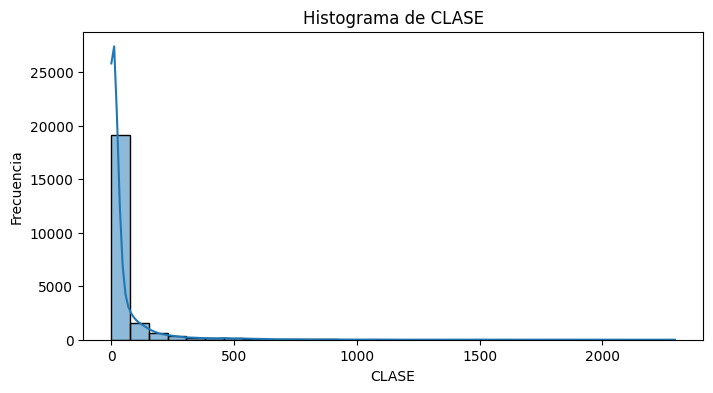

📊 Análisis de distribución: variable CLASE
🔹 Histograma original (CLASE)
El primer gráfico muestra el histograma de la variable CLASE sin transformar. Se observa una alta concentración de valores en el rango bajo, con una gran cantidad de registros cercanos a cero y una cola larga hacia la derecha, que indica la presencia de valores atípicos altos (distribución fuertemente asimétrica positiva).

Este tipo de distribución sesgada es común en variables de conteo o montos que pueden tomar muchos valores pequeños y algunos grandes (como ingresos, ventas, etc.). En este caso:

La mayoría de los valores están por debajo de 100.

Existen valores extremos por encima de 2000, aunque poco frecuentes.

Esta asimetría puede afectar negativamente el rendimiento de modelos sensibles a la escala o la normalidad de los datos (por ejemplo, regresión lineal o redes neuronales sin normalización adecuada).

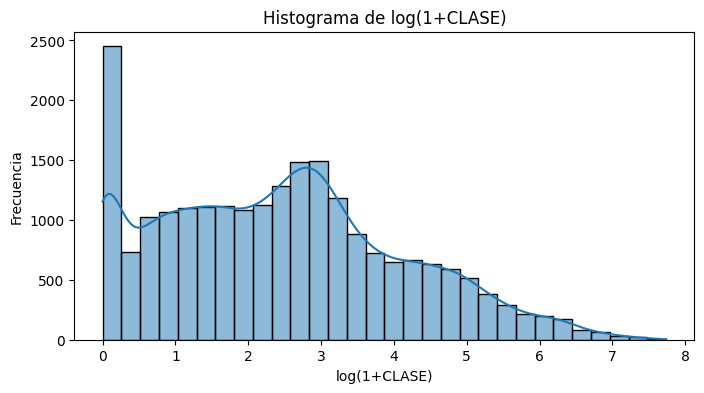

🔹 Histograma transformado (log(1 + CLASE))
El segundo gráfico muestra el histograma de log(1 + CLASE). Se aplica log(1 + x) para manejar los ceros sin generar valores indefinidos, ya que log(0) no está definido.

Con esta transformación:

La distribución se vuelve mucho más simétrica y cercana a una forma aproximadamente normal o al menos continua y más balanceada.

Los valores atípicos son "comprimidos", lo que reduce su efecto desproporcionado sobre los modelos.

La dispersión de los datos mejora, favoreciendo algoritmos que se benefician de distribuciones menos sesgadas (como MLP, k-NN, clustering, etc.).

✅ Justificación de la transformación
Transformar CLASE mediante log(1 + CLASE) es una práctica adecuada cuando:

La variable tiene valores positivos y altamente asimétricos, como en este caso.

Se quiere reducir el impacto de los outliers o valores extremos.

Se busca estabilizar la varianza para mejorar la calidad del modelado.

Se desea facilitar el entrenamiento de modelos lineales o redes neuronales que pueden verse perjudicadas por escalas tan dispares.



In [ ]:
df_agrupado['CLASE_LOG1P'] = np.log1p(df_agrupado['CLASE'])

# Eliminar las columnas CLASE  para evitar confusiones
df_agrupado.drop(columns=['CLASE'], inplace=True, errors='ignore')

In [ ]:
# Eliminar de df_agrupado la columna FECHA
df_agrupado = df_agrupado.drop(columns=['FECHA'], errors='ignore')

In [ ]:
cat_cols = ['ID_CAT1', 'ID_CAT2', 'ID_CAT3', 'ID_BRAND', 'SKU_SIZE','MES_PROBLEMATICO',
            'IS_FEBRERO', 'ESTOY_PREDICIENDO_FEBRERO','CAIDA_ABRUPTA']

for col in cat_cols:
    if col in df_agrupado.columns:
        df_agrupado[col] = df_agrupado[col].astype('category')

In [ ]:
df_agrupado.to_csv('./data/product_interm_LGBM.csv', index=False)

In [42]:
df_agrupado = pd.read_csv('./data/product_interm_LGBM.csv')

In [43]:
# df_full = pd.read_parquet('./data/product_interm_LGBM.parquet', engine='fastparquet')
# Separar conjuntos
df_full = df_agrupado
df_train = df_full[df_full['PERIODO'] <= 201908].copy()
df_val = df_full[df_full['PERIODO'].between(201909, 201909)].copy()
df_test = df_full[(df_full['PERIODO'] == 201910)].copy()
df_target_201912 = df_full[df_full['PERIODO'] == 201912].copy()
gc.collect()

32898

In [44]:
def total_forecast_error(y_true, y_pred):
    """
    Calcula el error porcentual total de pronóstico (Total Forecast Error),
    definido como la suma del error absoluto dividido por la suma total del valor real.

    Esta métrica es útil para evaluar el desempeño del modelo en términos relativos
    al volumen total observado, especialmente cuando se quiere penalizar proporcionalmente
    las desviaciones en función del tamaño real.

    Fórmula:
        TFE = sum(|y_true - y_pred|) / sum(y_true)

    Si la suma de y_true es cero, devuelve NaN para evitar división por cero.

    Parámetros:
        y_true (array-like): valores reales
        y_pred (array-like): valores predichos

    Retorna:
        float: error porcentual total
    """
    numerador = np.sum(np.abs(y_true - y_pred))
    denominador = np.sum(y_true)
    if denominador == 0:
        return np.nan
    return numerador / denominador

In [45]:
# --- SETUP ---
# En este caso, es la clase transformada con log1p (log(1 + x)), usada para estabilizar la varianza.
target_col = 'CLASE_LOG1P'
# Tienen baja feature importance y están fuertemente correlacionadas con otras de mayor importancia
excluir_features = ['TN_LAG_06', 'TN_STD_03', 'TN_IQR_06', 'TN_IQR_03', 'TN_MINUS_MEAN_03', 'TN_IQR_09', 'TN_OVER_MEDIAN_09', 
                    'PERIODO', 'TN_MIN_03', 'TN_MAX_03', 'TN_LAG_12', 'TN_IQR_12', 'TN_MEDIAN_03', 'TN_MIN_09', 'TN_OVER_MEDIAN_12', 
                    'TN_MEAN_03', 'TN_LAST_DIFF_06', 'TN_OVER_EWMA_06', 'TN_OVER_EWMA_09', 'TN_LAG_18', 'TN_PCT10_3', 'TN_MIN_06', 
                    'TN_MINUS_MEAN_06', 'TN_PCT90_3', 'TN_IQR_18', 'TN_EWMA_03', 'TN_MEDIAN_06', 'TN_PCT_WIDTH_9', 'TN_RANGO_6', 'TN_LAST_DIFF_12', 
                    'TN_STD_06', 'TN_MINUS_EWMA_06', 'TN_OVER_EWMA_12', 'TN_PCT10_6', 'TN_PCT_WIDTH_12', 'TN_LAST_DIFF_09', 'TN_RANGO_12', 
                    'TN_OVER_MEDIAN_18', 'TN_MIN_12', 'TN_PCT10_9', 'TRIMESTRE', 'TN_PCT10_12', 'TN_MINUS_EWMA_12', 'TN_MEDIAN_12', 
                    'TN_PCT_WIDTH_6', 'TN_MEDIAN_09', 'TN_STD_12', 'TN_MINUS_EWMA_09', 'TN_LAST_03', 'TN_RANGO_9', 'TN_OVER_EWMA_18', 
                    'TN_MIN_18', 'TN_MINUS_EWMA_18', 'TN_MINUS_MEAN_09', 'TN_MINUS_MEAN_12', 'TN_STD_09', 'TN_MEAN_06', 'TN_PCT_WIDTH_18', 
                    'TN_MINUS_MEAN_18', 'TN_COEF_VAR_09', 'TN_RANGO_REL_3', 'TN_MAX_06', 'TN_MAX_12', 'TN_OVER_MEAN_03', 
                    'TN_PCT90_9', 'TN_PCT10_18', 'TN_COEF_VAR_03', 'TN_PCT90_12', 'TN_EWMA_06', 'TN_MAX_09', 'TN_COEF_VAR_06', 'TN_PCT90_6', 
                    'TN_MEAN_09', 'TN_MEAN_12', 'TN_STD_18', 'TN_EWMA_09', 'TN_RANGO_18', 'TN_RANGO_REL_9', 'TN_EWMA_12', 'TN_MEDIAN_18', 
                    'TN_RANGO_REL_6', 'TN_MINUS_EWMA_03', 'TN_RANGO_3', 'TN_LAST_12', 'TN_RANGO_REL_12', 'TN_LAST_18', 'TN_LAST_06', 'TN_MAX_18', 
                    'TN_MINUS_MEDIAN_03', 'TN_LAST_09', 'TN_RANGO_REL_18', 'TN_MINUS_MEDIAN_06', 'TN_MINUS_MEDIAN_12', 'TN_EWMA_18', 'TN_PCT90_18', 
                    'TN_OVER_MEAN_06', 'TN_PCT_WIDTH_3', 'TN_MINUS_MEDIAN_09', 'TN_OVER_MEAN_09', 'TN_SUM_03', 'TN_MINUS_MEDIAN_18', 'TN_OVER_MEAN_12', 
                    'TN_OVER_MEAN_18', 'TN_OVER_EWMA_03', 'TN_SIGN_CHANGES_18', 'TN_SUM_06', 'TN_SUM_09', 'TN_SUM_12', 'TN_PCT_POS_18', 'ANIO', 
                    'TN_SUM_18', 'TN_SIGN_CHANGES_12', 'TN_COUNT_ZERO_06', 'TN_PCT_POS_12', 'TN_PCT_POS_06', 'TN_COUNT_ZERO_12', 'TN_PCT_POS_09', 
                    'TN_COUNT_ZERO_09', 'TN_COUNT_ZERO_03', 'TN_PCT_POS_03', 'TN_COUNT_POS_03', 'TN_ZEROS_END_12', 'TN_ZEROS_END_9', 'TN_ZEROS_END_18',
                    'TN_LAG_09', 'TN_MAX_HISTORICO', 'TN_LAG_03', 'TN_DELTA_12', 'TN_LAST_VS_MEDIAN_9', 'TN_LAST_PCT_SUM_18', 'TN_MEAN_18', 'TN_SIGN_CHANGES_09']

feature_cols = [
    col for col in df_train.columns
    if col != target_col and col not in excluir_features
]

X_tr = df_train[feature_cols]
y_tr = df_train[target_col]
X_val = df_val[feature_cols]
y_val = df_val[target_col]

## Optimización de Hiperparámetros para LightGBM usando Optuna

### 1. Definición de la Función Objetivo

Se define una función `objective_lgbm(trial)` que toma una muestra de hiperparámetros y entrena un modelo LightGBM para minimizar el error total de forecast (`Total Forecast Error`, TFE). Los hiperparámetros incluyen:

- `learning_rate`, `num_leaves`, `max_depth`, `n_estimators`
- Parámetros de regularización (`reg_alpha`, `reg_lambda`)
- Subsampling (`subsample`, `colsample_bytree`)
- Otros (`min_child_samples`, `min_split_gain`, `random_state`)

Se usa el `mean_absolute_error` (MAE) como métrica secundaria almacenada en los atributos del `trial`.

### 2. Creación del Estudio

Se crea un estudio con Optuna utilizando una base de datos SQLite local (`optuna_lgbm_study.db`), permitiendo que las ejecuciones se reanuden si ya existía el estudio. El objetivo es **minimizar** el TFE.

### 3. Ejecución de la Optimización

Se lanza la optimización con `n_trials=500` y `n_jobs=28` (ejecución paralela), buscando las mejores configuraciones para el modelo LightGBM.

### 4. Extracción de los Mejores Modelos

Se obtienen las 50 mejores configuraciones ordenadas por menor TFE. También se extrae el MAE asociado a cada configuración desde los atributos del `trial`.

### 5. Guardado de Resultados

- Se guardan todos los trials en un archivo CSV (`optuna_lgbm_trials.csv`)
- Se exportan los 50 mejores sets de hiperparámetros en un archivo JSON (`lgbm_ensemble_configs.json`), que puede reutilizarse para hacer un ensamble posterior.

### 6. Consola de Resumen

Se imprime en consola un resumen de los mejores TFE y MAE alcanzados en los 50 modelos más prometedores.

---


In [46]:
def get_objective_fixed(objective):
    def objective_lgbm(trial):
        boosting_type = "gbdt"

        n_estimators = trial.suggest_int("n_estimators", 800, 2000)
        learning_rate = trial.suggest_float("learning_rate", 0.001, 0.1, log=True)

        params = {
            "boosting_type": boosting_type,
            "objective": objective,
            "learning_rate": learning_rate,
            "num_leaves": trial.suggest_int("num_leaves", 16, 256),
            "max_depth": trial.suggest_int("max_depth", 4, 24),
            "n_estimators": n_estimators,
            "min_child_samples": trial.suggest_int("min_child_samples", 20, 120),
            "subsample": trial.suggest_float("subsample", 0.7, 1.0),
            "colsample_bytree": trial.suggest_float("colsample_bytree", 0.7, 1.0),
            "reg_alpha": trial.suggest_float("reg_alpha", 1e-2, 100.0, log=True),
            "reg_lambda": trial.suggest_float("reg_lambda", 1e-2, 100.0, log=True),
            "min_split_gain": trial.suggest_float("min_split_gain", 0.0, 0.2),
            "feature_fraction": trial.suggest_float("feature_fraction", 0.7, 1.0),
            "bagging_fraction": trial.suggest_float("bagging_fraction", 0.7, 1.0),
            "bagging_freq": trial.suggest_int("bagging_freq", 1, 8),
            "n_jobs": -1,
            "verbosity": -1,
            "random_state": trial.number,
        }

        if objective == "huber":
            params["alpha"] = trial.suggest_float("huber_alpha", 0.8, 0.99)
        elif objective == "quantile":
            params["alpha"] = trial.suggest_float("quantile_alpha", 0.2, 0.8)

        model = LGBMRegressor(**params)
        callbacks = [early_stopping(stopping_rounds=100, verbose=False)]

        model.fit(
            X_tr, y_tr,
            eval_set=[(X_val, y_val)],
            callbacks=callbacks
        )

        preds = model.predict(X_val)
        y_val_orig = np.expm1(y_val.values)
        preds_orig = np.expm1(preds)

        mae = mean_absolute_error(y_val_orig, preds_orig)
        rmse = np.sqrt(mean_squared_error(y_val_orig, preds_orig))
        tfe = total_forecast_error(y_val_orig, preds_orig)

        trial.set_user_attr("objective", objective)
        trial.set_user_attr("boosting_type", boosting_type)
        trial.set_user_attr("mae", mae)
        trial.set_user_attr("rmse", rmse)
        trial.set_user_attr("tfe", tfe)

        gc.collect()
        return tfe
    return objective_lgbm



## Grid de estudios Optuna: diversidad por función objetivo y semilla

En este bloque, se generan múltiples estudios Optuna para explorar una variedad de configuraciones de LightGBM.  
El objetivo es obtener **mayor diversidad de modelos** (para ensambles) optimizando bajo diferentes funciones de pérdida (`objective`) y semillas aleatorias.

### Parámetros principales:
- **N_TRIALS:** cantidad de pruebas por estudio (cada estudio explora 200 combinaciones distintas).
- **N_SEEDS:** cantidad de semillas distintas para los estudios (aumentar para aún más diversidad).
- **objectives:** funciones objetivo de LightGBM a optimizar. Mezclamos:
    - `"mae"`: error absoluto medio.
    - `"rmse"`: raíz del error cuadrático medio.
    - `"huber"`: función híbrida robusta a outliers.
    - `"quantile"`: para predicción de cuantiles (útil en algunos casos para asimetría).

### Lógica del script:
- **Loop por seed y objective:** crea un estudio Optuna para cada combinación.
- **Sampler y Pruner:** usa `TPESampler` (para búsqueda bayesiana) y `MedianPruner` (para cortar trials que no prometen).
- **Almacenamiento:** cada estudio se guarda en un archivo `.db` SQLite separado por objective y seed.
- **Evita duplicados:** si el estudio ya existe, lo salta.
- **Optimización:** cada estudio explora 200 combinaciones de hiperparámetros en paralelo (`n_jobs` ajustable según recursos).
- **Función objetivo:** se utiliza una función auxiliar `get_objective_fixed(objective)` para adaptar la función de pérdida al estudio.

Esto permite, al finalizar, contar con una **población de modelos muy heterogénea** tanto en objetivos de optimización como en inicialización, ideal para ensambles robustos o análisis de sensibilidad por producto.


In [47]:
N_TRIALS = 200  # Por seed
N_SEEDS = 1     # Cuantos estudios querés (aumentá para más diversidad)
objectives = ["mae", "rmse", "huber", "quantile"]

studies = []

for seed in range(100, 100 + N_SEEDS):
    for objective in objectives:
        print(f"Running study with seed {seed} and objective {objective}")
        sampler = optuna.samplers.TPESampler(seed=seed)
        pruner = optuna.pruners.MedianPruner(n_startup_trials=30, n_warmup_steps=50)
        try:
            study = optuna.create_study(
                direction="minimize",
                sampler=sampler,
                storage=f"sqlite:///optuna_lgbm_v3_multi_{objective}_seed{seed}.db",
                study_name=f"lgbm_tfe_{objective}_seed{seed}",
                load_if_exists=True,  # solo crea si no existe
                pruner=pruner,
            )
        except optuna.exceptions.DuplicatedStudyError:
            print(f"Ya existe {objective} seed {seed}, lo salto")
            continue  # Saltea este y sigue con el resto
        objective_func = get_objective_fixed(objective)
        study.optimize(objective_func, n_trials=N_TRIALS, n_jobs=28, show_progress_bar=True)
        studies.append(study)


Best trial: 54. Best value: 0.226843:  32%|███▎      | 65/200 [05:17<10:48,  4.80s/it]

[I 2025-07-19 04:39:06,426] Trial 72 finished with value: 0.23862064230745011 and parameters: {'n_estimators': 1612, 'learning_rate': 0.023566783653012895, 'num_leaves': 64, 'max_depth': 11, 'min_child_samples': 78, 'subsample': 0.9171079042223337, 'colsample_bytree': 0.8420927482995207, 'reg_alpha': 0.07823013534811897, 'reg_lambda': 0.7277053694044638, 'min_split_gain': 0.14480054180155427, 'feature_fraction': 0.9662841293070045, 'bagging_fraction': 0.8254920028105227, 'bagging_freq': 5, 'huber_alpha': 0.9038473507018737}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  33%|███▎      | 66/200 [05:30<16:20,  7.32s/it]

[I 2025-07-19 04:39:19,616] Trial 51 finished with value: 0.2379957673809743 and parameters: {'n_estimators': 1702, 'learning_rate': 0.014714059808447881, 'num_leaves': 159, 'max_depth': 12, 'min_child_samples': 73, 'subsample': 0.896647461381033, 'colsample_bytree': 0.8733777390973618, 'reg_alpha': 0.010517068652434534, 'reg_lambda': 0.1687990272668597, 'min_split_gain': 0.055445394498413805, 'feature_fraction': 0.8458447665729834, 'bagging_fraction': 0.8137919437323716, 'bagging_freq': 4, 'huber_alpha': 0.8751492005062675}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  34%|███▎      | 67/200 [05:35<14:23,  6.49s/it]

[I 2025-07-19 04:39:24,185] Trial 50 finished with value: 0.2361099517109311 and parameters: {'n_estimators': 1698, 'learning_rate': 0.015142856957314115, 'num_leaves': 165, 'max_depth': 12, 'min_child_samples': 73, 'subsample': 0.8192994754644419, 'colsample_bytree': 0.8689736562688928, 'reg_alpha': 0.010064365897984009, 'reg_lambda': 0.14901388682921302, 'min_split_gain': 0.06291875331272967, 'feature_fraction': 0.8464792085413659, 'bagging_fraction': 0.7913254818971058, 'bagging_freq': 4, 'huber_alpha': 0.9253524278816833}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  34%|███▍      | 68/200 [05:50<19:58,  9.08s/it]

[I 2025-07-19 04:39:39,288] Trial 7 finished with value: 0.3168959411859353 and parameters: {'n_estimators': 1276, 'learning_rate': 0.0031564194095777846, 'num_leaves': 162, 'max_depth': 22, 'min_child_samples': 117, 'subsample': 0.7928766252822379, 'colsample_bytree': 0.7293257521881035, 'reg_alpha': 0.027634059427076422, 'reg_lambda': 0.023754054906550907, 'min_split_gain': 0.060359546990931025, 'feature_fraction': 0.7452361309805133, 'bagging_fraction': 0.9118571284846028, 'bagging_freq': 1, 'huber_alpha': 0.977060866911887}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  34%|███▍      | 69/200 [05:52<15:02,  6.89s/it]

[I 2025-07-19 04:39:41,076] Trial 29 finished with value: 0.24127529483840338 and parameters: {'n_estimators': 1602, 'learning_rate': 0.009657237107861249, 'num_leaves': 226, 'max_depth': 19, 'min_child_samples': 54, 'subsample': 0.9808087581884981, 'colsample_bytree': 0.8024537126312785, 'reg_alpha': 0.4760906597845748, 'reg_lambda': 0.05508245771972998, 'min_split_gain': 0.06536529704459729, 'feature_fraction': 0.9207254179029729, 'bagging_fraction': 0.8594796018683155, 'bagging_freq': 4, 'huber_alpha': 0.8197059115928087}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  35%|███▌      | 70/200 [05:53<11:16,  5.20s/it]

[I 2025-07-19 04:39:42,350] Trial 5 finished with value: 0.23859373123063574 and parameters: {'n_estimators': 1143, 'learning_rate': 0.009482143944368237, 'num_leaves': 217, 'max_depth': 18, 'min_child_samples': 79, 'subsample': 0.9517144735455951, 'colsample_bytree': 0.9381437352380699, 'reg_alpha': 0.022443911380360598, 'reg_lambda': 0.03549503542850474, 'min_split_gain': 0.005772074147305873, 'feature_fraction': 0.9003041120613022, 'bagging_fraction': 0.9071543393474365, 'bagging_freq': 2, 'huber_alpha': 0.8245343844944709}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  36%|███▌      | 71/200 [06:09<17:57,  8.35s/it]

[I 2025-07-19 04:39:58,037] Trial 69 finished with value: 0.23977603305375095 and parameters: {'n_estimators': 1598, 'learning_rate': 0.010109440496521349, 'num_leaves': 59, 'max_depth': 11, 'min_child_samples': 78, 'subsample': 0.903559097376372, 'colsample_bytree': 0.887782324766703, 'reg_alpha': 0.05506723694085188, 'reg_lambda': 0.041639540196952124, 'min_split_gain': 0.13560136434693756, 'feature_fraction': 0.828821631984806, 'bagging_fraction': 0.8230937845721953, 'bagging_freq': 5, 'huber_alpha': 0.9079055088983629}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  36%|███▌      | 72/200 [06:16<17:14,  8.08s/it]

[I 2025-07-19 04:40:05,501] Trial 68 finished with value: 0.23891439375090442 and parameters: {'n_estimators': 1804, 'learning_rate': 0.00993120154697408, 'num_leaves': 70, 'max_depth': 11, 'min_child_samples': 61, 'subsample': 0.8143548814446179, 'colsample_bytree': 0.8879096329722117, 'reg_alpha': 0.07792043279069426, 'reg_lambda': 1.073548513195945, 'min_split_gain': 0.13147648477344398, 'feature_fraction': 0.9728670777259848, 'bagging_fraction': 0.8235172923067511, 'bagging_freq': 5, 'huber_alpha': 0.8989897882888652}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  36%|███▋      | 73/200 [06:29<20:11,  9.54s/it]

[I 2025-07-19 04:40:18,437] Trial 81 finished with value: 0.23886625815461554 and parameters: {'n_estimators': 1899, 'learning_rate': 0.010685632320706405, 'num_leaves': 36, 'max_depth': 16, 'min_child_samples': 28, 'subsample': 0.868935774397845, 'colsample_bytree': 0.9241488848075814, 'reg_alpha': 0.028169190910990863, 'reg_lambda': 5.7996759285442625, 'min_split_gain': 0.14142634812062682, 'feature_fraction': 0.9782026553680865, 'bagging_fraction': 0.7751934613095371, 'bagging_freq': 5, 'huber_alpha': 0.812805343883693}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  37%|███▋      | 74/200 [06:41<21:15, 10.13s/it]

[I 2025-07-19 04:40:29,932] Trial 71 finished with value: 0.23717877626291442 and parameters: {'n_estimators': 1580, 'learning_rate': 0.010238025434372171, 'num_leaves': 65, 'max_depth': 11, 'min_child_samples': 78, 'subsample': 0.9191518110147432, 'colsample_bytree': 0.8877645127666691, 'reg_alpha': 0.07883344451035657, 'reg_lambda': 0.034617735935873965, 'min_split_gain': 0.1386904151080093, 'feature_fraction': 0.7776393486160323, 'bagging_fraction': 0.8329121884611157, 'bagging_freq': 5, 'huber_alpha': 0.9010809492517142}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  38%|███▊      | 75/200 [06:46<18:27,  8.86s/it]

[I 2025-07-19 04:40:35,847] Trial 78 finished with value: 0.23981319412350222 and parameters: {'n_estimators': 1791, 'learning_rate': 0.010981811773242393, 'num_leaves': 59, 'max_depth': 10, 'min_child_samples': 78, 'subsample': 0.924181826636028, 'colsample_bytree': 0.8453063209672277, 'reg_alpha': 0.02888064069386686, 'reg_lambda': 4.809359025095916, 'min_split_gain': 0.1352292609985236, 'feature_fraction': 0.97656763245059, 'bagging_fraction': 0.8318497081971283, 'bagging_freq': 5, 'huber_alpha': 0.9026709709411495}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  38%|███▊      | 76/200 [06:47<13:07,  6.35s/it]

[I 2025-07-19 04:40:36,336] Trial 74 finished with value: 0.2379904939027713 and parameters: {'n_estimators': 1619, 'learning_rate': 0.00958134477004627, 'num_leaves': 63, 'max_depth': 10, 'min_child_samples': 78, 'subsample': 0.9118304929505364, 'colsample_bytree': 0.9252606628698191, 'reg_alpha': 0.10928622789966881, 'reg_lambda': 0.779788788634706, 'min_split_gain': 0.1391709211960951, 'feature_fraction': 0.9744457806916322, 'bagging_fraction': 0.7718485344668362, 'bagging_freq': 5, 'huber_alpha': 0.8118754146399453}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  38%|███▊      | 77/200 [06:47<09:25,  4.60s/it]

[I 2025-07-19 04:40:36,844] Trial 70 finished with value: 0.23736194296285287 and parameters: {'n_estimators': 1564, 'learning_rate': 0.009936245860012493, 'num_leaves': 63, 'max_depth': 11, 'min_child_samples': 79, 'subsample': 0.9048474472243574, 'colsample_bytree': 0.8860444204303451, 'reg_alpha': 0.07948657169113307, 'reg_lambda': 0.043341552114196547, 'min_split_gain': 0.13908256230754992, 'feature_fraction': 0.9667206374885494, 'bagging_fraction': 0.821292986721372, 'bagging_freq': 5, 'huber_alpha': 0.9005093285812392}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  39%|███▉      | 78/200 [06:54<10:17,  5.06s/it]

[I 2025-07-19 04:40:42,987] Trial 75 finished with value: 0.23722125941117225 and parameters: {'n_estimators': 1819, 'learning_rate': 0.009937623706100494, 'num_leaves': 57, 'max_depth': 10, 'min_child_samples': 78, 'subsample': 0.9105180068236659, 'colsample_bytree': 0.9251670880455298, 'reg_alpha': 0.1156519810189058, 'reg_lambda': 0.7247721276328575, 'min_split_gain': 0.1396903756374279, 'feature_fraction': 0.972627744381654, 'bagging_fraction': 0.773078015379691, 'bagging_freq': 5, 'huber_alpha': 0.8123644406513025}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  40%|███▉      | 79/200 [06:59<10:17,  5.10s/it]

[I 2025-07-19 04:40:48,192] Trial 83 finished with value: 0.23090458332442235 and parameters: {'n_estimators': 1916, 'learning_rate': 0.010595080618585257, 'num_leaves': 35, 'max_depth': 16, 'min_child_samples': 28, 'subsample': 0.9159120646382087, 'colsample_bytree': 0.8481752286581729, 'reg_alpha': 0.029437329670820613, 'reg_lambda': 5.05479935742064, 'min_split_gain': 0.14556701231691938, 'feature_fraction': 0.9777564398069607, 'bagging_fraction': 0.843494660255638, 'bagging_freq': 5, 'huber_alpha': 0.8145030330355278}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  40%|████      | 80/200 [07:11<14:41,  7.35s/it]

[I 2025-07-19 04:41:00,778] Trial 76 finished with value: 0.24748125563799392 and parameters: {'n_estimators': 1805, 'learning_rate': 0.00951231803400169, 'num_leaves': 60, 'max_depth': 11, 'min_child_samples': 102, 'subsample': 0.911797216759916, 'colsample_bytree': 0.8416382932752707, 'reg_alpha': 0.1359291169247821, 'reg_lambda': 0.7329509488546413, 'min_split_gain': 0.14175905544395873, 'feature_fraction': 0.9776441574069554, 'bagging_fraction': 0.8352997193954573, 'bagging_freq': 5, 'huber_alpha': 0.906759373583857}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  40%|████      | 81/200 [07:23<17:05,  8.62s/it]

[I 2025-07-19 04:41:12,367] Trial 79 finished with value: 0.23412494000442177 and parameters: {'n_estimators': 1607, 'learning_rate': 0.009351692283672126, 'num_leaves': 47, 'max_depth': 16, 'min_child_samples': 25, 'subsample': 0.938925757334665, 'colsample_bytree': 0.8416894949605028, 'reg_alpha': 0.028591969222556475, 'reg_lambda': 0.8217305421158682, 'min_split_gain': 0.14007266145287633, 'feature_fraction': 0.9755814627886766, 'bagging_fraction': 0.7738498706816224, 'bagging_freq': 5, 'huber_alpha': 0.9063988010994978}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  41%|████      | 82/200 [07:31<16:19,  8.30s/it]

[I 2025-07-19 04:41:19,927] Trial 77 finished with value: 0.23095230494195493 and parameters: {'n_estimators': 1796, 'learning_rate': 0.009902540613564317, 'num_leaves': 63, 'max_depth': 11, 'min_child_samples': 27, 'subsample': 0.8669108849238206, 'colsample_bytree': 0.8464442873787754, 'reg_alpha': 0.09032417803820073, 'reg_lambda': 5.550170886493378, 'min_split_gain': 0.1390500077963454, 'feature_fraction': 0.9749174161123187, 'bagging_fraction': 0.8335906246119765, 'bagging_freq': 5, 'huber_alpha': 0.8118331885905038}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  42%|████▏     | 83/200 [07:32<12:04,  6.19s/it]

[I 2025-07-19 04:41:21,196] Trial 100 finished with value: 0.23163178556393682 and parameters: {'n_estimators': 1831, 'learning_rate': 0.03149729358337811, 'num_leaves': 32, 'max_depth': 13, 'min_child_samples': 20, 'subsample': 0.8689620912307944, 'colsample_bytree': 0.9005532678909637, 'reg_alpha': 0.1433714075047543, 'reg_lambda': 0.07913722851938701, 'min_split_gain': 0.09220341710861951, 'feature_fraction': 0.9470697548367413, 'bagging_fraction': 0.8438001418486836, 'bagging_freq': 3, 'huber_alpha': 0.8299440128822708}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  42%|████▏     | 84/200 [07:33<08:48,  4.55s/it]

[I 2025-07-19 04:41:21,925] Trial 82 finished with value: 0.23234915628926148 and parameters: {'n_estimators': 1905, 'learning_rate': 0.009215081152696442, 'num_leaves': 38, 'max_depth': 16, 'min_child_samples': 27, 'subsample': 0.9169494648368998, 'colsample_bytree': 0.8490163271685452, 'reg_alpha': 0.03274621562737443, 'reg_lambda': 5.143674196643012, 'min_split_gain': 0.14345791436000233, 'feature_fraction': 0.9778310335000769, 'bagging_fraction': 0.84048639244169, 'bagging_freq': 5, 'huber_alpha': 0.8111566954983745}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  42%|████▎     | 85/200 [07:35<07:28,  3.90s/it]

[I 2025-07-19 04:41:24,295] Trial 84 finished with value: 0.2309008475297672 and parameters: {'n_estimators': 1916, 'learning_rate': 0.011202034614195618, 'num_leaves': 54, 'max_depth': 16, 'min_child_samples': 26, 'subsample': 0.9197041166576244, 'colsample_bytree': 0.8455893311673539, 'reg_alpha': 0.03076532133961746, 'reg_lambda': 6.856875741143007, 'min_split_gain': 0.1432008850125263, 'feature_fraction': 0.9749710999126091, 'bagging_fraction': 0.8441416409642902, 'bagging_freq': 2, 'huber_alpha': 0.8103571649366595}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  43%|████▎     | 86/200 [07:43<09:33,  5.03s/it]

[I 2025-07-19 04:41:31,967] Trial 99 finished with value: 0.23442686965526285 and parameters: {'n_estimators': 1648, 'learning_rate': 0.02980905992857499, 'num_leaves': 35, 'max_depth': 13, 'min_child_samples': 26, 'subsample': 0.8065862157018023, 'colsample_bytree': 0.9193382010178408, 'reg_alpha': 0.03512270035301967, 'reg_lambda': 0.07812229891057128, 'min_split_gain': 0.09223874643038635, 'feature_fraction': 0.9829878129100784, 'bagging_fraction': 0.8475716678358001, 'bagging_freq': 3, 'huber_alpha': 0.851688894817072}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  44%|████▎     | 87/200 [07:44<07:39,  4.07s/it]

[I 2025-07-19 04:41:33,764] Trial 102 finished with value: 0.22951212430939816 and parameters: {'n_estimators': 1929, 'learning_rate': 0.030802627688254033, 'num_leaves': 43, 'max_depth': 13, 'min_child_samples': 24, 'subsample': 0.8650686096319916, 'colsample_bytree': 0.9035617266478995, 'reg_alpha': 0.033889025071443334, 'reg_lambda': 0.25848831768158437, 'min_split_gain': 0.09017378791477292, 'feature_fraction': 0.9865880844945286, 'bagging_fraction': 0.846520643852112, 'bagging_freq': 3, 'huber_alpha': 0.8846937081962365}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  44%|████▍     | 88/200 [07:45<05:31,  2.96s/it]

[I 2025-07-19 04:41:34,115] Trial 80 finished with value: 0.23471967476789737 and parameters: {'n_estimators': 1799, 'learning_rate': 0.009115415072076274, 'num_leaves': 57, 'max_depth': 16, 'min_child_samples': 27, 'subsample': 0.909468087617627, 'colsample_bytree': 0.8466711676912052, 'reg_alpha': 0.02977406761534203, 'reg_lambda': 4.856208816308963, 'min_split_gain': 0.1416461275926563, 'feature_fraction': 0.9733723077227378, 'bagging_fraction': 0.8370835275345132, 'bagging_freq': 5, 'huber_alpha': 0.813294330469756}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  44%|████▍     | 89/200 [07:48<05:36,  3.03s/it]

[I 2025-07-19 04:41:37,349] Trial 105 finished with value: 0.2345399653169809 and parameters: {'n_estimators': 1941, 'learning_rate': 0.0315772743467567, 'num_leaves': 43, 'max_depth': 13, 'min_child_samples': 23, 'subsample': 0.8070081028590715, 'colsample_bytree': 0.9103724760857266, 'reg_alpha': 0.039169144165417266, 'reg_lambda': 0.06895020518417856, 'min_split_gain': 0.08181486896926667, 'feature_fraction': 0.9854180625668636, 'bagging_fraction': 0.8491173185290364, 'bagging_freq': 3, 'huber_alpha': 0.8512705952475399}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  45%|████▌     | 90/200 [07:49<04:40,  2.55s/it]

[I 2025-07-19 04:41:38,781] Trial 101 finished with value: 0.23583449803317438 and parameters: {'n_estimators': 1949, 'learning_rate': 0.030698451571985072, 'num_leaves': 31, 'max_depth': 13, 'min_child_samples': 83, 'subsample': 0.8035993946794208, 'colsample_bytree': 0.9046464807278699, 'reg_alpha': 0.03802532998329948, 'reg_lambda': 0.08598277756990644, 'min_split_gain': 0.08966147760465995, 'feature_fraction': 0.9826537875531722, 'bagging_fraction': 0.8520302897607155, 'bagging_freq': 3, 'huber_alpha': 0.8274619486026331}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  46%|████▌     | 91/200 [07:50<03:34,  1.96s/it]

[I 2025-07-19 04:41:39,382] Trial 104 finished with value: 0.23713490689270567 and parameters: {'n_estimators': 1922, 'learning_rate': 0.03310729000317258, 'num_leaves': 32, 'max_depth': 13, 'min_child_samples': 84, 'subsample': 0.8055745898409197, 'colsample_bytree': 0.9046578051904015, 'reg_alpha': 0.15541738508786934, 'reg_lambda': 0.069694174912741, 'min_split_gain': 0.09179177304348465, 'feature_fraction': 0.948553609778622, 'bagging_fraction': 0.8416166952334824, 'bagging_freq': 3, 'huber_alpha': 0.8283450432970886}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  46%|████▌     | 92/200 [07:52<03:18,  1.84s/it]

[I 2025-07-19 04:41:40,907] Trial 87 finished with value: 0.23077412499112948 and parameters: {'n_estimators': 1921, 'learning_rate': 0.010519660103920435, 'num_leaves': 55, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.9146695925779328, 'colsample_bytree': 0.8484291430843927, 'reg_alpha': 0.0397025453867736, 'reg_lambda': 4.98595934560613, 'min_split_gain': 0.14195889301832199, 'feature_fraction': 0.9796163857052107, 'bagging_fraction': 0.8382851891614964, 'bagging_freq': 3, 'huber_alpha': 0.8112771574576347}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  46%|████▋     | 93/200 [07:52<02:27,  1.38s/it]

[I 2025-07-19 04:41:41,229] Trial 92 finished with value: 0.23034308402035322 and parameters: {'n_estimators': 1932, 'learning_rate': 0.010211745381950268, 'num_leaves': 34, 'max_depth': 16, 'min_child_samples': 26, 'subsample': 0.9995626359291581, 'colsample_bytree': 0.9195790863199894, 'reg_alpha': 0.0389912878643738, 'reg_lambda': 5.975708786319534, 'min_split_gain': 0.08981275138772003, 'feature_fraction': 0.9817842296624706, 'bagging_fraction': 0.8392557154968948, 'bagging_freq': 3, 'huber_alpha': 0.8146273708306379}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  47%|████▋     | 94/200 [08:05<08:27,  4.79s/it]

[I 2025-07-19 04:41:53,990] Trial 90 finished with value: 0.23003725124885724 and parameters: {'n_estimators': 1814, 'learning_rate': 0.010530551163127622, 'num_leaves': 36, 'max_depth': 15, 'min_child_samples': 25, 'subsample': 0.8700274600948137, 'colsample_bytree': 0.9019456477479177, 'reg_alpha': 0.04409626494822191, 'reg_lambda': 5.0913391795378695, 'min_split_gain': 0.08934620563016896, 'feature_fraction': 0.9810320108579763, 'bagging_fraction': 0.8440631212506554, 'bagging_freq': 3, 'huber_alpha': 0.8135932924276004}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  48%|████▊     | 95/200 [08:07<06:59,  4.00s/it]

[I 2025-07-19 04:41:56,136] Trial 106 finished with value: 0.228544267344299 and parameters: {'n_estimators': 1939, 'learning_rate': 0.03367885208423064, 'num_leaves': 31, 'max_depth': 15, 'min_child_samples': 20, 'subsample': 0.8700601654398544, 'colsample_bytree': 0.9008663767988913, 'reg_alpha': 0.038731646547861716, 'reg_lambda': 7.352968815936752, 'min_split_gain': 0.10140846501708636, 'feature_fraction': 0.9861982863008405, 'bagging_fraction': 0.8445845719011645, 'bagging_freq': 3, 'huber_alpha': 0.8488277651196812}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  48%|████▊     | 96/200 [08:07<05:10,  2.99s/it]

[I 2025-07-19 04:41:56,760] Trial 86 finished with value: 0.23128167125302576 and parameters: {'n_estimators': 1929, 'learning_rate': 0.009386242330256438, 'num_leaves': 51, 'max_depth': 15, 'min_child_samples': 26, 'subsample': 0.8685049932831294, 'colsample_bytree': 0.9211540068961025, 'reg_alpha': 0.029725654048966366, 'reg_lambda': 5.81096211206816, 'min_split_gain': 0.1444014896146965, 'feature_fraction': 0.9766381331055752, 'bagging_fraction': 0.8413509756708049, 'bagging_freq': 3, 'huber_alpha': 0.814017019003601}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  48%|████▊     | 97/200 [08:12<05:44,  3.34s/it]

[I 2025-07-19 04:42:00,918] Trial 89 finished with value: 0.23277129111971098 and parameters: {'n_estimators': 1916, 'learning_rate': 0.009307519608228369, 'num_leaves': 34, 'max_depth': 10, 'min_child_samples': 26, 'subsample': 0.999745699981444, 'colsample_bytree': 0.9029527452782213, 'reg_alpha': 0.03916742011471055, 'reg_lambda': 5.000187546709228, 'min_split_gain': 0.09148777975210426, 'feature_fraction': 0.9829834379030308, 'bagging_fraction': 0.8456536968182403, 'bagging_freq': 3, 'huber_alpha': 0.8135840152509638}. Best is trial 54 with value: 0.22684348928551942.
[I 2025-07-19 04:42:00,950] Trial 103 finished with value: 0.2339596161566776 and parameters: {'n_estimators': 1646, 'learning_rate': 0.03273083010351212, 'num_leaves': 42, 'max_depth': 13, 'min_child_samples': 24, 'subsample': 0.9994887934930028, 'colsample_bytree': 0.9012108770508492, 'reg_alpha': 0.04704441765799259, 'reg_lambda': 0.07927720137999515, 'min_split_gain': 0.08778605622593413, 'feature_fraction': 0.985

Best trial: 54. Best value: 0.226843:  50%|████▉     | 99/200 [08:14<03:54,  2.32s/it]

[I 2025-07-19 04:42:03,182] Trial 91 finished with value: 0.2324114421860347 and parameters: {'n_estimators': 1923, 'learning_rate': 0.009400703541633432, 'num_leaves': 35, 'max_depth': 15, 'min_child_samples': 25, 'subsample': 0.9985340029439161, 'colsample_bytree': 0.9161075222607896, 'reg_alpha': 0.041001709179642576, 'reg_lambda': 6.764547632288096, 'min_split_gain': 0.0913900235494316, 'feature_fraction': 0.9834910586028935, 'bagging_fraction': 0.8434829596234935, 'bagging_freq': 3, 'huber_alpha': 0.81451652897867}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  50%|█████     | 100/200 [08:17<04:15,  2.56s/it]

[I 2025-07-19 04:42:06,468] Trial 97 finished with value: 0.22995590359565218 and parameters: {'n_estimators': 1910, 'learning_rate': 0.01119682808927535, 'num_leaves': 34, 'max_depth': 15, 'min_child_samples': 26, 'subsample': 0.8686464349026493, 'colsample_bytree': 0.917619915440107, 'reg_alpha': 0.03917149870623281, 'reg_lambda': 0.08497505382698493, 'min_split_gain': 0.08489707870750726, 'feature_fraction': 0.9803006295277659, 'bagging_fraction': 0.8440924947664122, 'bagging_freq': 3, 'huber_alpha': 0.8504083565796043}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  50%|█████     | 101/200 [08:19<03:44,  2.27s/it]

[I 2025-07-19 04:42:07,927] Trial 85 finished with value: 0.23253281665900116 and parameters: {'n_estimators': 1913, 'learning_rate': 0.009858046107425737, 'num_leaves': 35, 'max_depth': 15, 'min_child_samples': 25, 'subsample': 0.9255875783380257, 'colsample_bytree': 0.8458502169245701, 'reg_alpha': 0.03390097515172738, 'reg_lambda': 4.925011007536271, 'min_split_gain': 0.09130067677149782, 'feature_fraction': 0.9723085627059537, 'bagging_fraction': 0.8424069158797725, 'bagging_freq': 3, 'huber_alpha': 0.8286653596917863}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  51%|█████     | 102/200 [08:25<05:30,  3.37s/it]

[I 2025-07-19 04:42:14,251] Trial 88 finished with value: 0.2310339658083032 and parameters: {'n_estimators': 1916, 'learning_rate': 0.010701886189700601, 'num_leaves': 35, 'max_depth': 15, 'min_child_samples': 26, 'subsample': 0.869104439467229, 'colsample_bytree': 0.9156121325697496, 'reg_alpha': 0.041391479698765866, 'reg_lambda': 4.42047255583998, 'min_split_gain': 0.09544855872104989, 'feature_fraction': 0.9794610366825605, 'bagging_fraction': 0.841245475418546, 'bagging_freq': 3, 'huber_alpha': 0.8142480319291838}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  52%|█████▏    | 103/200 [08:27<05:01,  3.11s/it]

[I 2025-07-19 04:42:16,675] Trial 117 finished with value: 0.2310892748168274 and parameters: {'n_estimators': 1880, 'learning_rate': 0.04195109558446888, 'num_leaves': 50, 'max_depth': 15, 'min_child_samples': 36, 'subsample': 0.9491983029170088, 'colsample_bytree': 0.8567368507517632, 'reg_alpha': 0.020961774302483964, 'reg_lambda': 11.942268092002047, 'min_split_gain': 0.16747134527878704, 'feature_fraction': 0.9573014533595874, 'bagging_fraction': 0.8824055277222937, 'bagging_freq': 2, 'huber_alpha': 0.8184236516696184}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  52%|█████▏    | 104/200 [08:33<06:15,  3.91s/it]

[I 2025-07-19 04:42:22,595] Trial 109 finished with value: 0.228122303684728 and parameters: {'n_estimators': 1939, 'learning_rate': 0.030316912335288024, 'num_leaves': 32, 'max_depth': 21, 'min_child_samples': 20, 'subsample': 0.8678335218446139, 'colsample_bytree': 0.9020725337875157, 'reg_alpha': 0.04244610611635559, 'reg_lambda': 9.198999663811332, 'min_split_gain': 0.10738875539534443, 'feature_fraction': 0.984841956722881, 'bagging_fraction': 0.8451544263625974, 'bagging_freq': 3, 'huber_alpha': 0.8292809775689456}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  52%|█████▎    | 105/200 [08:34<04:56,  3.12s/it]

[I 2025-07-19 04:42:23,771] Trial 107 finished with value: 0.24059138791333376 and parameters: {'n_estimators': 1940, 'learning_rate': 0.03098326329266379, 'num_leaves': 31, 'max_depth': 15, 'min_child_samples': 23, 'subsample': 0.9371315838000414, 'colsample_bytree': 0.8964232167140157, 'reg_alpha': 0.04080413170059195, 'reg_lambda': 0.0785686335665393, 'min_split_gain': 0.09170714441751218, 'feature_fraction': 0.9459471138778406, 'bagging_fraction': 0.8461600480739535, 'bagging_freq': 3, 'huber_alpha': 0.8862132734676662}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  53%|█████▎    | 106/200 [08:41<06:30,  4.16s/it]

[I 2025-07-19 04:42:30,440] Trial 123 finished with value: 0.23599617735814551 and parameters: {'n_estimators': 1872, 'learning_rate': 0.04334816908508041, 'num_leaves': 43, 'max_depth': 15, 'min_child_samples': 37, 'subsample': 0.8460548848255173, 'colsample_bytree': 0.9461230676135858, 'reg_alpha': 0.051592231325969067, 'reg_lambda': 10.530531881865743, 'min_split_gain': 0.16753285733993734, 'feature_fraction': 0.9606922992835236, 'bagging_fraction': 0.8778013516490353, 'bagging_freq': 2, 'huber_alpha': 0.8228792886831148}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  54%|█████▎    | 107/200 [08:42<04:46,  3.08s/it]

[I 2025-07-19 04:42:30,873] Trial 95 finished with value: 0.23465990735134148 and parameters: {'n_estimators': 1924, 'learning_rate': 0.011651206548073745, 'num_leaves': 34, 'max_depth': 15, 'min_child_samples': 23, 'subsample': 0.8661126382583452, 'colsample_bytree': 0.922665808603821, 'reg_alpha': 0.03965441431032286, 'reg_lambda': 6.307544736565261, 'min_split_gain': 0.08805668238498171, 'feature_fraction': 0.9811997808381472, 'bagging_fraction': 0.8410564435335004, 'bagging_freq': 3, 'huber_alpha': 0.8110732254151097}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  54%|█████▍    | 108/200 [08:43<03:49,  2.50s/it]

[I 2025-07-19 04:42:32,051] Trial 116 finished with value: 0.22885149974197133 and parameters: {'n_estimators': 1871, 'learning_rate': 0.04030854516239856, 'num_leaves': 30, 'max_depth': 15, 'min_child_samples': 36, 'subsample': 0.8610835792121951, 'colsample_bytree': 0.8214158584342377, 'reg_alpha': 0.04635971457928252, 'reg_lambda': 10.176762858766258, 'min_split_gain': 0.10492290048666328, 'feature_fraction': 0.9574934070347909, 'bagging_fraction': 0.8564273800082809, 'bagging_freq': 2, 'huber_alpha': 0.8265828973844069}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  55%|█████▍    | 109/200 [08:43<03:00,  1.98s/it]

[I 2025-07-19 04:42:32,811] Trial 108 finished with value: 0.2310057522730274 and parameters: {'n_estimators': 1935, 'learning_rate': 0.02574592576099601, 'num_leaves': 30, 'max_depth': 13, 'min_child_samples': 22, 'subsample': 0.8103155464307844, 'colsample_bytree': 0.8532653749555011, 'reg_alpha': 0.044155377487366795, 'reg_lambda': 10.053354430488797, 'min_split_gain': 0.10418649935610495, 'feature_fraction': 0.9874314195691106, 'bagging_fraction': 0.8440680008998676, 'bagging_freq': 3, 'huber_alpha': 0.8264991825123646}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  55%|█████▌    | 110/200 [08:46<03:09,  2.11s/it]

[I 2025-07-19 04:42:35,209] Trial 122 finished with value: 0.23373476387284703 and parameters: {'n_estimators': 1872, 'learning_rate': 0.04229076627131696, 'num_leaves': 44, 'max_depth': 15, 'min_child_samples': 31, 'subsample': 0.9481946210423695, 'colsample_bytree': 0.9551666921177516, 'reg_alpha': 0.04779189693773234, 'reg_lambda': 8.924857266878991, 'min_split_gain': 0.15241779820486875, 'feature_fraction': 0.9343113368233573, 'bagging_fraction': 0.8758528674543556, 'bagging_freq': 2, 'huber_alpha': 0.822665811896541}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  56%|█████▌    | 111/200 [08:46<02:27,  1.66s/it]

[I 2025-07-19 04:42:35,813] Trial 114 finished with value: 0.2307830473125887 and parameters: {'n_estimators': 1949, 'learning_rate': 0.03538153439205066, 'num_leaves': 43, 'max_depth': 15, 'min_child_samples': 23, 'subsample': 0.8726335594117001, 'colsample_bytree': 0.8137620849422457, 'reg_alpha': 0.04470175338095169, 'reg_lambda': 9.175752883942407, 'min_split_gain': 0.10593365347297598, 'feature_fraction': 0.9854348625495106, 'bagging_fraction': 0.8761984896951737, 'bagging_freq': 2, 'huber_alpha': 0.8226632525985942}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  56%|█████▌    | 112/200 [08:50<03:19,  2.27s/it]

[I 2025-07-19 04:42:39,512] Trial 94 finished with value: 0.2324343072341316 and parameters: {'n_estimators': 1929, 'learning_rate': 0.010692135436976018, 'num_leaves': 35, 'max_depth': 15, 'min_child_samples': 25, 'subsample': 0.8673799335886205, 'colsample_bytree': 0.9138321766810349, 'reg_alpha': 0.03927745329466249, 'reg_lambda': 5.668015364149424, 'min_split_gain': 0.08318024185078142, 'feature_fraction': 0.9821025196761135, 'bagging_fraction': 0.8482331814820347, 'bagging_freq': 3, 'huber_alpha': 0.8128945486576011}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  56%|█████▋    | 113/200 [08:54<03:52,  2.67s/it]

[I 2025-07-19 04:42:43,126] Trial 96 finished with value: 0.23220826563296312 and parameters: {'n_estimators': 1920, 'learning_rate': 0.01113764383823268, 'num_leaves': 38, 'max_depth': 15, 'min_child_samples': 25, 'subsample': 0.8643830863596828, 'colsample_bytree': 0.9195262388528989, 'reg_alpha': 0.0389442750967993, 'reg_lambda': 4.8635625312136215, 'min_split_gain': 0.0883028258539871, 'feature_fraction': 0.9786258131814211, 'bagging_fraction': 0.842118790018357, 'bagging_freq': 3, 'huber_alpha': 0.8120436347980904}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  57%|█████▋    | 114/200 [08:55<03:07,  2.18s/it]

[I 2025-07-19 04:42:44,165] Trial 124 finished with value: 0.22873522300796462 and parameters: {'n_estimators': 1867, 'learning_rate': 0.04161232894892583, 'num_leaves': 51, 'max_depth': 17, 'min_child_samples': 32, 'subsample': 0.8460934456700585, 'colsample_bytree': 0.9541281387561904, 'reg_alpha': 0.02205217005191039, 'reg_lambda': 10.033627584254525, 'min_split_gain': 0.15163114808783962, 'feature_fraction': 0.9352121384427015, 'bagging_fraction': 0.8760945722103387, 'bagging_freq': 2, 'huber_alpha': 0.819452487901369}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  57%|█████▊    | 115/200 [08:58<03:42,  2.62s/it]

[I 2025-07-19 04:42:47,822] Trial 115 finished with value: 0.23454711810578727 and parameters: {'n_estimators': 1942, 'learning_rate': 0.033621117260147916, 'num_leaves': 28, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.9956963394937625, 'colsample_bytree': 0.8133761384618168, 'reg_alpha': 0.021503087724602736, 'reg_lambda': 9.969881949454845, 'min_split_gain': 0.10084766588981697, 'feature_fraction': 0.9862236383224622, 'bagging_fraction': 0.8824133648016195, 'bagging_freq': 2, 'huber_alpha': 0.8071558035140542}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  58%|█████▊    | 116/200 [08:59<02:55,  2.09s/it]

[I 2025-07-19 04:42:48,653] Trial 125 finished with value: 0.23382094739909662 and parameters: {'n_estimators': 1866, 'learning_rate': 0.0476626046508468, 'num_leaves': 125, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8757066647984002, 'colsample_bytree': 0.8521366880319724, 'reg_alpha': 0.02112189134547265, 'reg_lambda': 10.001673177805616, 'min_split_gain': 0.151671970815215, 'feature_fraction': 0.9877121655202197, 'bagging_fraction': 0.8721952156590401, 'bagging_freq': 2, 'huber_alpha': 0.8224003764544049}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  58%|█████▊    | 117/200 [09:00<02:29,  1.80s/it]

[I 2025-07-19 04:42:49,796] Trial 93 finished with value: 0.2326563037654629 and parameters: {'n_estimators': 1923, 'learning_rate': 0.009154003538954951, 'num_leaves': 35, 'max_depth': 15, 'min_child_samples': 25, 'subsample': 0.869016182695538, 'colsample_bytree': 0.8992206776885694, 'reg_alpha': 0.03742016939609765, 'reg_lambda': 4.4430847449994095, 'min_split_gain': 0.0984931950071728, 'feature_fraction': 0.9797334021616836, 'bagging_fraction': 0.8437066083027465, 'bagging_freq': 3, 'huber_alpha': 0.8853341873081697}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  59%|█████▉    | 118/200 [09:03<02:43,  1.99s/it]

[I 2025-07-19 04:42:52,217] Trial 129 finished with value: 0.23387518982908154 and parameters: {'n_estimators': 1872, 'learning_rate': 0.0458123751777838, 'num_leaves': 51, 'max_depth': 14, 'min_child_samples': 36, 'subsample': 0.8579568283456922, 'colsample_bytree': 0.814606309398141, 'reg_alpha': 0.02143439242957918, 'reg_lambda': 9.358418754584283, 'min_split_gain': 0.15120029538220597, 'feature_fraction': 0.9388850140479825, 'bagging_fraction': 0.8612074477129109, 'bagging_freq': 2, 'huber_alpha': 0.8211236188378253}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  60%|█████▉    | 119/200 [09:09<04:30,  3.35s/it]

[I 2025-07-19 04:42:58,725] Trial 127 finished with value: 0.23492990555647317 and parameters: {'n_estimators': 1875, 'learning_rate': 0.04246873781237191, 'num_leaves': 129, 'max_depth': 17, 'min_child_samples': 37, 'subsample': 0.8458504547074378, 'colsample_bytree': 0.9544697101372233, 'reg_alpha': 0.021449358749316704, 'reg_lambda': 9.861793555046113, 'min_split_gain': 0.1630582663102268, 'feature_fraction': 0.959486896696974, 'bagging_fraction': 0.8817176245467989, 'bagging_freq': 2, 'huber_alpha': 0.836869034328321}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  60%|██████    | 120/200 [09:18<06:30,  4.88s/it]

[I 2025-07-19 04:43:07,204] Trial 135 finished with value: 0.23189036919067837 and parameters: {'n_estimators': 1871, 'learning_rate': 0.05788899021181146, 'num_leaves': 26, 'max_depth': 14, 'min_child_samples': 31, 'subsample': 0.876687576703783, 'colsample_bytree': 0.9636756704895499, 'reg_alpha': 0.021504469895480167, 'reg_lambda': 9.617182563325725, 'min_split_gain': 0.1049967227791645, 'feature_fraction': 0.9906400922626738, 'bagging_fraction': 0.8619666441644462, 'bagging_freq': 2, 'huber_alpha': 0.8074271032862894}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  60%|██████    | 121/200 [09:20<05:31,  4.20s/it]

[I 2025-07-19 04:43:09,807] Trial 126 finished with value: 0.23202409375427277 and parameters: {'n_estimators': 1872, 'learning_rate': 0.044402909516330726, 'num_leaves': 128, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8480704433691605, 'colsample_bytree': 0.8554011941235964, 'reg_alpha': 0.0224918680949089, 'reg_lambda': 9.140891019307318, 'min_split_gain': 0.10073150690378, 'feature_fraction': 0.9601522554786844, 'bagging_fraction': 0.8590277471622143, 'bagging_freq': 2, 'huber_alpha': 0.822912832083132}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  61%|██████    | 122/200 [09:24<05:16,  4.06s/it]

[I 2025-07-19 04:43:13,551] Trial 98 finished with value: 0.2316364371723674 and parameters: {'n_estimators': 1932, 'learning_rate': 0.011092822320437559, 'num_leaves': 33, 'max_depth': 15, 'min_child_samples': 25, 'subsample': 0.9996012877628864, 'colsample_bytree': 0.9179022132271523, 'reg_alpha': 0.042492015893759116, 'reg_lambda': 0.07915993683023087, 'min_split_gain': 0.08902148296013868, 'feature_fraction': 0.9830704514762274, 'bagging_fraction': 0.7756579018461801, 'bagging_freq': 3, 'huber_alpha': 0.8128755907582985}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  62%|██████▏   | 123/200 [09:29<05:21,  4.17s/it]

[I 2025-07-19 04:43:17,956] Trial 140 finished with value: 0.23475912091973347 and parameters: {'n_estimators': 1958, 'learning_rate': 0.061096423417774375, 'num_leaves': 25, 'max_depth': 17, 'min_child_samples': 30, 'subsample': 0.877180320158987, 'colsample_bytree': 0.8116968799034957, 'reg_alpha': 0.022934769943888416, 'reg_lambda': 17.250216729115444, 'min_split_gain': 0.10715623898812295, 'feature_fraction': 0.9560884452851257, 'bagging_fraction': 0.8575061518373723, 'bagging_freq': 2, 'huber_alpha': 0.83574204649958}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  62%|██████▏   | 124/200 [09:32<04:53,  3.86s/it]

[I 2025-07-19 04:43:21,104] Trial 112 finished with value: 0.2329187513635532 and parameters: {'n_estimators': 1946, 'learning_rate': 0.011944181008267335, 'num_leaves': 29, 'max_depth': 15, 'min_child_samples': 23, 'subsample': 0.9315413167264175, 'colsample_bytree': 0.8151372520194009, 'reg_alpha': 0.041787176771930286, 'reg_lambda': 7.828438163413061, 'min_split_gain': 0.1647870179698078, 'feature_fraction': 0.9856953466169719, 'bagging_fraction': 0.8484213980579196, 'bagging_freq': 2, 'huber_alpha': 0.8184947800785904}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  62%|██████▎   | 125/200 [09:34<04:24,  3.52s/it]

[I 2025-07-19 04:43:23,844] Trial 137 finished with value: 0.22729820325875727 and parameters: {'n_estimators': 1847, 'learning_rate': 0.03662810897510324, 'num_leaves': 26, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8758070941118432, 'colsample_bytree': 0.8109814366159259, 'reg_alpha': 0.022627709239626034, 'reg_lambda': 15.995334596632636, 'min_split_gain': 0.11918669707283061, 'feature_fraction': 0.9923714309630106, 'bagging_fraction': 0.8597188797845011, 'bagging_freq': 2, 'huber_alpha': 0.8368523946899792}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  63%|██████▎   | 126/200 [09:37<04:04,  3.31s/it]

[I 2025-07-19 04:43:26,659] Trial 113 finished with value: 0.23305249822091179 and parameters: {'n_estimators': 1943, 'learning_rate': 0.01165298007307866, 'num_leaves': 30, 'max_depth': 15, 'min_child_samples': 23, 'subsample': 0.9307192560343404, 'colsample_bytree': 0.8169087983879266, 'reg_alpha': 0.04230992974077283, 'reg_lambda': 8.967236489016237, 'min_split_gain': 0.16540927487473533, 'feature_fraction': 0.955699775872169, 'bagging_fraction': 0.8566205433324231, 'bagging_freq': 2, 'huber_alpha': 0.82568473991747}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  64%|██████▎   | 127/200 [09:44<05:09,  4.24s/it]

[I 2025-07-19 04:43:33,047] Trial 141 finished with value: 0.23292465713885493 and parameters: {'n_estimators': 1968, 'learning_rate': 0.05139516152509616, 'num_leaves': 25, 'max_depth': 17, 'min_child_samples': 33, 'subsample': 0.8542185724946076, 'colsample_bytree': 0.8174849598857279, 'reg_alpha': 0.018987027501160984, 'reg_lambda': 16.068972995824623, 'min_split_gain': 0.11038730161891046, 'feature_fraction': 0.9996832298079731, 'bagging_fraction': 0.8590215256989928, 'bagging_freq': 2, 'huber_alpha': 0.8360296348919017}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  64%|██████▍   | 128/200 [09:46<04:16,  3.56s/it]

[I 2025-07-19 04:43:35,045] Trial 144 finished with value: 0.23900369383653292 and parameters: {'n_estimators': 1961, 'learning_rate': 0.06410325415419792, 'num_leaves': 47, 'max_depth': 17, 'min_child_samples': 33, 'subsample': 0.8589529988313324, 'colsample_bytree': 0.9826996459032227, 'reg_alpha': 0.018054499878228665, 'reg_lambda': 16.888902471303517, 'min_split_gain': 0.10522067864489519, 'feature_fraction': 0.9999783070092825, 'bagging_fraction': 0.8608905947097136, 'bagging_freq': 2, 'huber_alpha': 0.8351215250045763}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  64%|██████▍   | 129/200 [09:48<03:48,  3.22s/it]

[I 2025-07-19 04:43:37,471] Trial 142 finished with value: 0.23322353794153705 and parameters: {'n_estimators': 1966, 'learning_rate': 0.04901017442423911, 'num_leaves': 26, 'max_depth': 17, 'min_child_samples': 32, 'subsample': 0.8572461044976212, 'colsample_bytree': 0.9703815632075775, 'reg_alpha': 0.06060638236533358, 'reg_lambda': 17.558582900750224, 'min_split_gain': 0.11095828604852817, 'feature_fraction': 0.998277915934254, 'bagging_fraction': 0.8607753214306018, 'bagging_freq': 2, 'huber_alpha': 0.8360358473324961}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 54. Best value: 0.226843:  65%|██████▌   | 130/200 [09:51<03:43,  3.20s/it]

[I 2025-07-19 04:43:40,606] Trial 146 finished with value: 0.2344361717317015 and parameters: {'n_estimators': 1964, 'learning_rate': 0.056563769001424076, 'num_leaves': 27, 'max_depth': 20, 'min_child_samples': 30, 'subsample': 0.8769103201653421, 'colsample_bytree': 0.9725771432698617, 'reg_alpha': 0.016893499840410955, 'reg_lambda': 18.252313901376976, 'min_split_gain': 0.10983798867805625, 'feature_fraction': 0.9999611157525458, 'bagging_fraction': 0.858007674340751, 'bagging_freq': 2, 'huber_alpha': 0.8349840443881592}. Best is trial 54 with value: 0.22684348928551942.


Best trial: 138. Best value: 0.222804:  66%|██████▌   | 131/200 [09:54<03:38,  3.17s/it]

[I 2025-07-19 04:43:43,711] Trial 138 finished with value: 0.2228039243399097 and parameters: {'n_estimators': 1965, 'learning_rate': 0.036406783652980515, 'num_leaves': 27, 'max_depth': 17, 'min_child_samples': 30, 'subsample': 0.8595721885720131, 'colsample_bytree': 0.8141018527775911, 'reg_alpha': 0.023722816580697127, 'reg_lambda': 15.926535473651267, 'min_split_gain': 0.10639826772151201, 'feature_fraction': 0.9533218747884367, 'bagging_fraction': 0.8591443662529429, 'bagging_freq': 2, 'huber_alpha': 0.8345165205774052}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  66%|██████▌   | 132/200 [09:56<03:09,  2.78s/it]

[I 2025-07-19 04:43:45,579] Trial 139 finished with value: 0.23352730660866608 and parameters: {'n_estimators': 1969, 'learning_rate': 0.036555129887214946, 'num_leaves': 25, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8576323874580446, 'colsample_bytree': 0.8266952845581088, 'reg_alpha': 0.02409107353149197, 'reg_lambda': 16.275076405617053, 'min_split_gain': 0.11005544059959627, 'feature_fraction': 0.9545738067568147, 'bagging_fraction': 0.8543014425815392, 'bagging_freq': 2, 'huber_alpha': 0.8391193135333284}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  66%|██████▋   | 133/200 [10:06<05:21,  4.79s/it]

[I 2025-07-19 04:43:55,073] Trial 143 finished with value: 0.23127570072925058 and parameters: {'n_estimators': 1965, 'learning_rate': 0.037795235792423464, 'num_leaves': 25, 'max_depth': 14, 'min_child_samples': 20, 'subsample': 0.8539505551943394, 'colsample_bytree': 0.8315729867173934, 'reg_alpha': 0.017842989412462793, 'reg_lambda': 15.843372625655476, 'min_split_gain': 0.09773063915477842, 'feature_fraction': 0.9988988402045696, 'bagging_fraction': 0.8622317244370723, 'bagging_freq': 2, 'huber_alpha': 0.8358021785533108}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  67%|██████▋   | 134/200 [10:08<04:27,  4.05s/it]

[I 2025-07-19 04:43:57,390] Trial 145 finished with value: 0.22712424390945174 and parameters: {'n_estimators': 1846, 'learning_rate': 0.0379656785501845, 'num_leaves': 27, 'max_depth': 21, 'min_child_samples': 33, 'subsample': 0.8377148347847807, 'colsample_bytree': 0.98438937261876, 'reg_alpha': 0.05723766221699582, 'reg_lambda': 19.34336398431202, 'min_split_gain': 0.10873858846626092, 'feature_fraction': 0.9548427781590477, 'bagging_fraction': 0.8587822458267186, 'bagging_freq': 1, 'huber_alpha': 0.8410932727478413}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  68%|██████▊   | 135/200 [10:10<03:49,  3.54s/it]

[I 2025-07-19 04:43:59,736] Trial 118 finished with value: 0.233660947479202 and parameters: {'n_estimators': 1866, 'learning_rate': 0.01185559349964663, 'num_leaves': 50, 'max_depth': 15, 'min_child_samples': 31, 'subsample': 0.8746556063523178, 'colsample_bytree': 0.8159172787803154, 'reg_alpha': 0.020724899583559043, 'reg_lambda': 7.96875274169798, 'min_split_gain': 0.15124616142214892, 'feature_fraction': 0.9589092064450047, 'bagging_fraction': 0.861704526963054, 'bagging_freq': 6, 'huber_alpha': 0.8064561273233756}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  68%|██████▊   | 136/200 [10:11<02:56,  2.76s/it]

[I 2025-07-19 04:44:00,680] Trial 119 finished with value: 0.23627181083852802 and parameters: {'n_estimators': 1885, 'learning_rate': 0.012168777812454812, 'num_leaves': 50, 'max_depth': 15, 'min_child_samples': 35, 'subsample': 0.9504615340692487, 'colsample_bytree': 0.818864904364449, 'reg_alpha': 0.02009274832607688, 'reg_lambda': 7.848487664832164, 'min_split_gain': 0.15004646084054282, 'feature_fraction': 0.9576131974936433, 'bagging_fraction': 0.8744179171077786, 'bagging_freq': 2, 'huber_alpha': 0.8180176758815864}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  68%|██████▊   | 137/200 [10:12<02:11,  2.08s/it]

[I 2025-07-19 04:44:01,149] Trial 111 finished with value: 0.2318483587796607 and parameters: {'n_estimators': 1953, 'learning_rate': 0.011725095988901917, 'num_leaves': 28, 'max_depth': 9, 'min_child_samples': 24, 'subsample': 0.8748041711703723, 'colsample_bytree': 0.8275811979138941, 'reg_alpha': 0.037457666637651627, 'reg_lambda': 8.599556296716324, 'min_split_gain': 0.10618686607948141, 'feature_fraction': 0.9848320643900448, 'bagging_fraction': 0.8770087069176349, 'bagging_freq': 3, 'huber_alpha': 0.8255004981289666}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  69%|██████▉   | 138/200 [10:14<02:11,  2.11s/it]

[I 2025-07-19 04:44:03,367] Trial 120 finished with value: 0.2338683443118422 and parameters: {'n_estimators': 1856, 'learning_rate': 0.012193424372671747, 'num_leaves': 51, 'max_depth': 15, 'min_child_samples': 34, 'subsample': 0.9482035327284736, 'colsample_bytree': 0.8217243300525153, 'reg_alpha': 0.020706540285802304, 'reg_lambda': 8.58536092855747, 'min_split_gain': 0.15106449433833402, 'feature_fraction': 0.9595192288130304, 'bagging_fraction': 0.8595310693829358, 'bagging_freq': 2, 'huber_alpha': 0.8172758277657642}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  70%|██████▉   | 139/200 [10:18<02:45,  2.72s/it]

[I 2025-07-19 04:44:07,495] Trial 147 finished with value: 0.23021709895240408 and parameters: {'n_estimators': 1970, 'learning_rate': 0.037708213822622356, 'num_leaves': 25, 'max_depth': 20, 'min_child_samples': 33, 'subsample': 0.839067259442978, 'colsample_bytree': 0.9814497245970054, 'reg_alpha': 0.06098675337155134, 'reg_lambda': 19.081822813144758, 'min_split_gain': 0.10929600743200876, 'feature_fraction': 0.9542255771341489, 'bagging_fraction': 0.8559069900944284, 'bagging_freq': 1, 'huber_alpha': 0.8355422068177986}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  70%|███████   | 140/200 [10:22<03:09,  3.15s/it]

[I 2025-07-19 04:44:11,662] Trial 148 finished with value: 0.22961052185597103 and parameters: {'n_estimators': 1965, 'learning_rate': 0.035965445829989846, 'num_leaves': 53, 'max_depth': 21, 'min_child_samples': 33, 'subsample': 0.8530626243900585, 'colsample_bytree': 0.8245929313428008, 'reg_alpha': 0.06384017625809349, 'reg_lambda': 15.65333005968832, 'min_split_gain': 0.12207866346557085, 'feature_fraction': 0.9538420053074103, 'bagging_fraction': 0.8553583483234874, 'bagging_freq': 2, 'huber_alpha': 0.834952518729412}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  70%|███████   | 141/200 [10:28<03:52,  3.95s/it]

[I 2025-07-19 04:44:17,454] Trial 150 finished with value: 0.2322885022275544 and parameters: {'n_estimators': 1970, 'learning_rate': 0.03873568298586155, 'num_leaves': 53, 'max_depth': 14, 'min_child_samples': 34, 'subsample': 0.8536089250102379, 'colsample_bytree': 0.8276766686760015, 'reg_alpha': 0.06223743606207768, 'reg_lambda': 19.842779918894554, 'min_split_gain': 0.11949765767904902, 'feature_fraction': 0.9998392493933654, 'bagging_fraction': 0.8557453394187672, 'bagging_freq': 1, 'huber_alpha': 0.8428373422057274}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  71%|███████   | 142/200 [10:31<03:37,  3.75s/it]

[I 2025-07-19 04:44:20,764] Trial 153 finished with value: 0.23403312359009873 and parameters: {'n_estimators': 1972, 'learning_rate': 0.03747629511583272, 'num_leaves': 24, 'max_depth': 14, 'min_child_samples': 33, 'subsample': 0.8547784539156755, 'colsample_bytree': 0.8264222283263921, 'reg_alpha': 0.05904367220422581, 'reg_lambda': 3.449134321120531, 'min_split_gain': 0.11165042357971011, 'feature_fraction': 0.9999721318371873, 'bagging_fraction': 0.8998851033751178, 'bagging_freq': 1, 'huber_alpha': 0.847232624347596}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  72%|███████▏  | 143/200 [10:33<03:05,  3.25s/it]

[I 2025-07-19 04:44:22,810] Trial 149 finished with value: 0.23110443100195055 and parameters: {'n_estimators': 1960, 'learning_rate': 0.037310797625216656, 'num_leaves': 51, 'max_depth': 14, 'min_child_samples': 20, 'subsample': 0.8388191368409151, 'colsample_bytree': 0.8280224131845887, 'reg_alpha': 0.05931777676275499, 'reg_lambda': 18.692418609393755, 'min_split_gain': 0.11208274990038274, 'feature_fraction': 0.9991237949297513, 'bagging_fraction': 0.8567586726827969, 'bagging_freq': 1, 'huber_alpha': 0.8348008260056927}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  72%|███████▏  | 144/200 [10:34<02:16,  2.44s/it]

[I 2025-07-19 04:44:23,398] Trial 152 finished with value: 0.23203425535990158 and parameters: {'n_estimators': 1841, 'learning_rate': 0.03622717833456503, 'num_leaves': 41, 'max_depth': 20, 'min_child_samples': 34, 'subsample': 0.8544217464002378, 'colsample_bytree': 0.83191854183434, 'reg_alpha': 0.0163867907325743, 'reg_lambda': 33.85172973158383, 'min_split_gain': 0.11839668032474382, 'feature_fraction': 0.9999333565184937, 'bagging_fraction': 0.8907690873831287, 'bagging_freq': 1, 'huber_alpha': 0.8457585980246989}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  72%|███████▎  | 145/200 [10:37<02:29,  2.72s/it]

[I 2025-07-19 04:44:26,769] Trial 154 finished with value: 0.23046512350412468 and parameters: {'n_estimators': 1835, 'learning_rate': 0.03829853024321438, 'num_leaves': 40, 'max_depth': 21, 'min_child_samples': 20, 'subsample': 0.839945658004948, 'colsample_bytree': 0.831854775605109, 'reg_alpha': 0.059822585509853574, 'reg_lambda': 29.141745053539452, 'min_split_gain': 0.1198252645696778, 'feature_fraction': 0.9943544968169561, 'bagging_fraction': 0.8939331924407868, 'bagging_freq': 1, 'huber_alpha': 0.8452060973835362}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  73%|███████▎  | 146/200 [10:40<02:29,  2.77s/it]

[I 2025-07-19 04:44:29,614] Trial 156 finished with value: 0.23879983807656038 and parameters: {'n_estimators': 1850, 'learning_rate': 0.03877347828970614, 'num_leaves': 41, 'max_depth': 20, 'min_child_samples': 47, 'subsample': 0.8390355145067734, 'colsample_bytree': 0.936649341585018, 'reg_alpha': 0.058682673269804315, 'reg_lambda': 14.168746993900955, 'min_split_gain': 0.11998610964882243, 'feature_fraction': 0.9666580321154268, 'bagging_fraction': 0.8682144030730379, 'bagging_freq': 1, 'huber_alpha': 0.8428976986988062}. Best is trial 138 with value: 0.2228039243399097.
[I 2025-07-19 04:44:29,629] Trial 155 finished with value: 0.23233772521656826 and parameters: {'n_estimators': 1826, 'learning_rate': 0.03801006258756561, 'num_leaves': 41, 'max_depth': 20, 'min_child_samples': 20, 'subsample': 0.8381282884192609, 'colsample_bytree': 0.7724259665256479, 'reg_alpha': 0.05163257297474727, 'reg_lambda': 38.800706626146074, 'min_split_gain': 0.11212591339369371, 'feature_fraction': 0.8

Best trial: 138. Best value: 0.222804:  74%|███████▍  | 148/200 [10:43<01:45,  2.02s/it]

[I 2025-07-19 04:44:31,945] Trial 157 finished with value: 0.23107243500224736 and parameters: {'n_estimators': 1837, 'learning_rate': 0.037673489299504856, 'num_leaves': 40, 'max_depth': 23, 'min_child_samples': 20, 'subsample': 0.8399700579213433, 'colsample_bytree': 0.8334271028996343, 'reg_alpha': 0.05316533222134541, 'reg_lambda': 25.232468764506937, 'min_split_gain': 0.11804108175059747, 'feature_fraction': 0.966360245752851, 'bagging_fraction': 0.8955752772365445, 'bagging_freq': 1, 'huber_alpha': 0.8414953378244111}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  74%|███████▍  | 149/200 [10:47<02:12,  2.60s/it]

[I 2025-07-19 04:44:36,273] Trial 151 finished with value: 0.23568155632112822 and parameters: {'n_estimators': 1836, 'learning_rate': 0.027450211918659005, 'num_leaves': 51, 'max_depth': 14, 'min_child_samples': 34, 'subsample': 0.8380343796222595, 'colsample_bytree': 0.7739324092163389, 'reg_alpha': 0.0574989909941713, 'reg_lambda': 15.527582285431302, 'min_split_gain': 0.12011587916094482, 'feature_fraction': 0.9997775982506494, 'bagging_fraction': 0.894986309035499, 'bagging_freq': 2, 'huber_alpha': 0.832922394428373}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  75%|███████▌  | 150/200 [10:52<02:40,  3.20s/it]

[I 2025-07-19 04:44:41,203] Trial 159 finished with value: 0.23008212032085873 and parameters: {'n_estimators': 1844, 'learning_rate': 0.03866010388312827, 'num_leaves': 42, 'max_depth': 23, 'min_child_samples': 20, 'subsample': 0.835591147781382, 'colsample_bytree': 0.7778834378310946, 'reg_alpha': 0.05570448055603313, 'reg_lambda': 12.61309657696975, 'min_split_gain': 0.11528474140317123, 'feature_fraction': 0.8739126511773161, 'bagging_fraction': 0.9015014984882864, 'bagging_freq': 1, 'huber_alpha': 0.8422137202621368}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  76%|███████▌  | 151/200 [10:54<02:16,  2.79s/it]

[I 2025-07-19 04:44:42,892] Trial 128 finished with value: 0.23365144185777534 and parameters: {'n_estimators': 1883, 'learning_rate': 0.01164191470181608, 'num_leaves': 51, 'max_depth': 17, 'min_child_samples': 32, 'subsample': 0.8749784848577434, 'colsample_bytree': 0.9411459948811534, 'reg_alpha': 0.01871758742141608, 'reg_lambda': 11.19429646509239, 'min_split_gain': 0.14958320735016517, 'feature_fraction': 0.9580638787667064, 'bagging_fraction': 0.874608619900108, 'bagging_freq': 2, 'huber_alpha': 0.8202344737254821}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  76%|███████▌  | 152/200 [10:56<02:05,  2.61s/it]

[I 2025-07-19 04:44:45,027] Trial 158 finished with value: 0.23249397794371376 and parameters: {'n_estimators': 1846, 'learning_rate': 0.03822630798536311, 'num_leaves': 40, 'max_depth': 14, 'min_child_samples': 21, 'subsample': 0.8842712878918478, 'colsample_bytree': 0.8250864152958185, 'reg_alpha': 0.056171134434863774, 'reg_lambda': 24.007071489184646, 'min_split_gain': 0.11758823025919095, 'feature_fraction': 0.967103887154186, 'bagging_fraction': 0.8703066991836464, 'bagging_freq': 1, 'huber_alpha': 0.8435315160659077}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  76%|███████▋  | 153/200 [11:05<03:33,  4.54s/it]

[I 2025-07-19 04:44:54,413] Trial 121 finished with value: 0.23520587735010393 and parameters: {'n_estimators': 1872, 'learning_rate': 0.008083091117802664, 'num_leaves': 49, 'max_depth': 15, 'min_child_samples': 32, 'subsample': 0.8617329961809709, 'colsample_bytree': 0.9436792843029999, 'reg_alpha': 0.04834132131191424, 'reg_lambda': 8.854565847706208, 'min_split_gain': 0.1674861394741077, 'feature_fraction': 0.9586547679884603, 'bagging_fraction': 0.8727105274598487, 'bagging_freq': 2, 'huber_alpha': 0.819129161635083}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  77%|███████▋  | 154/200 [11:11<03:41,  4.82s/it]

[I 2025-07-19 04:44:59,912] Trial 164 finished with value: 0.2301067092926806 and parameters: {'n_estimators': 1840, 'learning_rate': 0.02765573142475626, 'num_leaves': 16, 'max_depth': 23, 'min_child_samples': 40, 'subsample': 0.8859535287274054, 'colsample_bytree': 0.7762589724670125, 'reg_alpha': 0.06170136057808714, 'reg_lambda': 26.057093726838044, 'min_split_gain': 0.11905497301904314, 'feature_fraction': 0.9656800961750462, 'bagging_fraction': 0.9030624605802856, 'bagging_freq': 1, 'huber_alpha': 0.8444578113071298}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  78%|███████▊  | 155/200 [11:11<02:41,  3.60s/it]

[I 2025-07-19 04:45:00,554] Trial 167 finished with value: 0.22630571778621483 and parameters: {'n_estimators': 1830, 'learning_rate': 0.03904178639333515, 'num_leaves': 17, 'max_depth': 21, 'min_child_samples': 40, 'subsample': 0.8394900745923329, 'colsample_bytree': 0.7732953950518221, 'reg_alpha': 0.06244440518285597, 'reg_lambda': 12.907182824103886, 'min_split_gain': 0.09649205259826799, 'feature_fraction': 0.9257285383966958, 'bagging_fraction': 0.8678089036625379, 'bagging_freq': 1, 'huber_alpha': 0.8467296295815705}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  78%|███████▊  | 156/200 [11:14<02:28,  3.37s/it]

[I 2025-07-19 04:45:03,368] Trial 110 finished with value: 0.23174660252006776 and parameters: {'n_estimators': 1940, 'learning_rate': 0.008305687643765576, 'num_leaves': 42, 'max_depth': 9, 'min_child_samples': 36, 'subsample': 0.8736167534882072, 'colsample_bytree': 0.8131879807617053, 'reg_alpha': 0.02074833261460238, 'reg_lambda': 10.761450555933948, 'min_split_gain': 0.10335884608553811, 'feature_fraction': 0.9849822363687836, 'bagging_fraction': 0.8797901438536355, 'bagging_freq': 3, 'huber_alpha': 0.8270100003113297}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  78%|███████▊  | 157/200 [11:23<03:40,  5.13s/it]

[I 2025-07-19 04:45:12,696] Trial 131 finished with value: 0.23392031291615925 and parameters: {'n_estimators': 1867, 'learning_rate': 0.006330911354547313, 'num_leaves': 27, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8753921661032531, 'colsample_bytree': 0.8294073737182809, 'reg_alpha': 0.019718145298519996, 'reg_lambda': 8.313273497290114, 'min_split_gain': 0.10314517995740899, 'feature_fraction': 0.9598370539788745, 'bagging_fraction': 0.8620978768740767, 'bagging_freq': 2, 'huber_alpha': 0.8360161768591459}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  79%|███████▉  | 158/200 [11:28<03:29,  4.98s/it]

[I 2025-07-19 04:45:17,321] Trial 166 finished with value: 0.2349564448826395 and parameters: {'n_estimators': 1746, 'learning_rate': 0.027670850407211883, 'num_leaves': 40, 'max_depth': 21, 'min_child_samples': 39, 'subsample': 0.8331878469139119, 'colsample_bytree': 0.9972008467006234, 'reg_alpha': 0.056886050173464785, 'reg_lambda': 34.283703836879965, 'min_split_gain': 0.11799089648190798, 'feature_fraction': 0.9667602019062786, 'bagging_fraction': 0.8687905120780784, 'bagging_freq': 1, 'huber_alpha': 0.8453331119012284}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  80%|███████▉  | 159/200 [11:29<02:39,  3.89s/it]

[I 2025-07-19 04:45:18,660] Trial 130 finished with value: 0.23264322827918837 and parameters: {'n_estimators': 1876, 'learning_rate': 0.006517955557513948, 'num_leaves': 29, 'max_depth': 17, 'min_child_samples': 30, 'subsample': 0.8473999920360805, 'colsample_bytree': 0.8163560340913115, 'reg_alpha': 0.056696610628304986, 'reg_lambda': 7.637439163053322, 'min_split_gain': 0.10214321088456779, 'feature_fraction': 0.9551270953009801, 'bagging_fraction': 0.8571046104966762, 'bagging_freq': 2, 'huber_alpha': 0.8232974358905717}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  80%|████████  | 160/200 [11:31<02:14,  3.37s/it]

[I 2025-07-19 04:45:20,799] Trial 133 finished with value: 0.2314463477937009 and parameters: {'n_estimators': 1958, 'learning_rate': 0.01190420672980945, 'num_leaves': 27, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8627150638430937, 'colsample_bytree': 0.8270489178961786, 'reg_alpha': 0.021141441247725285, 'reg_lambda': 8.353390966541545, 'min_split_gain': 0.10202451662241865, 'feature_fraction': 0.9994348811119866, 'bagging_fraction': 0.8609138524535045, 'bagging_freq': 2, 'huber_alpha': 0.8345947285527407}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  80%|████████  | 161/200 [11:36<02:20,  3.59s/it]

[I 2025-07-19 04:45:24,910] Trial 171 finished with value: 0.2295979696035239 and parameters: {'n_estimators': 1825, 'learning_rate': 0.027535542295099184, 'num_leaves': 20, 'max_depth': 22, 'min_child_samples': 40, 'subsample': 0.8358066181283447, 'colsample_bytree': 0.9377008133695407, 'reg_alpha': 0.05263933087568895, 'reg_lambda': 29.42707660555843, 'min_split_gain': 0.12150275033979632, 'feature_fraction': 0.9415067829457294, 'bagging_fraction': 0.8673476753655248, 'bagging_freq': 1, 'huber_alpha': 0.8435212440549639}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  81%|████████  | 162/200 [11:37<01:57,  3.10s/it]

[I 2025-07-19 04:45:26,860] Trial 179 finished with value: 0.24137160195366247 and parameters: {'n_estimators': 1769, 'learning_rate': 0.0269539414076184, 'num_leaves': 16, 'max_depth': 24, 'min_child_samples': 29, 'subsample': 0.8313314776792456, 'colsample_bytree': 0.9980496215685278, 'reg_alpha': 9.857184583135853, 'reg_lambda': 0.2970973029033478, 'min_split_gain': 0.12433341924795331, 'feature_fraction': 0.8714723922815544, 'bagging_fraction': 0.8312445755948652, 'bagging_freq': 1, 'huber_alpha': 0.8316356203299152}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  82%|████████▏ | 163/200 [11:39<01:37,  2.64s/it]

[I 2025-07-19 04:45:28,427] Trial 168 finished with value: 0.22993147516620394 and parameters: {'n_estimators': 1836, 'learning_rate': 0.0275690504706904, 'num_leaves': 16, 'max_depth': 21, 'min_child_samples': 41, 'subsample': 0.8405538219285572, 'colsample_bytree': 0.9841960266929123, 'reg_alpha': 0.0562750859614455, 'reg_lambda': 37.08150984186227, 'min_split_gain': 0.1195647415238943, 'feature_fraction': 0.9662912843683176, 'bagging_fraction': 0.8678234384540111, 'bagging_freq': 1, 'huber_alpha': 0.844303951176604}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  82%|████████▏ | 164/200 [11:41<01:29,  2.48s/it]

[I 2025-07-19 04:45:30,529] Trial 174 finished with value: 0.2290864294512867 and parameters: {'n_estimators': 1745, 'learning_rate': 0.027268100998827375, 'num_leaves': 16, 'max_depth': 21, 'min_child_samples': 29, 'subsample': 0.8845190146920257, 'colsample_bytree': 0.9928398646204377, 'reg_alpha': 0.02802956952643758, 'reg_lambda': 12.186895005616794, 'min_split_gain': 0.07508326111385764, 'feature_fraction': 0.9427826888518801, 'bagging_fraction': 0.8293139338299701, 'bagging_freq': 1, 'huber_alpha': 0.8316509611083697}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  82%|████████▎ | 165/200 [11:44<01:35,  2.73s/it]

[I 2025-07-19 04:45:33,850] Trial 175 finished with value: 0.2259590949891899 and parameters: {'n_estimators': 1771, 'learning_rate': 0.0286071059612538, 'num_leaves': 16, 'max_depth': 21, 'min_child_samples': 40, 'subsample': 0.8836916710626608, 'colsample_bytree': 0.9951372375523914, 'reg_alpha': 0.1865296790298587, 'reg_lambda': 13.134009346029874, 'min_split_gain': 0.077215321094035, 'feature_fraction': 0.929018338761239, 'bagging_fraction': 0.8674265305541188, 'bagging_freq': 1, 'huber_alpha': 0.8319158856463987}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  83%|████████▎ | 166/200 [11:47<01:27,  2.56s/it]

[I 2025-07-19 04:45:36,017] Trial 165 finished with value: 0.23646852619363526 and parameters: {'n_estimators': 1835, 'learning_rate': 0.02770111840889155, 'num_leaves': 40, 'max_depth': 22, 'min_child_samples': 39, 'subsample': 0.8406235406101021, 'colsample_bytree': 0.9367703109304427, 'reg_alpha': 0.05836699299165405, 'reg_lambda': 35.64998695916852, 'min_split_gain': 0.11869627541702989, 'feature_fraction': 0.966080881298826, 'bagging_fraction': 0.8963618405217547, 'bagging_freq': 1, 'huber_alpha': 0.8443324410180191}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  84%|████████▎ | 167/200 [11:48<01:16,  2.33s/it]

[I 2025-07-19 04:45:37,815] Trial 177 finished with value: 0.22765335208184298 and parameters: {'n_estimators': 1890, 'learning_rate': 0.028435009471695652, 'num_leaves': 16, 'max_depth': 21, 'min_child_samples': 38, 'subsample': 0.8861438312267156, 'colsample_bytree': 0.7927965540874065, 'reg_alpha': 0.026599062023997474, 'reg_lambda': 22.53731241132155, 'min_split_gain': 0.125510813920711, 'feature_fraction': 0.8696823303652116, 'bagging_fraction': 0.9249646854279526, 'bagging_freq': 1, 'huber_alpha': 0.8561113525518597}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  84%|████████▍ | 168/200 [11:52<01:22,  2.57s/it]

[I 2025-07-19 04:45:40,912] Trial 134 finished with value: 0.23339773502674527 and parameters: {'n_estimators': 1959, 'learning_rate': 0.008053215039555995, 'num_leaves': 28, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8579282956000913, 'colsample_bytree': 0.8307546917835393, 'reg_alpha': 0.022796092016966894, 'reg_lambda': 8.593613781419133, 'min_split_gain': 0.10355979830913548, 'feature_fraction': 0.9995230394696193, 'bagging_fraction': 0.8616840710718892, 'bagging_freq': 2, 'huber_alpha': 0.8374947445859413}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  84%|████████▍ | 169/200 [11:55<01:29,  2.88s/it]

[I 2025-07-19 04:45:44,533] Trial 181 finished with value: 0.2324946935223934 and parameters: {'n_estimators': 1739, 'learning_rate': 0.027252630246344015, 'num_leaves': 17, 'max_depth': 22, 'min_child_samples': 40, 'subsample': 0.8822315342691619, 'colsample_bytree': 0.7942271703256283, 'reg_alpha': 0.026103729874453536, 'reg_lambda': 0.25108008342488397, 'min_split_gain': 0.1248418861452128, 'feature_fraction': 0.8643449680829676, 'bagging_fraction': 0.9099147612309835, 'bagging_freq': 1, 'huber_alpha': 0.8397230732900137}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  85%|████████▌ | 170/200 [12:05<02:33,  5.11s/it]

[I 2025-07-19 04:45:54,825] Trial 170 finished with value: 0.23626166662989467 and parameters: {'n_estimators': 1832, 'learning_rate': 0.026300962691011717, 'num_leaves': 40, 'max_depth': 21, 'min_child_samples': 40, 'subsample': 0.8377503440291333, 'colsample_bytree': 0.9839790592501869, 'reg_alpha': 0.056743669144311996, 'reg_lambda': 39.08191912873958, 'min_split_gain': 0.11788180083231142, 'feature_fraction': 0.9278154669705011, 'bagging_fraction': 0.8910498108113242, 'bagging_freq': 1, 'huber_alpha': 0.8450531124445363}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  86%|████████▌ | 171/200 [12:09<02:14,  4.65s/it]

[I 2025-07-19 04:45:58,416] Trial 132 finished with value: 0.2329451528863332 and parameters: {'n_estimators': 1871, 'learning_rate': 0.01188896181983434, 'num_leaves': 42, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8760643738098703, 'colsample_bytree': 0.8324549650622675, 'reg_alpha': 0.01866797388175245, 'reg_lambda': 8.532763786724459, 'min_split_gain': 0.10465712336966443, 'feature_fraction': 0.9604944645817796, 'bagging_fraction': 0.8618571412352594, 'bagging_freq': 2, 'huber_alpha': 0.8388282317781302}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  86%|████████▌ | 172/200 [12:21<03:15,  6.98s/it]

[I 2025-07-19 04:46:10,812] Trial 183 finished with value: 0.2284626685295889 and parameters: {'n_estimators': 1755, 'learning_rate': 0.02407066100936428, 'num_leaves': 19, 'max_depth': 24, 'min_child_samples': 40, 'subsample': 0.8328110444121198, 'colsample_bytree': 0.7707521192641067, 'reg_alpha': 0.1111181003140774, 'reg_lambda': 12.899831160947782, 'min_split_gain': 0.12705611124606184, 'feature_fraction': 0.9130658972681168, 'bagging_fraction': 0.9295909822753877, 'bagging_freq': 1, 'huber_alpha': 0.8591731632445015}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  86%|████████▋ | 173/200 [12:25<02:37,  5.84s/it]

[I 2025-07-19 04:46:14,004] Trial 173 finished with value: 0.23195755132850918 and parameters: {'n_estimators': 1763, 'learning_rate': 0.007984119819166097, 'num_leaves': 16, 'max_depth': 21, 'min_child_samples': 40, 'subsample': 0.8861151200616997, 'colsample_bytree': 0.8059558216620715, 'reg_alpha': 0.026456812720814852, 'reg_lambda': 20.936776639006066, 'min_split_gain': 0.07847542750067305, 'feature_fraction': 0.940485721205557, 'bagging_fraction': 0.8695823163650216, 'bagging_freq': 1, 'huber_alpha': 0.8672960881213165}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  87%|████████▋ | 174/200 [12:25<01:51,  4.30s/it]

[I 2025-07-19 04:46:14,710] Trial 184 finished with value: 0.23081832745307126 and parameters: {'n_estimators': 1812, 'learning_rate': 0.02754466388473883, 'num_leaves': 18, 'max_depth': 24, 'min_child_samples': 41, 'subsample': 0.889673816022006, 'colsample_bytree': 0.7975299925736261, 'reg_alpha': 0.10636845524731028, 'reg_lambda': 12.995544504962856, 'min_split_gain': 0.12354852680117336, 'feature_fraction': 0.9282320941562346, 'bagging_fraction': 0.9261847307769787, 'bagging_freq': 1, 'huber_alpha': 0.8312386014562021}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  88%|████████▊ | 175/200 [12:28<01:37,  3.90s/it]

[I 2025-07-19 04:46:17,698] Trial 188 finished with value: 0.23445618735714058 and parameters: {'n_estimators': 1769, 'learning_rate': 0.02880072977134995, 'num_leaves': 17, 'max_depth': 23, 'min_child_samples': 42, 'subsample': 0.8846611620363227, 'colsample_bytree': 0.8036598550330476, 'reg_alpha': 0.11850008402242991, 'reg_lambda': 0.237441416965074, 'min_split_gain': 0.12609856996606372, 'feature_fraction': 0.9227520408089713, 'bagging_fraction': 0.8316128482860388, 'bagging_freq': 1, 'huber_alpha': 0.8558654559918828}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  88%|████████▊ | 176/200 [12:29<01:13,  3.07s/it]

[I 2025-07-19 04:46:18,817] Trial 176 finished with value: 0.2262463318687063 and parameters: {'n_estimators': 1749, 'learning_rate': 0.028061971354090495, 'num_leaves': 20, 'max_depth': 21, 'min_child_samples': 39, 'subsample': 0.8861313164918168, 'colsample_bytree': 0.9901722328519179, 'reg_alpha': 0.02784782431209587, 'reg_lambda': 12.689150981279065, 'min_split_gain': 0.07516949891060865, 'feature_fraction': 0.9279496100473574, 'bagging_fraction': 0.8690657087090672, 'bagging_freq': 1, 'huber_alpha': 0.8548625840026987}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  88%|████████▊ | 177/200 [12:30<00:54,  2.37s/it]

[I 2025-07-19 04:46:19,558] Trial 172 finished with value: 0.23423579119204055 and parameters: {'n_estimators': 1768, 'learning_rate': 0.008048618806146749, 'num_leaves': 18, 'max_depth': 23, 'min_child_samples': 42, 'subsample': 0.8858966919175167, 'colsample_bytree': 0.9916310664816087, 'reg_alpha': 0.02581545139947167, 'reg_lambda': 23.53165246287859, 'min_split_gain': 0.07819162510067001, 'feature_fraction': 0.9427957736684008, 'bagging_fraction': 0.8694277598214457, 'bagging_freq': 1, 'huber_alpha': 0.8560084532620414}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  89%|████████▉ | 178/200 [12:33<00:53,  2.42s/it]

[I 2025-07-19 04:46:22,082] Trial 182 finished with value: 0.23049902672140066 and parameters: {'n_estimators': 1812, 'learning_rate': 0.027963345357000603, 'num_leaves': 17, 'max_depth': 22, 'min_child_samples': 40, 'subsample': 0.8882787363895485, 'colsample_bytree': 0.758043681757386, 'reg_alpha': 0.11645838654998546, 'reg_lambda': 12.384955960408531, 'min_split_gain': 0.07765112968054919, 'feature_fraction': 0.8694603364256569, 'bagging_fraction': 0.9108678140022567, 'bagging_freq': 1, 'huber_alpha': 0.8552714060124059}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  90%|████████▉ | 179/200 [12:33<00:37,  1.81s/it]

[I 2025-07-19 04:46:22,444] Trial 178 finished with value: 0.23150931306186046 and parameters: {'n_estimators': 1763, 'learning_rate': 0.008371228945504613, 'num_leaves': 16, 'max_depth': 22, 'min_child_samples': 41, 'subsample': 0.8844816880911399, 'colsample_bytree': 0.9894601801956843, 'reg_alpha': 0.027134085131300768, 'reg_lambda': 12.344096438164478, 'min_split_gain': 0.12428036658500036, 'feature_fraction': 0.9413403667393103, 'bagging_fraction': 0.9392051244552979, 'bagging_freq': 1, 'huber_alpha': 0.8549751162335977}. Best is trial 138 with value: 0.2228039243399097.
[I 2025-07-19 04:46:22,639] Trial 187 finished with value: 0.2304768491680258 and parameters: {'n_estimators': 1776, 'learning_rate': 0.028600726571998185, 'num_leaves': 16, 'max_depth': 22, 'min_child_samples': 41, 'subsample': 0.8925280788808847, 'colsample_bytree': 0.7584843716128522, 'reg_alpha': 0.10749030793910762, 'reg_lambda': 0.2698609114949288, 'min_split_gain': 0.12601459973714382, 'feature_fraction': 0

Best trial: 138. Best value: 0.222804:  90%|█████████ | 181/200 [12:41<00:59,  3.16s/it]

[I 2025-07-19 04:46:30,088] Trial 190 finished with value: 0.23247746150823453 and parameters: {'n_estimators': 1809, 'learning_rate': 0.02336398334359447, 'num_leaves': 21, 'max_depth': 22, 'min_child_samples': 43, 'subsample': 0.8278706903177495, 'colsample_bytree': 0.7953810194675811, 'reg_alpha': 0.10271904169952509, 'reg_lambda': 61.213705424548984, 'min_split_gain': 0.08295150715593838, 'feature_fraction': 0.9407164179471418, 'bagging_fraction': 0.9180652649529031, 'bagging_freq': 1, 'huber_alpha': 0.8497897079143535}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  91%|█████████ | 182/200 [12:42<00:44,  2.45s/it]

[I 2025-07-19 04:46:30,900] Trial 186 finished with value: 0.22887328451490357 and parameters: {'n_estimators': 1762, 'learning_rate': 0.01799025442910843, 'num_leaves': 18, 'max_depth': 24, 'min_child_samples': 42, 'subsample': 0.8889229247283781, 'colsample_bytree': 0.8030342690999931, 'reg_alpha': 0.12385233534420843, 'reg_lambda': 0.24387974538864254, 'min_split_gain': 0.12419035813563857, 'feature_fraction': 0.9399196422438664, 'bagging_fraction': 0.9376041468121631, 'bagging_freq': 1, 'huber_alpha': 0.8539071047028975}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  92%|█████████▏| 183/200 [12:43<00:34,  2.05s/it]

[I 2025-07-19 04:46:32,004] Trial 189 finished with value: 0.2310251970846377 and parameters: {'n_estimators': 1369, 'learning_rate': 0.028797156238375365, 'num_leaves': 20, 'max_depth': 22, 'min_child_samples': 41, 'subsample': 0.8839873536779868, 'colsample_bytree': 0.7633528010454794, 'reg_alpha': 0.09321578425247162, 'reg_lambda': 12.961233249312187, 'min_split_gain': 0.08408105204092411, 'feature_fraction': 0.9251638761297982, 'bagging_fraction': 0.9128747693953951, 'bagging_freq': 1, 'huber_alpha': 0.8640577945269462}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  92%|█████████▏| 184/200 [12:46<00:37,  2.35s/it]

[I 2025-07-19 04:46:35,064] Trial 136 finished with value: 0.2335639909009929 and parameters: {'n_estimators': 1960, 'learning_rate': 0.008058712794039661, 'num_leaves': 50, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.8575461808789543, 'colsample_bytree': 0.8162573894488316, 'reg_alpha': 0.02277883411965785, 'reg_lambda': 8.053246423623337, 'min_split_gain': 0.1090518611573264, 'feature_fraction': 0.9996726648860078, 'bagging_fraction': 0.8596743923558519, 'bagging_freq': 2, 'huber_alpha': 0.8356854080437167}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  92%|█████████▎| 185/200 [12:48<00:36,  2.44s/it]

[I 2025-07-19 04:46:37,727] Trial 180 finished with value: 0.23486386475258422 and parameters: {'n_estimators': 1757, 'learning_rate': 0.006106060758814501, 'num_leaves': 19, 'max_depth': 24, 'min_child_samples': 40, 'subsample': 0.8484956269531037, 'colsample_bytree': 0.9935803243185718, 'reg_alpha': 0.025224008032240706, 'reg_lambda': 0.2718969702360876, 'min_split_gain': 0.07586350766608456, 'feature_fraction': 0.927255622669568, 'bagging_fraction': 0.9291520646329863, 'bagging_freq': 1, 'huber_alpha': 0.8544412951758391}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  93%|█████████▎| 186/200 [12:49<00:25,  1.85s/it]

[I 2025-07-19 04:46:38,196] Trial 191 finished with value: 0.23405951208399184 and parameters: {'n_estimators': 1774, 'learning_rate': 0.024127840819587965, 'num_leaves': 22, 'max_depth': 22, 'min_child_samples': 45, 'subsample': 0.8871016785546902, 'colsample_bytree': 0.7941113215418047, 'reg_alpha': 0.026807467742604733, 'reg_lambda': 45.708729737144544, 'min_split_gain': 0.07951471421149142, 'feature_fraction': 0.9256692751294326, 'bagging_fraction': 0.8676966963513221, 'bagging_freq': 1, 'huber_alpha': 0.8573054158226494}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  94%|█████████▎| 187/200 [12:50<00:20,  1.54s/it]

[I 2025-07-19 04:46:39,021] Trial 185 finished with value: 0.2265963996276413 and parameters: {'n_estimators': 1786, 'learning_rate': 0.01809644431180746, 'num_leaves': 16, 'max_depth': 22, 'min_child_samples': 42, 'subsample': 0.8865318965973625, 'colsample_bytree': 0.8037562549735456, 'reg_alpha': 0.09839272670313107, 'reg_lambda': 43.81356986898838, 'min_split_gain': 0.09563060352047453, 'feature_fraction': 0.8673208600180177, 'bagging_fraction': 0.9305258805804695, 'bagging_freq': 1, 'huber_alpha': 0.8527583352755942}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  94%|█████████▍| 188/200 [12:52<00:23,  1.93s/it]

[I 2025-07-19 04:46:41,844] Trial 197 finished with value: 0.23170227013295924 and parameters: {'n_estimators': 1782, 'learning_rate': 0.02305403625860949, 'num_leaves': 20, 'max_depth': 21, 'min_child_samples': 44, 'subsample': 0.8290232422610794, 'colsample_bytree': 0.8044620360123562, 'reg_alpha': 1.0382789298225945, 'reg_lambda': 50.45556343745009, 'min_split_gain': 0.12774071686239788, 'feature_fraction': 0.9196334264433963, 'bagging_fraction': 0.9241318177151732, 'bagging_freq': 1, 'huber_alpha': 0.8516666650744162}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  94%|█████████▍| 189/200 [12:54<00:18,  1.68s/it]

[I 2025-07-19 04:46:42,940] Trial 196 finished with value: 0.2297384863538374 and parameters: {'n_estimators': 1787, 'learning_rate': 0.024030366426681164, 'num_leaves': 21, 'max_depth': 21, 'min_child_samples': 43, 'subsample': 0.8890977650437993, 'colsample_bytree': 0.9883234698629194, 'reg_alpha': 0.11343860492713218, 'reg_lambda': 13.387049395741407, 'min_split_gain': 0.12871829588336048, 'feature_fraction': 0.9403938298379209, 'bagging_fraction': 0.8870757139559513, 'bagging_freq': 1, 'huber_alpha': 0.8580125292896457}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  95%|█████████▌| 190/200 [12:56<00:18,  1.83s/it]

[I 2025-07-19 04:46:45,125] Trial 199 finished with value: 0.23469113603049158 and parameters: {'n_estimators': 1767, 'learning_rate': 0.024829840512264004, 'num_leaves': 21, 'max_depth': 22, 'min_child_samples': 43, 'subsample': 0.8954148072894318, 'colsample_bytree': 0.7625341568768813, 'reg_alpha': 0.17907854465503287, 'reg_lambda': 13.488659142259726, 'min_split_gain': 0.1285240901268392, 'feature_fraction': 0.9192995322144035, 'bagging_fraction': 0.9406015621949373, 'bagging_freq': 1, 'huber_alpha': 0.8620146398236673}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  96%|█████████▌| 191/200 [12:59<00:20,  2.30s/it]

[I 2025-07-19 04:46:48,529] Trial 194 finished with value: 0.22872686078947047 and parameters: {'n_estimators': 1784, 'learning_rate': 0.024897648470581346, 'num_leaves': 19, 'max_depth': 22, 'min_child_samples': 44, 'subsample': 0.8890146722657402, 'colsample_bytree': 0.8015557725290396, 'reg_alpha': 0.17435378833837362, 'reg_lambda': 60.20524903400603, 'min_split_gain': 0.07619725698775928, 'feature_fraction': 0.9276514523029014, 'bagging_fraction': 0.93268145357204, 'bagging_freq': 1, 'huber_alpha': 0.8557459667834397}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  96%|█████████▌| 192/200 [13:00<00:15,  1.95s/it]

[I 2025-07-19 04:46:49,662] Trial 192 finished with value: 0.22733716280610888 and parameters: {'n_estimators': 1782, 'learning_rate': 0.01796224001944202, 'num_leaves': 20, 'max_depth': 22, 'min_child_samples': 39, 'subsample': 0.8933219747462708, 'colsample_bytree': 0.993779463922638, 'reg_alpha': 0.026653962044752382, 'reg_lambda': 13.10410583721996, 'min_split_gain': 0.07646142950282446, 'feature_fraction': 0.9310934292306448, 'bagging_fraction': 0.8664533777486214, 'bagging_freq': 1, 'huber_alpha': 0.8561633016417944}. Best is trial 138 with value: 0.2228039243399097.
[I 2025-07-19 04:46:49,689] Trial 193 finished with value: 0.22855370917181936 and parameters: {'n_estimators': 1763, 'learning_rate': 0.0251977836425053, 'num_leaves': 20, 'max_depth': 22, 'min_child_samples': 45, 'subsample': 0.8872090214763417, 'colsample_bytree': 0.9832557111835875, 'reg_alpha': 0.1795885801711475, 'reg_lambda': 60.19923003014491, 'min_split_gain': 0.0732782211459665, 'feature_fraction': 0.925754

Best trial: 138. Best value: 0.222804:  97%|█████████▋| 194/200 [13:01<00:07,  1.20s/it]

[I 2025-07-19 04:46:50,313] Trial 195 finished with value: 0.23019662461264537 and parameters: {'n_estimators': 1787, 'learning_rate': 0.024271775687573622, 'num_leaves': 21, 'max_depth': 22, 'min_child_samples': 42, 'subsample': 0.8865997265064955, 'colsample_bytree': 0.9886960349375922, 'reg_alpha': 0.027050553102072824, 'reg_lambda': 50.483441841152214, 'min_split_gain': 0.07549403061083236, 'feature_fraction': 0.9427055232616446, 'bagging_fraction': 0.9419138721027145, 'bagging_freq': 1, 'huber_alpha': 0.8560996536202287}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  98%|█████████▊| 195/200 [13:02<00:05,  1.15s/it]

[I 2025-07-19 04:46:51,310] Trial 160 finished with value: 0.23583281685911706 and parameters: {'n_estimators': 1836, 'learning_rate': 0.00787461208103153, 'num_leaves': 41, 'max_depth': 16, 'min_child_samples': 41, 'subsample': 0.8828958417110472, 'colsample_bytree': 0.7733979341827009, 'reg_alpha': 0.06036366202997786, 'reg_lambda': 44.23975161994597, 'min_split_gain': 0.11570005258272664, 'feature_fraction': 0.9650877297037688, 'bagging_fraction': 0.8966815985828412, 'bagging_freq': 1, 'huber_alpha': 0.8446283046397252}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  98%|█████████▊| 196/200 [13:02<00:03,  1.11it/s]

[I 2025-07-19 04:46:51,521] Trial 163 finished with value: 0.23302463263295942 and parameters: {'n_estimators': 1845, 'learning_rate': 0.00811478207283653, 'num_leaves': 40, 'max_depth': 21, 'min_child_samples': 29, 'subsample': 0.8389180513833431, 'colsample_bytree': 0.9959085449109244, 'reg_alpha': 0.05702274165461252, 'reg_lambda': 35.45780307935591, 'min_split_gain': 0.11990484006767568, 'feature_fraction': 0.898498623332351, 'bagging_fraction': 0.8940482410515762, 'bagging_freq': 1, 'huber_alpha': 0.8445987277652299}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  98%|█████████▊| 197/200 [13:02<00:02,  1.40it/s]

[I 2025-07-19 04:46:51,731] Trial 161 finished with value: 0.2332895622748494 and parameters: {'n_estimators': 1839, 'learning_rate': 0.008212765021845704, 'num_leaves': 41, 'max_depth': 22, 'min_child_samples': 42, 'subsample': 0.8393611724511483, 'colsample_bytree': 0.7999678608993783, 'reg_alpha': 0.060654272719318746, 'reg_lambda': 13.487843650774737, 'min_split_gain': 0.11947119325451407, 'feature_fraction': 0.9675501749871527, 'bagging_fraction': 0.8707674707980781, 'bagging_freq': 1, 'huber_alpha': 0.8432362730489179}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804:  99%|█████████▉| 198/200 [13:03<00:01,  1.74it/s]

[I 2025-07-19 04:46:51,941] Trial 198 finished with value: 0.23152779987605246 and parameters: {'n_estimators': 1764, 'learning_rate': 0.02304577126186828, 'num_leaves': 20, 'max_depth': 21, 'min_child_samples': 43, 'subsample': 0.8951036406223637, 'colsample_bytree': 0.7654505666972048, 'reg_alpha': 0.03184045772595191, 'reg_lambda': 46.070076992102436, 'min_split_gain': 0.07646384261818545, 'feature_fraction': 0.9425042763332084, 'bagging_fraction': 0.9671764936909222, 'bagging_freq': 1, 'huber_alpha': 0.8538821653132592}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804: 100%|█████████▉| 199/200 [13:03<00:00,  1.92it/s]

[I 2025-07-19 04:46:52,330] Trial 162 finished with value: 0.23240475602303057 and parameters: {'n_estimators': 1828, 'learning_rate': 0.007986924875323407, 'num_leaves': 39, 'max_depth': 23, 'min_child_samples': 35, 'subsample': 0.8370604491209773, 'colsample_bytree': 0.9965049923992564, 'reg_alpha': 0.06297088771366186, 'reg_lambda': 29.928906201172218, 'min_split_gain': 0.07623735405498887, 'feature_fraction': 0.9660846718144137, 'bagging_fraction': 0.8985741923350199, 'bagging_freq': 1, 'huber_alpha': 0.8443246618483379}. Best is trial 138 with value: 0.2228039243399097.


Best trial: 138. Best value: 0.222804: 100%|██████████| 200/200 [13:04<00:00,  3.92s/it]
[I 2025-07-19 04:46:53,641] A new study created in RDB with name: lgbm_tfe_quantile_seed100


[I 2025-07-19 04:46:53,549] Trial 169 finished with value: 0.23594540646055534 and parameters: {'n_estimators': 1817, 'learning_rate': 0.00643291849904347, 'num_leaves': 39, 'max_depth': 21, 'min_child_samples': 40, 'subsample': 0.8344261227094482, 'colsample_bytree': 0.9932869806889185, 'reg_alpha': 0.05425779298624609, 'reg_lambda': 34.648823570500305, 'min_split_gain': 0.11978859831219409, 'feature_fraction': 0.9413861485441565, 'bagging_fraction': 0.8687753225526867, 'bagging_freq': 1, 'huber_alpha': 0.8313332540142673}. Best is trial 138 with value: 0.2228039243399097.
Running study with seed 100 and objective quantile


Best trial: 12. Best value: 0.322743:   0%|          | 1/200 [00:12<42:53, 12.93s/it]

[I 2025-07-19 04:47:06,557] Trial 12 finished with value: 0.32274335097514867 and parameters: {'n_estimators': 1693, 'learning_rate': 0.033736879527992314, 'num_leaves': 255, 'max_depth': 23, 'min_child_samples': 97, 'subsample': 0.9781240097013942, 'colsample_bytree': 0.963442190845198, 'reg_alpha': 74.30647923252137, 'reg_lambda': 0.1537613700447582, 'min_split_gain': 0.013224026109135801, 'feature_fraction': 0.929102888233194, 'bagging_fraction': 0.8004866393123724, 'bagging_freq': 5, 'quantile_alpha': 0.6799386955805546}. Best is trial 12 with value: 0.32274335097514867.


Best trial: 11. Best value: 0.302048:   1%|          | 2/200 [00:18<28:55,  8.76s/it]

[I 2025-07-19 04:47:12,399] Trial 11 finished with value: 0.30204821856341224 and parameters: {'n_estimators': 1533, 'learning_rate': 0.04286489287619133, 'num_leaves': 24, 'max_depth': 22, 'min_child_samples': 30, 'subsample': 0.7629763577723768, 'colsample_bytree': 0.8419270505395545, 'reg_alpha': 47.88634965325357, 'reg_lambda': 87.86004243304016, 'min_split_gain': 0.0434816248902084, 'feature_fraction': 0.7071459511708897, 'bagging_fraction': 0.8234665894411306, 'bagging_freq': 6, 'quantile_alpha': 0.5058259850730831}. Best is trial 11 with value: 0.30204821856341224.


Best trial: 0. Best value: 0.289525:   2%|▏         | 3/200 [00:26<27:50,  8.48s/it] 

[I 2025-07-19 04:47:20,539] Trial 0 finished with value: 0.28952477439281904 and parameters: {'n_estimators': 1125, 'learning_rate': 0.03758850494888448, 'num_leaves': 93, 'max_depth': 7, 'min_child_samples': 85, 'subsample': 0.9818402402752553, 'colsample_bytree': 0.9751580993768831, 'reg_alpha': 0.044757600248835135, 'reg_lambda': 66.5544300800855, 'min_split_gain': 0.011136286061236157, 'feature_fraction': 0.8178523766705865, 'bagging_fraction': 0.7176488111327317, 'bagging_freq': 6, 'quantile_alpha': 0.2980562628316734}. Best is trial 0 with value: 0.28952477439281904.


Best trial: 0. Best value: 0.289525:   2%|▏         | 4/200 [00:28<19:22,  5.93s/it]

[I 2025-07-19 04:47:22,565] Trial 20 finished with value: 0.3149892687551992 and parameters: {'n_estimators': 1778, 'learning_rate': 0.016741981379931922, 'num_leaves': 92, 'max_depth': 6, 'min_child_samples': 61, 'subsample': 0.9287131848000172, 'colsample_bytree': 0.7853522520017392, 'reg_alpha': 53.572254971059245, 'reg_lambda': 0.29549416580207466, 'min_split_gain': 0.029779385706019148, 'feature_fraction': 0.814992244288946, 'bagging_fraction': 0.7485737155153449, 'bagging_freq': 7, 'quantile_alpha': 0.6947611888798045}. Best is trial 0 with value: 0.28952477439281904.


Best trial: 0. Best value: 0.289525:   2%|▎         | 5/200 [00:31<15:22,  4.73s/it]

[I 2025-07-19 04:47:25,155] Trial 14 finished with value: 0.30030242674915153 and parameters: {'n_estimators': 1405, 'learning_rate': 0.018342066503295815, 'num_leaves': 95, 'max_depth': 13, 'min_child_samples': 116, 'subsample': 0.8046355869739719, 'colsample_bytree': 0.9828799346973472, 'reg_alpha': 45.022728690032345, 'reg_lambda': 21.971784236073024, 'min_split_gain': 0.10292098147864503, 'feature_fraction': 0.7392065392083271, 'bagging_fraction': 0.8667042945745576, 'bagging_freq': 6, 'quantile_alpha': 0.4307770613417643}. Best is trial 0 with value: 0.28952477439281904.


Best trial: 8. Best value: 0.252529:   3%|▎         | 6/200 [00:38<17:51,  5.52s/it]

[I 2025-07-19 04:47:32,210] Trial 8 finished with value: 0.25252903050923703 and parameters: {'n_estimators': 810, 'learning_rate': 0.05604016094929061, 'num_leaves': 192, 'max_depth': 6, 'min_child_samples': 67, 'subsample': 0.7287246502015019, 'colsample_bytree': 0.9871694250805626, 'reg_alpha': 1.4569045737965678, 'reg_lambda': 15.284316126825818, 'min_split_gain': 0.08309640500859919, 'feature_fraction': 0.7420957753103592, 'bagging_fraction': 0.7468599005530088, 'bagging_freq': 6, 'quantile_alpha': 0.3632897847500999}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   4%|▎         | 7/200 [00:56<30:51,  9.59s/it]

[I 2025-07-19 04:47:50,201] Trial 30 finished with value: 0.3789279474268803 and parameters: {'n_estimators': 872, 'learning_rate': 0.008828364971345053, 'num_leaves': 58, 'max_depth': 6, 'min_child_samples': 87, 'subsample': 0.728682161283662, 'colsample_bytree': 0.8903447620822041, 'reg_alpha': 89.81400305985001, 'reg_lambda': 0.1141610612803575, 'min_split_gain': 0.15949645298874487, 'feature_fraction': 0.8172044119265535, 'bagging_fraction': 0.9217169921893754, 'bagging_freq': 8, 'quantile_alpha': 0.2682538595390384}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   4%|▍         | 8/200 [01:00<25:02,  7.83s/it]

[I 2025-07-19 04:47:54,242] Trial 16 finished with value: 0.2974272662604355 and parameters: {'n_estimators': 821, 'learning_rate': 0.036687235431866194, 'num_leaves': 103, 'max_depth': 17, 'min_child_samples': 117, 'subsample': 0.8128452551986431, 'colsample_bytree': 0.8220061614506041, 'reg_alpha': 1.3887117656585903, 'reg_lambda': 0.04564038091411102, 'min_split_gain': 0.19108597318743983, 'feature_fraction': 0.7194675403179913, 'bagging_fraction': 0.9263036691332804, 'bagging_freq': 6, 'quantile_alpha': 0.3062581424141475}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   4%|▍         | 9/200 [01:07<23:31,  7.39s/it]

[I 2025-07-19 04:48:00,687] Trial 7 finished with value: 0.27335214783027184 and parameters: {'n_estimators': 1508, 'learning_rate': 0.042221282999133115, 'num_leaves': 196, 'max_depth': 21, 'min_child_samples': 108, 'subsample': 0.7271298913463802, 'colsample_bytree': 0.7402272580749469, 'reg_alpha': 20.02346749388207, 'reg_lambda': 17.601175967978243, 'min_split_gain': 0.0723141231849943, 'feature_fraction': 0.8620215717660424, 'bagging_fraction': 0.7681921271818081, 'bagging_freq': 4, 'quantile_alpha': 0.6176053352124491}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   5%|▌         | 10/200 [01:22<31:12,  9.85s/it]

[I 2025-07-19 04:48:16,051] Trial 5 finished with value: 0.8676842474175567 and parameters: {'n_estimators': 909, 'learning_rate': 0.0012197865982243232, 'num_leaves': 182, 'max_depth': 11, 'min_child_samples': 79, 'subsample': 0.914835748305956, 'colsample_bytree': 0.9055293518873349, 'reg_alpha': 0.03507901058966326, 'reg_lambda': 36.216811578711564, 'min_split_gain': 0.05845399643232774, 'feature_fraction': 0.9394372073494063, 'bagging_fraction': 0.7953066435645757, 'bagging_freq': 8, 'quantile_alpha': 0.22816676571831676}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   6%|▌         | 11/200 [01:25<24:19,  7.72s/it]

[I 2025-07-19 04:48:18,941] Trial 18 finished with value: 0.41046178736419026 and parameters: {'n_estimators': 1276, 'learning_rate': 0.002897206582017453, 'num_leaves': 119, 'max_depth': 5, 'min_child_samples': 82, 'subsample': 0.7565036306514322, 'colsample_bytree': 0.9014942209127998, 'reg_alpha': 1.0375159652874613, 'reg_lambda': 0.028637081854191136, 'min_split_gain': 0.1473498727765884, 'feature_fraction': 0.7293072501733271, 'bagging_fraction': 0.8118592926362113, 'bagging_freq': 6, 'quantile_alpha': 0.3506849656151374}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   6%|▌         | 12/200 [01:28<19:46,  6.31s/it]

[I 2025-07-19 04:48:22,001] Trial 6 finished with value: 0.32554258650552076 and parameters: {'n_estimators': 823, 'learning_rate': 0.0066830527741256335, 'num_leaves': 48, 'max_depth': 24, 'min_child_samples': 25, 'subsample': 0.8531953215850161, 'colsample_bytree': 0.7039726062964038, 'reg_alpha': 49.32478203554608, 'reg_lambda': 8.3206035422274, 'min_split_gain': 0.03253494616050996, 'feature_fraction': 0.8289370031123857, 'bagging_fraction': 0.7679760899898326, 'bagging_freq': 1, 'quantile_alpha': 0.42320375692601825}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   6%|▋         | 13/200 [01:30<15:52,  5.09s/it]

[I 2025-07-19 04:48:24,309] Trial 31 finished with value: 0.6069976389138673 and parameters: {'n_estimators': 1062, 'learning_rate': 0.0016357329148695833, 'num_leaves': 68, 'max_depth': 17, 'min_child_samples': 70, 'subsample': 0.7248127821748096, 'colsample_bytree': 0.9828275149887638, 'reg_alpha': 41.06970806649865, 'reg_lambda': 0.10147872785239065, 'min_split_gain': 0.12933550733193439, 'feature_fraction': 0.7202170589945581, 'bagging_fraction': 0.7013903117465026, 'bagging_freq': 6, 'quantile_alpha': 0.45333588105172434}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   7%|▋         | 14/200 [01:34<14:12,  4.58s/it]

[I 2025-07-19 04:48:27,707] Trial 13 finished with value: 0.26762385399420674 and parameters: {'n_estimators': 1960, 'learning_rate': 0.013642116281281232, 'num_leaves': 237, 'max_depth': 13, 'min_child_samples': 73, 'subsample': 0.8359232456475704, 'colsample_bytree': 0.7375346949920172, 'reg_alpha': 27.850946545089553, 'reg_lambda': 0.30346230970780225, 'min_split_gain': 0.14299943774586507, 'feature_fraction': 0.8989095182817115, 'bagging_fraction': 0.8794079268437376, 'bagging_freq': 1, 'quantile_alpha': 0.5507703303514215}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   8%|▊         | 15/200 [01:36<12:26,  4.04s/it]

[I 2025-07-19 04:48:30,482] Trial 21 finished with value: 0.2671587647419512 and parameters: {'n_estimators': 1489, 'learning_rate': 0.0451771316234617, 'num_leaves': 218, 'max_depth': 7, 'min_child_samples': 102, 'subsample': 0.781279238700841, 'colsample_bytree': 0.7744588796690921, 'reg_alpha': 0.48427022948495857, 'reg_lambda': 0.2934225951370556, 'min_split_gain': 0.19009238643689286, 'feature_fraction': 0.9324714828935182, 'bagging_fraction': 0.742357923106832, 'bagging_freq': 7, 'quantile_alpha': 0.6654646078792081}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 8. Best value: 0.252529:   8%|▊         | 16/200 [01:51<22:02,  7.19s/it]

[I 2025-07-19 04:48:44,978] Trial 19 finished with value: 0.5562651172229242 and parameters: {'n_estimators': 1701, 'learning_rate': 0.0011110318396844786, 'num_leaves': 247, 'max_depth': 16, 'min_child_samples': 78, 'subsample': 0.8967525949622158, 'colsample_bytree': 0.9073885316623636, 'reg_alpha': 48.15238237134002, 'reg_lambda': 0.28332008345533666, 'min_split_gain': 0.023211894451550988, 'feature_fraction': 0.8705605159556149, 'bagging_fraction': 0.7672841085803264, 'bagging_freq': 4, 'quantile_alpha': 0.4810031518085072}. Best is trial 8 with value: 0.25252903050923703.


Best trial: 17. Best value: 0.245282:   8%|▊         | 17/200 [02:01<25:00,  8.20s/it]

[I 2025-07-19 04:48:55,541] Trial 17 finished with value: 0.24528246280015206 and parameters: {'n_estimators': 1762, 'learning_rate': 0.02297484240901378, 'num_leaves': 166, 'max_depth': 7, 'min_child_samples': 49, 'subsample': 0.7417769166935587, 'colsample_bytree': 0.96049935632752, 'reg_alpha': 1.494669053668979, 'reg_lambda': 0.9757061292223789, 'min_split_gain': 0.0410142383938978, 'feature_fraction': 0.8777900058730423, 'bagging_fraction': 0.9446372781717984, 'bagging_freq': 2, 'quantile_alpha': 0.5136250198927188}. Best is trial 17 with value: 0.24528246280015206.


Best trial: 17. Best value: 0.245282:   9%|▉         | 18/200 [02:06<21:26,  7.07s/it]

[I 2025-07-19 04:48:59,972] Trial 27 finished with value: 0.2985165147903689 and parameters: {'n_estimators': 1277, 'learning_rate': 0.006688350716334145, 'num_leaves': 29, 'max_depth': 22, 'min_child_samples': 66, 'subsample': 0.723454845474102, 'colsample_bytree': 0.9978651320450582, 'reg_alpha': 11.591943910948743, 'reg_lambda': 2.012890104192547, 'min_split_gain': 0.011289996276193093, 'feature_fraction': 0.9971311588481957, 'bagging_fraction': 0.8179851347562106, 'bagging_freq': 5, 'quantile_alpha': 0.3213879095525874}. Best is trial 17 with value: 0.24528246280015206.


Best trial: 17. Best value: 0.245282:  10%|▉         | 19/200 [02:14<21:56,  7.27s/it]

[I 2025-07-19 04:49:07,724] Trial 26 finished with value: 0.3144287825086782 and parameters: {'n_estimators': 953, 'learning_rate': 0.0034320574743027374, 'num_leaves': 51, 'max_depth': 19, 'min_child_samples': 88, 'subsample': 0.8306745255810457, 'colsample_bytree': 0.9736956292299156, 'reg_alpha': 0.01110312723147495, 'reg_lambda': 1.454678611536921, 'min_split_gain': 0.09153021765133414, 'feature_fraction': 0.7441877678964401, 'bagging_fraction': 0.9007643032893928, 'bagging_freq': 1, 'quantile_alpha': 0.7744702052480308}. Best is trial 17 with value: 0.24528246280015206.


Best trial: 17. Best value: 0.245282:  10%|█         | 20/200 [02:16<17:35,  5.86s/it]

[I 2025-07-19 04:49:10,306] Trial 4 finished with value: 0.3297946287344861 and parameters: {'n_estimators': 1646, 'learning_rate': 0.00776058500609889, 'num_leaves': 168, 'max_depth': 13, 'min_child_samples': 117, 'subsample': 0.858010033595553, 'colsample_bytree': 0.8542656738632575, 'reg_alpha': 0.06100354773597368, 'reg_lambda': 4.536558060742039, 'min_split_gain': 0.060415800949160325, 'feature_fraction': 0.9547022341766435, 'bagging_fraction': 0.8564382798532385, 'bagging_freq': 6, 'quantile_alpha': 0.30447594401137795}. Best is trial 17 with value: 0.24528246280015206.


Best trial: 17. Best value: 0.245282:  10%|█         | 21/200 [02:24<19:37,  6.58s/it]

[I 2025-07-19 04:49:18,540] Trial 42 finished with value: 0.26530733841742066 and parameters: {'n_estimators': 1218, 'learning_rate': 0.08890465504095066, 'num_leaves': 173, 'max_depth': 9, 'min_child_samples': 51, 'subsample': 0.7003354255344718, 'colsample_bytree': 0.7952154171093148, 'reg_alpha': 0.2354961377811078, 'reg_lambda': 1.8120820396151764, 'min_split_gain': 0.08990255911716649, 'feature_fraction': 0.984836073018488, 'bagging_fraction': 0.7335887248026474, 'bagging_freq': 3, 'quantile_alpha': 0.7830468815118002}. Best is trial 17 with value: 0.24528246280015206.


Best trial: 17. Best value: 0.245282:  11%|█         | 22/200 [02:27<15:59,  5.39s/it]

[I 2025-07-19 04:49:21,175] Trial 24 finished with value: 0.7380084879975154 and parameters: {'n_estimators': 1067, 'learning_rate': 0.0015947999580690723, 'num_leaves': 72, 'max_depth': 23, 'min_child_samples': 93, 'subsample': 0.7846734135868576, 'colsample_bytree': 0.773116666613326, 'reg_alpha': 0.16799123086674353, 'reg_lambda': 2.447653424906888, 'min_split_gain': 0.18563005296213658, 'feature_fraction': 0.8604105442849794, 'bagging_fraction': 0.7494237305231679, 'bagging_freq': 8, 'quantile_alpha': 0.25779563218969254}. Best is trial 17 with value: 0.24528246280015206.


Best trial: 17. Best value: 0.245282:  12%|█▏        | 23/200 [02:43<25:16,  8.57s/it]

[I 2025-07-19 04:49:37,156] Trial 35 finished with value: 0.2909628419668278 and parameters: {'n_estimators': 1757, 'learning_rate': 0.003186732291576535, 'num_leaves': 134, 'max_depth': 5, 'min_child_samples': 88, 'subsample': 0.9388621691856974, 'colsample_bytree': 0.9614073895623505, 'reg_alpha': 0.022607880111735167, 'reg_lambda': 17.356259538658012, 'min_split_gain': 0.10044683970403488, 'feature_fraction': 0.7457884439037312, 'bagging_fraction': 0.8420456386284003, 'bagging_freq': 3, 'quantile_alpha': 0.4784615298352018}. Best is trial 17 with value: 0.24528246280015206.


Best trial: 17. Best value: 0.245282:  12%|█▏        | 23/200 [02:49<25:16,  8.57s/it]

[I 2025-07-19 04:49:43,161] Trial 9 finished with value: 0.28130014069293635 and parameters: {'n_estimators': 1006, 'learning_rate': 0.030535103701398607, 'num_leaves': 193, 'max_depth': 23, 'min_child_samples': 23, 'subsample': 0.9834045094966489, 'colsample_bytree': 0.9099363097139742, 'reg_alpha': 0.08587253277138794, 'reg_lambda': 0.7124458896301141, 'min_split_gain': 0.11810568575348167, 'feature_fraction': 0.7686778640517433, 'bagging_fraction': 0.8912953260364016, 'bagging_freq': 2, 'quantile_alpha': 0.28480780512575826}. Best is trial 17 with value: 0.24528246280015206.


Best trial: 45. Best value: 0.242413:  12%|█▏        | 24/200 [02:49<23:03,  7.86s/it]

[I 2025-07-19 04:49:43,385] Trial 45 finished with value: 0.24241277380316134 and parameters: {'n_estimators': 1916, 'learning_rate': 0.09903944386950575, 'num_leaves': 153, 'max_depth': 9, 'min_child_samples': 44, 'subsample': 0.7029442703189879, 'colsample_bytree': 0.9413903953967543, 'reg_alpha': 4.1735456844716925, 'reg_lambda': 1.8497488944048586, 'min_split_gain': 0.08907729643734605, 'feature_fraction': 0.7728951847351287, 'bagging_fraction': 0.9986951640363659, 'bagging_freq': 2, 'quantile_alpha': 0.3828899389066722}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  13%|█▎        | 26/200 [02:51<13:36,  4.69s/it]

[I 2025-07-19 04:49:45,354] Trial 37 finished with value: 0.24298710260559778 and parameters: {'n_estimators': 1171, 'learning_rate': 0.08856512797476056, 'num_leaves': 168, 'max_depth': 10, 'min_child_samples': 42, 'subsample': 0.868075985998415, 'colsample_bytree': 0.7020378331199416, 'reg_alpha': 0.7829700900962171, 'reg_lambda': 2.8626238911081927, 'min_split_gain': 0.11519477124840603, 'feature_fraction': 0.9947619752597974, 'bagging_fraction': 0.7122806369513597, 'bagging_freq': 1, 'quantile_alpha': 0.4318410961218796}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  14%|█▎        | 27/200 [02:57<14:28,  5.02s/it]

[I 2025-07-19 04:49:51,367] Trial 46 finished with value: 0.2714823546280964 and parameters: {'n_estimators': 1972, 'learning_rate': 0.07389771244399891, 'num_leaves': 160, 'max_depth': 10, 'min_child_samples': 48, 'subsample': 0.86840926138632, 'colsample_bytree': 0.9411941365219778, 'reg_alpha': 2.9867031329492515, 'reg_lambda': 3.8415691834865497, 'min_split_gain': 0.08270123438384794, 'feature_fraction': 0.7718758006725541, 'bagging_fraction': 0.8446746819167814, 'bagging_freq': 3, 'quantile_alpha': 0.37908232931366165}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  14%|█▍        | 28/200 [02:59<11:48,  4.12s/it]

[I 2025-07-19 04:49:52,930] Trial 1 finished with value: 0.2875323752801576 and parameters: {'n_estimators': 1374, 'learning_rate': 0.010763896189129249, 'num_leaves': 90, 'max_depth': 24, 'min_child_samples': 79, 'subsample': 0.7788560174022654, 'colsample_bytree': 0.7226094738791694, 'reg_alpha': 0.0296239056757682, 'reg_lambda': 0.10270854632994038, 'min_split_gain': 0.11592451640326638, 'feature_fraction': 0.8368323008615419, 'bagging_fraction': 0.9982981145007401, 'bagging_freq': 7, 'quantile_alpha': 0.3174992607981382}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  14%|█▍        | 29/200 [03:03<11:37,  4.08s/it]

[I 2025-07-19 04:49:56,905] Trial 47 finished with value: 0.2570205338857154 and parameters: {'n_estimators': 1958, 'learning_rate': 0.0944617638916172, 'num_leaves': 151, 'max_depth': 9, 'min_child_samples': 51, 'subsample': 0.7016105925856678, 'colsample_bytree': 0.9371594763228505, 'reg_alpha': 4.97185327309117, 'reg_lambda': 4.305768677593632, 'min_split_gain': 0.09667106671631995, 'feature_fraction': 0.7697239644141899, 'bagging_fraction': 0.9916837280317399, 'bagging_freq': 3, 'quantile_alpha': 0.38873175612832267}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  15%|█▌        | 30/200 [03:05<10:19,  3.65s/it]

[I 2025-07-19 04:49:59,438] Trial 10 finished with value: 0.2514916072308752 and parameters: {'n_estimators': 1755, 'learning_rate': 0.020679765404170023, 'num_leaves': 37, 'max_depth': 23, 'min_child_samples': 38, 'subsample': 0.983382414627267, 'colsample_bytree': 0.7300699224783387, 'reg_alpha': 18.53542967415256, 'reg_lambda': 10.594718963154504, 'min_split_gain': 0.050979009238424515, 'feature_fraction': 0.9178947898926952, 'bagging_fraction': 0.7662183527645242, 'bagging_freq': 3, 'quantile_alpha': 0.527154074246519}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  16%|█▌        | 31/200 [03:07<08:18,  2.95s/it]

[I 2025-07-19 04:50:00,652] Trial 34 finished with value: 0.2832709680781447 and parameters: {'n_estimators': 827, 'learning_rate': 0.006797997364018121, 'num_leaves': 210, 'max_depth': 12, 'min_child_samples': 46, 'subsample': 0.9621911645022142, 'colsample_bytree': 0.863506436992951, 'reg_alpha': 22.36562421107403, 'reg_lambda': 5.3173824094686095, 'min_split_gain': 0.03057001255453511, 'feature_fraction': 0.8840286369063022, 'bagging_fraction': 0.9096279098061957, 'bagging_freq': 8, 'quantile_alpha': 0.558587373276964}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  16%|█▌        | 32/200 [03:11<09:51,  3.52s/it]

[I 2025-07-19 04:50:05,564] Trial 43 finished with value: 0.276377154034187 and parameters: {'n_estimators': 1253, 'learning_rate': 0.09766983713243522, 'num_leaves': 159, 'max_depth': 9, 'min_child_samples': 48, 'subsample': 0.7745010119177257, 'colsample_bytree': 0.786319734675338, 'reg_alpha': 0.3547329694897239, 'reg_lambda': 2.941204997737752, 'min_split_gain': 0.0951810519155935, 'feature_fraction': 0.9886816536137369, 'bagging_fraction': 0.7347288225070845, 'bagging_freq': 3, 'quantile_alpha': 0.771342033883017}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  16%|█▋        | 33/200 [03:24<17:08,  6.16s/it]

[I 2025-07-19 04:50:18,099] Trial 48 finished with value: 0.24360667490628998 and parameters: {'n_estimators': 1984, 'learning_rate': 0.0964624462364908, 'num_leaves': 151, 'max_depth': 9, 'min_child_samples': 51, 'subsample': 0.7042023957781711, 'colsample_bytree': 0.9365822796685044, 'reg_alpha': 3.3163934840506446, 'reg_lambda': 3.4612437270959435, 'min_split_gain': 0.09702817621217127, 'feature_fraction': 0.7744852380493978, 'bagging_fraction': 0.9825693493121875, 'bagging_freq': 3, 'quantile_alpha': 0.37934395962415146}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  17%|█▋        | 34/200 [03:25<13:11,  4.77s/it]

[I 2025-07-19 04:50:19,547] Trial 29 finished with value: 0.25038331905208666 and parameters: {'n_estimators': 1647, 'learning_rate': 0.01794677796451233, 'num_leaves': 35, 'max_depth': 18, 'min_child_samples': 50, 'subsample': 0.8800742646151903, 'colsample_bytree': 0.9699512483166277, 'reg_alpha': 0.03526986206671358, 'reg_lambda': 0.022957087406917154, 'min_split_gain': 0.1853305630039977, 'feature_fraction': 0.7182681034041624, 'bagging_fraction': 0.7014098953294132, 'bagging_freq': 1, 'quantile_alpha': 0.620478831688455}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  18%|█▊        | 35/200 [03:29<11:45,  4.28s/it]

[I 2025-07-19 04:50:22,638] Trial 52 finished with value: 0.2538949558371758 and parameters: {'n_estimators': 1975, 'learning_rate': 0.09952813381525945, 'num_leaves': 151, 'max_depth': 9, 'min_child_samples': 41, 'subsample': 0.7037766240279608, 'colsample_bytree': 0.9404979133416526, 'reg_alpha': 3.406630971741122, 'reg_lambda': 6.750139874437388, 'min_split_gain': 0.0768421920845488, 'feature_fraction': 0.7838258504927642, 'bagging_fraction': 0.9989618085135475, 'bagging_freq': 2, 'quantile_alpha': 0.3882285284127686}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  18%|█▊        | 36/200 [03:30<09:02,  3.31s/it]

[I 2025-07-19 04:50:23,681] Trial 38 finished with value: 0.24994839181147815 and parameters: {'n_estimators': 1953, 'learning_rate': 0.09459766053452104, 'num_leaves': 183, 'max_depth': 18, 'min_child_samples': 54, 'subsample': 0.715948933756651, 'colsample_bytree': 0.7036620820613687, 'reg_alpha': 3.527138426422649, 'reg_lambda': 3.936662047062402, 'min_split_gain': 0.08041317455018464, 'feature_fraction': 0.8766465772382273, 'bagging_fraction': 0.7007226373298002, 'bagging_freq': 2, 'quantile_alpha': 0.5405905189309005}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  18%|█▊        | 37/200 [03:31<07:39,  2.82s/it]

[I 2025-07-19 04:50:25,338] Trial 51 finished with value: 0.2524419194845348 and parameters: {'n_estimators': 1960, 'learning_rate': 0.097481409194596, 'num_leaves': 150, 'max_depth': 9, 'min_child_samples': 43, 'subsample': 0.7006765610684099, 'colsample_bytree': 0.9376609919295581, 'reg_alpha': 5.092458420933615, 'reg_lambda': 6.616030611302344, 'min_split_gain': 0.0807142845911537, 'feature_fraction': 0.7829518141354709, 'bagging_fraction': 0.9916236316000503, 'bagging_freq': 2, 'quantile_alpha': 0.3818308378902845}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  19%|█▉        | 38/200 [03:42<14:16,  5.28s/it]

[I 2025-07-19 04:50:36,408] Trial 2 finished with value: 0.26533438301492646 and parameters: {'n_estimators': 1776, 'learning_rate': 0.012515695495711479, 'num_leaves': 195, 'max_depth': 17, 'min_child_samples': 116, 'subsample': 0.7132287664126307, 'colsample_bytree': 0.817877835194418, 'reg_alpha': 1.0900155382334364, 'reg_lambda': 7.009965060335373, 'min_split_gain': 0.09849978411294191, 'feature_fraction': 0.7995627775512827, 'bagging_fraction': 0.9917947229444526, 'bagging_freq': 2, 'quantile_alpha': 0.40778168807025067}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  20%|█▉        | 39/200 [03:58<22:37,  8.43s/it]

[I 2025-07-19 04:50:52,216] Trial 44 finished with value: 0.2718640935607453 and parameters: {'n_estimators': 1957, 'learning_rate': 0.09645790392796452, 'num_leaves': 154, 'max_depth': 9, 'min_child_samples': 47, 'subsample': 0.7001846411398681, 'colsample_bytree': 0.9419532997952161, 'reg_alpha': 4.421499627844807, 'reg_lambda': 2.584378506981728, 'min_split_gain': 0.0979528985229316, 'feature_fraction': 0.7746224823678006, 'bagging_fraction': 0.9664197093419497, 'bagging_freq': 3, 'quantile_alpha': 0.7705278559141455}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  20%|██        | 40/200 [04:05<21:28,  8.05s/it]

[I 2025-07-19 04:50:59,362] Trial 23 finished with value: 0.2828634382463886 and parameters: {'n_estimators': 1847, 'learning_rate': 0.0033832697840296797, 'num_leaves': 44, 'max_depth': 16, 'min_child_samples': 91, 'subsample': 0.9290958099182074, 'colsample_bytree': 0.9835322326200406, 'reg_alpha': 0.059295661110590425, 'reg_lambda': 0.17681559137370437, 'min_split_gain': 0.16572600588670255, 'feature_fraction': 0.9403621784016606, 'bagging_fraction': 0.8613456969678381, 'bagging_freq': 8, 'quantile_alpha': 0.5637842945891811}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 45. Best value: 0.242413:  20%|██        | 41/200 [04:06<15:16,  5.76s/it]

[I 2025-07-19 04:50:59,738] Trial 40 finished with value: 0.24748681262880826 and parameters: {'n_estimators': 1985, 'learning_rate': 0.09000337210299075, 'num_leaves': 173, 'max_depth': 19, 'min_child_samples': 57, 'subsample': 0.700157660782074, 'colsample_bytree': 0.717934780198828, 'reg_alpha': 7.173888294086162, 'reg_lambda': 3.3122464107907663, 'min_split_gain': 0.0780593943529193, 'feature_fraction': 0.8845328739431102, 'bagging_fraction': 0.8676756793539234, 'bagging_freq': 3, 'quantile_alpha': 0.5877962062595727}. Best is trial 45 with value: 0.24241277380316134.


Best trial: 39. Best value: 0.238304:  21%|██        | 42/200 [04:06<11:01,  4.19s/it]

[I 2025-07-19 04:51:00,267] Trial 39 finished with value: 0.23830351844458922 and parameters: {'n_estimators': 1984, 'learning_rate': 0.09994545879416265, 'num_leaves': 178, 'max_depth': 18, 'min_child_samples': 55, 'subsample': 0.7071940172991512, 'colsample_bytree': 0.7194542422920898, 'reg_alpha': 5.474056672191311, 'reg_lambda': 3.1183899415930045, 'min_split_gain': 0.08517120819610222, 'feature_fraction': 0.8810424787641761, 'bagging_fraction': 0.7213301160681076, 'bagging_freq': 3, 'quantile_alpha': 0.5710695131189931}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 39. Best value: 0.238304:  22%|██▏       | 43/200 [04:09<09:53,  3.78s/it]

[I 2025-07-19 04:51:03,103] Trial 61 finished with value: 0.23867568209865786 and parameters: {'n_estimators': 1857, 'learning_rate': 0.06025042034744406, 'num_leaves': 140, 'max_depth': 7, 'min_child_samples': 40, 'subsample': 0.7580910190699446, 'colsample_bytree': 0.9367131491914362, 'reg_alpha': 3.8953054944683907, 'reg_lambda': 0.7535460405986516, 'min_split_gain': 0.11513336494153398, 'feature_fraction': 0.7943307396664192, 'bagging_fraction': 0.975161926746334, 'bagging_freq': 2, 'quantile_alpha': 0.41715789436521333}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 39. Best value: 0.238304:  22%|██▏       | 44/200 [04:09<07:10,  2.76s/it]

[I 2025-07-19 04:51:03,462] Trial 33 finished with value: 0.287268344154318 and parameters: {'n_estimators': 1504, 'learning_rate': 0.004416187619737991, 'num_leaves': 48, 'max_depth': 19, 'min_child_samples': 79, 'subsample': 0.8760238213527558, 'colsample_bytree': 0.8076037742614647, 'reg_alpha': 2.329069327588433, 'reg_lambda': 1.6281850836148772, 'min_split_gain': 0.1921411844044109, 'feature_fraction': 0.740225594551168, 'bagging_fraction': 0.957831413488288, 'bagging_freq': 6, 'quantile_alpha': 0.3475913223906597}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 39. Best value: 0.238304:  22%|██▎       | 45/200 [04:15<09:17,  3.60s/it]

[I 2025-07-19 04:51:09,066] Trial 66 finished with value: 0.27741021071548255 and parameters: {'n_estimators': 1854, 'learning_rate': 0.06008373153883097, 'num_leaves': 135, 'max_depth': 4, 'min_child_samples': 36, 'subsample': 0.7462809995403896, 'colsample_bytree': 0.8793516019141652, 'reg_alpha': 0.6584632696950302, 'reg_lambda': 0.8236304314579754, 'min_split_gain': 0.1178198417181767, 'feature_fraction': 0.8410197366296152, 'bagging_fraction': 0.9565442522297702, 'bagging_freq': 2, 'quantile_alpha': 0.20438804299723043}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 39. Best value: 0.238304:  23%|██▎       | 46/200 [04:20<10:08,  3.95s/it]

[I 2025-07-19 04:51:13,816] Trial 49 finished with value: 0.2856983927011181 and parameters: {'n_estimators': 1877, 'learning_rate': 0.07917315124254005, 'num_leaves': 147, 'max_depth': 9, 'min_child_samples': 50, 'subsample': 0.7022800511588098, 'colsample_bytree': 0.9397321933360617, 'reg_alpha': 3.210435504219267, 'reg_lambda': 0.733565467937614, 'min_split_gain': 0.10208390651607983, 'feature_fraction': 0.7872343789522888, 'bagging_fraction': 0.9945538723506803, 'bagging_freq': 3, 'quantile_alpha': 0.7832632244489931}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 39. Best value: 0.238304:  24%|██▎       | 47/200 [04:26<12:00,  4.71s/it]

[I 2025-07-19 04:51:20,313] Trial 63 finished with value: 0.3310427262566222 and parameters: {'n_estimators': 1856, 'learning_rate': 0.06170043762779502, 'num_leaves': 132, 'max_depth': 11, 'min_child_samples': 32, 'subsample': 0.7480047120033634, 'colsample_bytree': 0.9272395814667839, 'reg_alpha': 8.793548736358051, 'reg_lambda': 0.8072410794205784, 'min_split_gain': 0.06408872310523706, 'feature_fraction': 0.8054387770939443, 'bagging_fraction': 0.9656978005278423, 'bagging_freq': 2, 'quantile_alpha': 0.20970503431865484}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 39. Best value: 0.238304:  24%|██▍       | 48/200 [04:32<12:46,  5.04s/it]

[I 2025-07-19 04:51:26,142] Trial 25 finished with value: 0.30549837710874483 and parameters: {'n_estimators': 1282, 'learning_rate': 0.0041397104566529876, 'num_leaves': 106, 'max_depth': 12, 'min_child_samples': 57, 'subsample': 0.7604115578999172, 'colsample_bytree': 0.7043802367148647, 'reg_alpha': 2.3514468931146975, 'reg_lambda': 4.105015130658244, 'min_split_gain': 0.10862259072064227, 'feature_fraction': 0.7645290902725431, 'bagging_fraction': 0.8154576699286995, 'bagging_freq': 3, 'quantile_alpha': 0.3881633440208474}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 39. Best value: 0.238304:  24%|██▍       | 49/200 [04:51<22:56,  9.12s/it]

[I 2025-07-19 04:51:44,758] Trial 50 finished with value: 0.2712912321896993 and parameters: {'n_estimators': 1993, 'learning_rate': 0.07379399599908928, 'num_leaves': 164, 'max_depth': 9, 'min_child_samples': 50, 'subsample': 0.7045126960352502, 'colsample_bytree': 0.9300490175853896, 'reg_alpha': 2.0748300930472534, 'reg_lambda': 0.7454172181420081, 'min_split_gain': 0.08926488584793053, 'feature_fraction': 0.7721538572611616, 'bagging_fraction': 0.9938245607971585, 'bagging_freq': 2, 'quantile_alpha': 0.794144813158272}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 39. Best value: 0.238304:  25%|██▌       | 50/200 [04:52<16:58,  6.79s/it]

[I 2025-07-19 04:51:46,119] Trial 55 finished with value: 0.24914011868594593 and parameters: {'n_estimators': 1848, 'learning_rate': 0.06753049900425492, 'num_leaves': 145, 'max_depth': 9, 'min_child_samples': 38, 'subsample': 0.7040694046941309, 'colsample_bytree': 0.9384486741198305, 'reg_alpha': 4.899555535838807, 'reg_lambda': 0.6161114988515795, 'min_split_gain': 0.05514739885099447, 'feature_fraction': 0.790157923897142, 'bagging_fraction': 0.9988715654467721, 'bagging_freq': 2, 'quantile_alpha': 0.5494767567377523}. Best is trial 39 with value: 0.23830351844458922.


Best trial: 64. Best value: 0.237402:  26%|██▌       | 51/200 [04:56<14:54,  6.00s/it]

[I 2025-07-19 04:51:50,281] Trial 64 finished with value: 0.23740178071426923 and parameters: {'n_estimators': 1843, 'learning_rate': 0.0587770141117438, 'num_leaves': 131, 'max_depth': 11, 'min_child_samples': 35, 'subsample': 0.7477596816789776, 'colsample_bytree': 0.8771969348271812, 'reg_alpha': 0.6023251149512777, 'reg_lambda': 0.7897030530432269, 'min_split_gain': 0.11359568446699327, 'feature_fraction': 0.9661949415788222, 'bagging_fraction': 0.961803413226761, 'bagging_freq': 2, 'quantile_alpha': 0.4203656799983703}. Best is trial 64 with value: 0.23740178071426923.


Best trial: 64. Best value: 0.237402:  26%|██▌       | 52/200 [04:59<12:10,  4.93s/it]

[I 2025-07-19 04:51:52,726] Trial 15 finished with value: 0.27676010508166554 and parameters: {'n_estimators': 1936, 'learning_rate': 0.0029177821584487834, 'num_leaves': 49, 'max_depth': 11, 'min_child_samples': 40, 'subsample': 0.8841516301299205, 'colsample_bytree': 0.842634237108975, 'reg_alpha': 0.11591710579999746, 'reg_lambda': 1.089388011154716, 'min_split_gain': 0.13966963222039916, 'feature_fraction': 0.932792923846191, 'bagging_fraction': 0.7691289371039598, 'bagging_freq': 8, 'quantile_alpha': 0.7065582636495109}. Best is trial 64 with value: 0.23740178071426923.


Best trial: 64. Best value: 0.237402:  26%|██▋       | 53/200 [05:03<12:00,  4.90s/it]

[I 2025-07-19 04:51:57,553] Trial 54 finished with value: 0.24509643148805296 and parameters: {'n_estimators': 1858, 'learning_rate': 0.09267845961144436, 'num_leaves': 145, 'max_depth': 9, 'min_child_samples': 37, 'subsample': 0.7046652270705148, 'colsample_bytree': 0.9357542011269908, 'reg_alpha': 6.302490210633621, 'reg_lambda': 0.8761720447198886, 'min_split_gain': 0.11463574018813047, 'feature_fraction': 0.7847042316228184, 'bagging_fraction': 0.9984199780755196, 'bagging_freq': 2, 'quantile_alpha': 0.5653907418365478}. Best is trial 64 with value: 0.23740178071426923.


Best trial: 58. Best value: 0.232985:  27%|██▋       | 54/200 [05:04<09:04,  3.73s/it]

[I 2025-07-19 04:51:58,536] Trial 58 finished with value: 0.23298508633121495 and parameters: {'n_estimators': 1909, 'learning_rate': 0.06248818710776029, 'num_leaves': 136, 'max_depth': 8, 'min_child_samples': 37, 'subsample': 0.8862971196246604, 'colsample_bytree': 0.7006116941891971, 'reg_alpha': 6.370019529318793, 'reg_lambda': 0.6751304267393287, 'min_split_gain': 0.05093977588563944, 'feature_fraction': 0.9149963120762884, 'bagging_fraction': 0.9682475013006246, 'bagging_freq': 2, 'quantile_alpha': 0.526846517931076}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  28%|██▊       | 55/200 [05:05<06:38,  2.75s/it]

[I 2025-07-19 04:51:58,955] Trial 60 finished with value: 0.23929074969050051 and parameters: {'n_estimators': 1864, 'learning_rate': 0.06408925716877634, 'num_leaves': 139, 'max_depth': 8, 'min_child_samples': 38, 'subsample': 0.7450936301728547, 'colsample_bytree': 0.9353425470324997, 'reg_alpha': 3.6815489959645475, 'reg_lambda': 0.7811285048398174, 'min_split_gain': 0.1120876866855279, 'feature_fraction': 0.7960501662392089, 'bagging_fraction': 0.9710230319783238, 'bagging_freq': 2, 'quantile_alpha': 0.408364649642728}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  28%|██▊       | 56/200 [05:09<07:14,  3.02s/it]

[I 2025-07-19 04:52:02,637] Trial 65 finished with value: 0.23515065044545574 and parameters: {'n_estimators': 1858, 'learning_rate': 0.06445764888560811, 'num_leaves': 127, 'max_depth': 11, 'min_child_samples': 35, 'subsample': 0.7440580875187754, 'colsample_bytree': 0.8747057509855678, 'reg_alpha': 0.6220779410273132, 'reg_lambda': 0.796610391311817, 'min_split_gain': 0.11198724743120109, 'feature_fraction': 0.9653949075331801, 'bagging_fraction': 0.9740225782150714, 'bagging_freq': 2, 'quantile_alpha': 0.4376429632708774}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  28%|██▊       | 57/200 [05:10<05:58,  2.51s/it]

[I 2025-07-19 04:52:03,953] Trial 22 finished with value: 0.24869186790019523 and parameters: {'n_estimators': 1771, 'learning_rate': 0.01621606638156098, 'num_leaves': 75, 'max_depth': 11, 'min_child_samples': 58, 'subsample': 0.9612505890692731, 'colsample_bytree': 0.8755221137817015, 'reg_alpha': 0.035572439911964654, 'reg_lambda': 7.614998655124446, 'min_split_gain': 0.19676110349323211, 'feature_fraction': 0.7822552612958189, 'bagging_fraction': 0.9152474773459053, 'bagging_freq': 6, 'quantile_alpha': 0.6605618965266502}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  29%|██▉       | 58/200 [05:15<07:44,  3.27s/it]

[I 2025-07-19 04:52:09,006] Trial 75 finished with value: 0.25652297949452496 and parameters: {'n_estimators': 1909, 'learning_rate': 0.05093964881868405, 'num_leaves': 208, 'max_depth': 14, 'min_child_samples': 27, 'subsample': 0.7983455318443433, 'colsample_bytree': 0.9243919785131528, 'reg_alpha': 15.125497595687229, 'reg_lambda': 0.49290362616838307, 'min_split_gain': 0.13115617138194385, 'feature_fraction': 0.9677215379022057, 'bagging_fraction': 0.9797837398156944, 'bagging_freq': 4, 'quantile_alpha': 0.42329493495576004}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  30%|██▉       | 59/200 [05:15<05:41,  2.42s/it]

[I 2025-07-19 04:52:09,414] Trial 36 finished with value: 0.26064631754757106 and parameters: {'n_estimators': 1205, 'learning_rate': 0.032222723660951004, 'num_leaves': 194, 'max_depth': 17, 'min_child_samples': 109, 'subsample': 0.733658251001308, 'colsample_bytree': 0.9282900213834036, 'reg_alpha': 0.3591638679422625, 'reg_lambda': 0.9229734961718098, 'min_split_gain': 0.007075004838536115, 'feature_fraction': 0.909651209473394, 'bagging_fraction': 0.8906144590572049, 'bagging_freq': 7, 'quantile_alpha': 0.7229883578403915}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  30%|███       | 60/200 [05:25<10:32,  4.52s/it]

[I 2025-07-19 04:52:18,870] Trial 62 finished with value: 0.2437431509492048 and parameters: {'n_estimators': 1881, 'learning_rate': 0.06299409721759065, 'num_leaves': 123, 'max_depth': 11, 'min_child_samples': 57, 'subsample': 0.7537017873420797, 'colsample_bytree': 0.8784820233895926, 'reg_alpha': 7.5219729553746175, 'reg_lambda': 0.7377617479260422, 'min_split_gain': 0.11027336418319454, 'feature_fraction': 0.7968434940024139, 'bagging_fraction': 0.9651774609494328, 'bagging_freq': 2, 'quantile_alpha': 0.4207718906276864}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  30%|███       | 61/200 [05:27<08:34,  3.70s/it]

[I 2025-07-19 04:52:20,652] Trial 70 finished with value: 0.23660376029154587 and parameters: {'n_estimators': 1866, 'learning_rate': 0.06062889886491396, 'num_leaves': 133, 'max_depth': 11, 'min_child_samples': 34, 'subsample': 0.7449663189430897, 'colsample_bytree': 0.7573826551010503, 'reg_alpha': 0.6731720151197739, 'reg_lambda': 0.6315732494808811, 'min_split_gain': 0.06560433959267259, 'feature_fraction': 0.8354691966132957, 'bagging_fraction': 0.9695763328066891, 'bagging_freq': 4, 'quantile_alpha': 0.44608361937452223}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  31%|███       | 62/200 [05:34<11:02,  4.80s/it]

[I 2025-07-19 04:52:28,020] Trial 32 finished with value: 0.25431836416890863 and parameters: {'n_estimators': 1698, 'learning_rate': 0.004063088576379899, 'num_leaves': 64, 'max_depth': 12, 'min_child_samples': 34, 'subsample': 0.9683436592456708, 'colsample_bytree': 0.9126025683095267, 'reg_alpha': 1.023718578383889, 'reg_lambda': 1.4564609308564973, 'min_split_gain': 0.17891656820941, 'feature_fraction': 0.9453072590179217, 'bagging_fraction': 0.8307195398759, 'bagging_freq': 6, 'quantile_alpha': 0.46524357678027234}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  32%|███▏      | 63/200 [05:38<10:24,  4.56s/it]

[I 2025-07-19 04:52:32,012] Trial 59 finished with value: 0.24701541366672133 and parameters: {'n_estimators': 1864, 'learning_rate': 0.022271685522884735, 'num_leaves': 141, 'max_depth': 8, 'min_child_samples': 37, 'subsample': 0.8812053992281542, 'colsample_bytree': 0.7188944622272109, 'reg_alpha': 5.211269885218421, 'reg_lambda': 0.7959053081997555, 'min_split_gain': 0.049226995500177013, 'feature_fraction': 0.9073042001286573, 'bagging_fraction': 0.9625889303523437, 'bagging_freq': 2, 'quantile_alpha': 0.533272482806703}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  32%|███▏      | 64/200 [06:07<26:55, 11.88s/it]

[I 2025-07-19 04:53:00,959] Trial 82 finished with value: 0.24856453943074713 and parameters: {'n_estimators': 1801, 'learning_rate': 0.026464524513439395, 'num_leaves': 123, 'max_depth': 7, 'min_child_samples': 27, 'subsample': 0.7381172372146481, 'colsample_bytree': 0.7518076393875612, 'reg_alpha': 15.362273063938128, 'reg_lambda': 0.3773600426300386, 'min_split_gain': 0.12788350538258728, 'feature_fraction': 0.9555857232372782, 'bagging_fraction': 0.9401919757246089, 'bagging_freq': 4, 'quantile_alpha': 0.4671521998197994}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  32%|███▎      | 65/200 [06:07<19:06,  8.50s/it]

[I 2025-07-19 04:53:01,562] Trial 81 finished with value: 0.2439445417962457 and parameters: {'n_estimators': 1893, 'learning_rate': 0.04963540766468288, 'num_leaves': 124, 'max_depth': 7, 'min_child_samples': 20, 'subsample': 0.904207646431248, 'colsample_bytree': 0.7529515812119288, 'reg_alpha': 0.704121466732913, 'reg_lambda': 0.39157569748620125, 'min_split_gain': 0.06969763025660347, 'feature_fraction': 0.9686839730451554, 'bagging_fraction': 0.937989187722263, 'bagging_freq': 1, 'quantile_alpha': 0.4236466853448017}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 58. Best value: 0.232985:  33%|███▎      | 66/200 [06:08<13:30,  6.05s/it]

[I 2025-07-19 04:53:01,873] Trial 67 finished with value: 0.23618813713349637 and parameters: {'n_estimators': 1877, 'learning_rate': 0.05672456331014733, 'num_leaves': 133, 'max_depth': 11, 'min_child_samples': 35, 'subsample': 0.7449255998598752, 'colsample_bytree': 0.8860185750086331, 'reg_alpha': 0.618610592919841, 'reg_lambda': 0.7938449225576665, 'min_split_gain': 0.11276855943934619, 'feature_fraction': 0.847517446440558, 'bagging_fraction': 0.9590460955701537, 'bagging_freq': 2, 'quantile_alpha': 0.44702617864682415}. Best is trial 58 with value: 0.23298508633121495.


Best trial: 71. Best value: 0.232521:  34%|███▎      | 67/200 [06:08<09:49,  4.44s/it]

[I 2025-07-19 04:53:02,583] Trial 71 finished with value: 0.23252114484490782 and parameters: {'n_estimators': 1869, 'learning_rate': 0.05901602311074524, 'num_leaves': 133, 'max_depth': 11, 'min_child_samples': 32, 'subsample': 0.7469556412854049, 'colsample_bytree': 0.9205753352660327, 'reg_alpha': 0.6028304215791661, 'reg_lambda': 0.6589443412221985, 'min_split_gain': 0.11220624696148655, 'feature_fraction': 0.8407809302875076, 'bagging_fraction': 0.9761120151503222, 'bagging_freq': 4, 'quantile_alpha': 0.4257219086640929}. Best is trial 71 with value: 0.23252114484490782.


Best trial: 71. Best value: 0.232521:  34%|███▍      | 68/200 [06:11<08:27,  3.84s/it]

[I 2025-07-19 04:53:05,049] Trial 3 finished with value: 0.3150854504234281 and parameters: {'n_estimators': 1323, 'learning_rate': 0.0019528699749023406, 'num_leaves': 95, 'max_depth': 17, 'min_child_samples': 25, 'subsample': 0.91948455491274, 'colsample_bytree': 0.8231279702729135, 'reg_alpha': 0.02561724046513362, 'reg_lambda': 0.13706764305000513, 'min_split_gain': 0.004257093775891674, 'feature_fraction': 0.9076535747121189, 'bagging_fraction': 0.9475122300189499, 'bagging_freq': 7, 'quantile_alpha': 0.7740177667340187}. Best is trial 71 with value: 0.23252114484490782.


Best trial: 71. Best value: 0.232521:  34%|███▍      | 69/200 [06:17<09:34,  4.38s/it]

[I 2025-07-19 04:53:10,688] Trial 76 finished with value: 0.24300291972631058 and parameters: {'n_estimators': 1898, 'learning_rate': 0.05110847910023523, 'num_leaves': 118, 'max_depth': 14, 'min_child_samples': 34, 'subsample': 0.7381104912168326, 'colsample_bytree': 0.7579281054043261, 'reg_alpha': 11.070487162944541, 'reg_lambda': 0.5013001647734451, 'min_split_gain': 0.12561136553358465, 'feature_fraction': 0.9629705273294158, 'bagging_fraction': 0.9730817944861008, 'bagging_freq': 4, 'quantile_alpha': 0.44562895119787677}. Best is trial 71 with value: 0.23252114484490782.


Best trial: 69. Best value: 0.231425:  35%|███▌      | 70/200 [06:19<08:09,  3.76s/it]

[I 2025-07-19 04:53:13,013] Trial 69 finished with value: 0.23142530845984738 and parameters: {'n_estimators': 1898, 'learning_rate': 0.0608682770927699, 'num_leaves': 133, 'max_depth': 11, 'min_child_samples': 32, 'subsample': 0.7450725098080863, 'colsample_bytree': 0.8808855367185071, 'reg_alpha': 2.539594297797067, 'reg_lambda': 0.8572277769057669, 'min_split_gain': 0.11579718808532545, 'feature_fraction': 0.847326947751392, 'bagging_fraction': 0.9557365849000345, 'bagging_freq': 2, 'quantile_alpha': 0.43520177698317947}. Best is trial 69 with value: 0.23142530845984738.


Best trial: 69. Best value: 0.231425:  36%|███▌      | 71/200 [06:19<06:00,  2.80s/it]

[I 2025-07-19 04:53:13,542] Trial 73 finished with value: 0.24413560684871294 and parameters: {'n_estimators': 1879, 'learning_rate': 0.06092710630463928, 'num_leaves': 111, 'max_depth': 11, 'min_child_samples': 31, 'subsample': 0.7492851756729282, 'colsample_bytree': 0.753934326969137, 'reg_alpha': 10.252281941063279, 'reg_lambda': 0.5580445599509265, 'min_split_gain': 0.06518614166237884, 'feature_fraction': 0.7988761834780096, 'bagging_fraction': 0.9820717030716484, 'bagging_freq': 4, 'quantile_alpha': 0.43122718077851857}. Best is trial 69 with value: 0.23142530845984738.


Best trial: 69. Best value: 0.231425:  36%|███▌      | 72/200 [06:29<10:22,  4.86s/it]

[I 2025-07-19 04:53:23,224] Trial 87 finished with value: 0.24023856387244513 and parameters: {'n_estimators': 1798, 'learning_rate': 0.04864554553532048, 'num_leaves': 116, 'max_depth': 7, 'min_child_samples': 20, 'subsample': 0.774121374975978, 'colsample_bytree': 0.7516920155572018, 'reg_alpha': 1.4892100184371582, 'reg_lambda': 0.37544144897004716, 'min_split_gain': 0.1267810105944307, 'feature_fraction': 0.9509598670507042, 'bagging_fraction': 0.9408843342627625, 'bagging_freq': 1, 'quantile_alpha': 0.4833568541024381}. Best is trial 69 with value: 0.23142530845984738.


Best trial: 69. Best value: 0.231425:  36%|███▋      | 73/200 [06:37<12:16,  5.80s/it]

[I 2025-07-19 04:53:31,198] Trial 68 finished with value: 0.25059333281144697 and parameters: {'n_estimators': 1874, 'learning_rate': 0.054844212348298164, 'num_leaves': 131, 'max_depth': 11, 'min_child_samples': 57, 'subsample': 0.7445996849813502, 'colsample_bytree': 0.7203600055524625, 'reg_alpha': 8.515298149847457, 'reg_lambda': 1.6422646746643759, 'min_split_gain': 0.06241950895866049, 'feature_fraction': 0.8394082910449574, 'bagging_fraction': 0.9575659451305998, 'bagging_freq': 2, 'quantile_alpha': 0.6066828657512683}. Best is trial 69 with value: 0.23142530845984738.


Best trial: 69. Best value: 0.231425:  37%|███▋      | 74/200 [06:42<11:45,  5.60s/it]

[I 2025-07-19 04:53:36,342] Trial 74 finished with value: 0.2446656483470215 and parameters: {'n_estimators': 1893, 'learning_rate': 0.04989917572858663, 'num_leaves': 119, 'max_depth': 14, 'min_child_samples': 29, 'subsample': 0.7411528188889687, 'colsample_bytree': 0.762298177648928, 'reg_alpha': 10.608242171008994, 'reg_lambda': 0.5109537803650769, 'min_split_gain': 0.10956133857222865, 'feature_fraction': 0.7989900936772746, 'bagging_fraction': 0.9812764445623043, 'bagging_freq': 4, 'quantile_alpha': 0.4204038648537919}. Best is trial 69 with value: 0.23142530845984738.


Best trial: 69. Best value: 0.231425:  38%|███▊      | 75/200 [06:46<10:50,  5.20s/it]

[I 2025-07-19 04:53:40,619] Trial 53 finished with value: 0.2515059699694162 and parameters: {'n_estimators': 1971, 'learning_rate': 0.09945150801828698, 'num_leaves': 155, 'max_depth': 10, 'min_child_samples': 40, 'subsample': 0.880656948584546, 'colsample_bytree': 0.9346483171091418, 'reg_alpha': 4.0879458414690415, 'reg_lambda': 0.7758096148189839, 'min_split_gain': 0.1151606499569832, 'feature_fraction': 0.7951945371637932, 'bagging_fraction': 0.9891485622295245, 'bagging_freq': 2, 'quantile_alpha': 0.5589488340641348}. Best is trial 69 with value: 0.23142530845984738.


Best trial: 88. Best value: 0.226508:  38%|███▊      | 76/200 [06:47<08:03,  3.90s/it]

[I 2025-07-19 04:53:41,454] Trial 88 finished with value: 0.22650758389471407 and parameters: {'n_estimators': 1793, 'learning_rate': 0.05092749178671571, 'num_leaves': 117, 'max_depth': 7, 'min_child_samples': 21, 'subsample': 0.7716244536367441, 'colsample_bytree': 0.7420117971505539, 'reg_alpha': 1.2463335890238258, 'reg_lambda': 0.43463984922389115, 'min_split_gain': 0.06654690775623942, 'feature_fraction': 0.9561305507304059, 'bagging_fraction': 0.935416915554451, 'bagging_freq': 4, 'quantile_alpha': 0.45803727566057706}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  38%|███▊      | 77/200 [06:48<05:56,  2.90s/it]

[I 2025-07-19 04:53:42,029] Trial 72 finished with value: 0.2376604979855356 and parameters: {'n_estimators': 1873, 'learning_rate': 0.060696155540964226, 'num_leaves': 123, 'max_depth': 11, 'min_child_samples': 31, 'subsample': 0.7415872020623082, 'colsample_bytree': 0.7481652236484101, 'reg_alpha': 9.92202098346183, 'reg_lambda': 0.5823220562043507, 'min_split_gain': 0.0667404726920625, 'feature_fraction': 0.8068741563001812, 'bagging_fraction': 0.9766039491906547, 'bagging_freq': 4, 'quantile_alpha': 0.42718847076580535}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  39%|███▉      | 78/200 [06:55<08:23,  4.13s/it]

[I 2025-07-19 04:53:49,024] Trial 79 finished with value: 0.24048598230394952 and parameters: {'n_estimators': 1898, 'learning_rate': 0.050165695016980184, 'num_leaves': 120, 'max_depth': 14, 'min_child_samples': 31, 'subsample': 0.7363870757379551, 'colsample_bytree': 0.7520203107090166, 'reg_alpha': 0.6994572529081389, 'reg_lambda': 11.759689931269621, 'min_split_gain': 0.12907146537869893, 'feature_fraction': 0.9558053013721328, 'bagging_fraction': 0.9786534686994682, 'bagging_freq': 1, 'quantile_alpha': 0.4255720700842521}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  40%|███▉      | 79/200 [06:58<07:41,  3.81s/it]

[I 2025-07-19 04:53:52,100] Trial 84 finished with value: 0.2428218426225198 and parameters: {'n_estimators': 1701, 'learning_rate': 0.05262288327790799, 'num_leaves': 112, 'max_depth': 14, 'min_child_samples': 20, 'subsample': 0.794113555336901, 'colsample_bytree': 0.8524929756937534, 'reg_alpha': 11.739081828654216, 'reg_lambda': 0.4323003757335717, 'min_split_gain': 0.1280984414233333, 'feature_fraction': 0.9705390952419961, 'bagging_fraction': 0.9426880494774899, 'bagging_freq': 4, 'quantile_alpha': 0.47284483652559023}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  40%|████      | 80/200 [07:12<13:27,  6.73s/it]

[I 2025-07-19 04:54:05,631] Trial 77 finished with value: 0.24032943839181878 and parameters: {'n_estimators': 1173, 'learning_rate': 0.04956951115843315, 'num_leaves': 123, 'max_depth': 14, 'min_child_samples': 26, 'subsample': 0.7973807234310393, 'colsample_bytree': 0.7559450557436074, 'reg_alpha': 0.7030790392982255, 'reg_lambda': 35.678730249439944, 'min_split_gain': 0.1273272689666088, 'feature_fraction': 0.9700938506619009, 'bagging_fraction': 0.9787163906290648, 'bagging_freq': 4, 'quantile_alpha': 0.4321413983866014}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  40%|████      | 81/200 [07:21<14:48,  7.47s/it]

[I 2025-07-19 04:54:14,822] Trial 78 finished with value: 0.22946263540722575 and parameters: {'n_estimators': 1923, 'learning_rate': 0.0500383223658765, 'num_leaves': 121, 'max_depth': 11, 'min_child_samples': 20, 'subsample': 0.7364761612820694, 'colsample_bytree': 0.751737711539661, 'reg_alpha': 0.8142249863776161, 'reg_lambda': 0.4886617271980288, 'min_split_gain': 0.12718370997822126, 'feature_fraction': 0.9584441396832558, 'bagging_fraction': 0.9775961006805426, 'bagging_freq': 1, 'quantile_alpha': 0.42600656304191353}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  41%|████      | 82/200 [07:22<11:16,  5.73s/it]

[I 2025-07-19 04:54:16,513] Trial 83 finished with value: 0.24225578072296536 and parameters: {'n_estimators': 1798, 'learning_rate': 0.04778762241802385, 'num_leaves': 123, 'max_depth': 15, 'min_child_samples': 26, 'subsample': 0.7697482107292282, 'colsample_bytree': 0.8613446460113954, 'reg_alpha': 12.049794739713434, 'reg_lambda': 0.5492371958615059, 'min_split_gain': 0.12741633428839413, 'feature_fraction': 0.9626935828503197, 'bagging_fraction': 0.9370677830225638, 'bagging_freq': 4, 'quantile_alpha': 0.4575799128077537}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  42%|████▏     | 83/200 [07:35<15:09,  7.77s/it]

[I 2025-07-19 04:54:29,035] Trial 80 finished with value: 0.24502326117101145 and parameters: {'n_estimators': 1903, 'learning_rate': 0.05304975607909626, 'num_leaves': 120, 'max_depth': 14, 'min_child_samples': 20, 'subsample': 0.7376161298951469, 'colsample_bytree': 0.9140066212676874, 'reg_alpha': 0.7650923420514154, 'reg_lambda': 0.4808236396072537, 'min_split_gain': 0.1282579501131247, 'feature_fraction': 0.9673808457706312, 'bagging_fraction': 0.9775489661896666, 'bagging_freq': 1, 'quantile_alpha': 0.4222399680497218}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  42%|████▏     | 84/200 [07:39<12:54,  6.68s/it]

[I 2025-07-19 04:54:33,169] Trial 41 finished with value: 0.24915982495734315 and parameters: {'n_estimators': 1943, 'learning_rate': 0.004460242729734151, 'num_leaves': 253, 'max_depth': 10, 'min_child_samples': 47, 'subsample': 0.8503712986417864, 'colsample_bytree': 0.7803770024873025, 'reg_alpha': 5.89533196753948, 'reg_lambda': 2.1916697225067883, 'min_split_gain': 0.08944036260740812, 'feature_fraction': 0.9058169576323027, 'bagging_fraction': 0.8871612586924524, 'bagging_freq': 1, 'quantile_alpha': 0.544095367394197}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  42%|████▎     | 85/200 [07:39<09:12,  4.80s/it]

[I 2025-07-19 04:54:33,525] Trial 57 finished with value: 0.24661055449488856 and parameters: {'n_estimators': 1897, 'learning_rate': 0.05816726753933109, 'num_leaves': 144, 'max_depth': 8, 'min_child_samples': 41, 'subsample': 0.8735560151223716, 'colsample_bytree': 0.8735283622032973, 'reg_alpha': 5.6658601760812575, 'reg_lambda': 1.0073303556261055, 'min_split_gain': 0.11416737383698901, 'feature_fraction': 0.8905300961815077, 'bagging_fraction': 0.9662184100799025, 'bagging_freq': 2, 'quantile_alpha': 0.5671587839415168}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  43%|████▎     | 86/200 [07:40<06:35,  3.47s/it]

[I 2025-07-19 04:54:33,906] Trial 89 finished with value: 0.23978101886303838 and parameters: {'n_estimators': 1806, 'learning_rate': 0.049999005419662554, 'num_leaves': 116, 'max_depth': 7, 'min_child_samples': 21, 'subsample': 0.738394868978864, 'colsample_bytree': 0.7370208715835738, 'reg_alpha': 1.5916759790351944, 'reg_lambda': 0.42251119599466724, 'min_split_gain': 0.06559818954677485, 'feature_fraction': 0.965220595666068, 'bagging_fraction': 0.9373225878442926, 'bagging_freq': 4, 'quantile_alpha': 0.502024073772761}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  44%|████▎     | 87/200 [07:49<09:54,  5.26s/it]

[I 2025-07-19 04:54:43,381] Trial 91 finished with value: 0.2408660777633796 and parameters: {'n_estimators': 1806, 'learning_rate': 0.04516228323365724, 'num_leaves': 109, 'max_depth': 8, 'min_child_samples': 22, 'subsample': 0.7643802926108106, 'colsample_bytree': 0.7520293502145781, 'reg_alpha': 0.6830263076781141, 'reg_lambda': 0.43466277733745984, 'min_split_gain': 0.06875935218296951, 'feature_fraction': 0.8517620243498618, 'bagging_fraction': 0.9420594358075169, 'bagging_freq': 1, 'quantile_alpha': 0.4993682327178601}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  44%|████▍     | 88/200 [07:56<10:28,  5.61s/it]

[I 2025-07-19 04:54:49,819] Trial 92 finished with value: 0.23955876755427358 and parameters: {'n_estimators': 1806, 'learning_rate': 0.03738491299968314, 'num_leaves': 110, 'max_depth': 15, 'min_child_samples': 29, 'subsample': 0.7735749207090609, 'colsample_bytree': 0.8383110220838278, 'reg_alpha': 1.4106945237444635, 'reg_lambda': 1.2210885095515798, 'min_split_gain': 0.12401428838079573, 'feature_fraction': 0.8264288900571952, 'bagging_fraction': 0.9530603226444365, 'bagging_freq': 4, 'quantile_alpha': 0.494085758055938}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  44%|████▍     | 89/200 [08:00<09:28,  5.12s/it]

[I 2025-07-19 04:54:53,803] Trial 93 finished with value: 0.24122259656167067 and parameters: {'n_estimators': 1815, 'learning_rate': 0.04102520637814757, 'num_leaves': 109, 'max_depth': 14, 'min_child_samples': 31, 'subsample': 0.7684989899346988, 'colsample_bytree': 0.8472578359218144, 'reg_alpha': 1.4761215086334096, 'reg_lambda': 0.20071539321778117, 'min_split_gain': 0.1263147981032794, 'feature_fraction': 0.8277315192819527, 'bagging_fraction': 0.9513725759542316, 'bagging_freq': 4, 'quantile_alpha': 0.5061751727626018}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  45%|████▌     | 90/200 [08:16<15:32,  8.48s/it]

[I 2025-07-19 04:55:10,121] Trial 28 finished with value: 0.24997094987392382 and parameters: {'n_estimators': 904, 'learning_rate': 0.006648169189883651, 'num_leaves': 208, 'max_depth': 18, 'min_child_samples': 29, 'subsample': 0.8481048719181357, 'colsample_bytree': 0.9555171069896531, 'reg_alpha': 0.024289020654222032, 'reg_lambda': 0.48931246639817855, 'min_split_gain': 0.042048467338102, 'feature_fraction': 0.9950824851957206, 'bagging_fraction': 0.9508739761323989, 'bagging_freq': 6, 'quantile_alpha': 0.5468951152442482}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  46%|████▌     | 91/200 [08:19<12:19,  6.79s/it]

[I 2025-07-19 04:55:12,949] Trial 103 finished with value: 0.24128458196020816 and parameters: {'n_estimators': 1730, 'learning_rate': 0.04001637186012265, 'num_leaves': 105, 'max_depth': 13, 'min_child_samples': 24, 'subsample': 0.7651891560987863, 'colsample_bytree': 0.8566683767269133, 'reg_alpha': 0.4862756303089536, 'reg_lambda': 1.2007924768607565, 'min_split_gain': 0.10560405617985438, 'feature_fraction': 0.8547771622391062, 'bagging_fraction': 0.9332746143784468, 'bagging_freq': 5, 'quantile_alpha': 0.5059723960542774}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  46%|████▌     | 92/200 [08:24<11:24,  6.33s/it]

[I 2025-07-19 04:55:18,228] Trial 106 finished with value: 0.24459363491873365 and parameters: {'n_estimators': 1823, 'learning_rate': 0.03778224625574548, 'num_leaves': 99, 'max_depth': 13, 'min_child_samples': 23, 'subsample': 0.7674916117807443, 'colsample_bytree': 0.8412702306871864, 'reg_alpha': 0.46664351829849476, 'reg_lambda': 0.21198426519876237, 'min_split_gain': 0.03887441704454307, 'feature_fraction': 0.854168042655472, 'bagging_fraction': 0.9306876512336515, 'bagging_freq': 1, 'quantile_alpha': 0.496931904452483}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  46%|████▋     | 93/200 [08:36<14:23,  8.07s/it]

[I 2025-07-19 04:55:30,347] Trial 94 finished with value: 0.24038418632007294 and parameters: {'n_estimators': 1812, 'learning_rate': 0.03567678853028361, 'num_leaves': 111, 'max_depth': 13, 'min_child_samples': 30, 'subsample': 0.7707265527036468, 'colsample_bytree': 0.854090147125089, 'reg_alpha': 0.5004012448347531, 'reg_lambda': 1.2187410423209888, 'min_split_gain': 0.06284328447634313, 'feature_fraction': 0.8309929241534799, 'bagging_fraction': 0.9486711161047457, 'bagging_freq': 4, 'quantile_alpha': 0.5021175692558189}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  47%|████▋     | 94/200 [08:48<16:25,  9.30s/it]

[I 2025-07-19 04:55:42,520] Trial 116 finished with value: 0.23961882160114528 and parameters: {'n_estimators': 1737, 'learning_rate': 0.07778269260785081, 'num_leaves': 98, 'max_depth': 12, 'min_child_samples': 25, 'subsample': 0.7194955381806162, 'colsample_bytree': 0.8627451550420858, 'reg_alpha': 0.45940751229650173, 'reg_lambda': 0.20848708535270316, 'min_split_gain': 0.13823361355643232, 'feature_fraction': 0.9259697510160794, 'bagging_fraction': 0.9214686710506719, 'bagging_freq': 5, 'quantile_alpha': 0.4472373869522515}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  48%|████▊     | 95/200 [08:49<11:40,  6.67s/it]

[I 2025-07-19 04:55:43,051] Trial 102 finished with value: 0.2403101322415466 and parameters: {'n_estimators': 1813, 'learning_rate': 0.03928678879783653, 'num_leaves': 99, 'max_depth': 13, 'min_child_samples': 24, 'subsample': 0.7687934030440587, 'colsample_bytree': 0.8578816333568513, 'reg_alpha': 0.545857899549676, 'reg_lambda': 0.22278243662540922, 'min_split_gain': 0.13977714024780194, 'feature_fraction': 0.8245306658718232, 'bagging_fraction': 0.9504833380016323, 'bagging_freq': 5, 'quantile_alpha': 0.5076751210681132}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  48%|████▊     | 96/200 [08:55<11:19,  6.53s/it]

[I 2025-07-19 04:55:49,245] Trial 96 finished with value: 0.23261684779540123 and parameters: {'n_estimators': 1801, 'learning_rate': 0.03899513299912741, 'num_leaves': 108, 'max_depth': 15, 'min_child_samples': 31, 'subsample': 0.7708035778154223, 'colsample_bytree': 0.8375633660076038, 'reg_alpha': 0.46222090133717075, 'reg_lambda': 0.19158297822544965, 'min_split_gain': 0.13718098043729307, 'feature_fraction': 0.853151260607887, 'bagging_fraction': 0.9540326101969351, 'bagging_freq': 5, 'quantile_alpha': 0.4972692538567212}. Best is trial 88 with value: 0.22650758389471407.
[I 2025-07-19 04:55:49,262] Trial 100 finished with value: 0.2353528212014099 and parameters: {'n_estimators': 1810, 'learning_rate': 0.04016304291005494, 'num_leaves': 96, 'max_depth': 13, 'min_child_samples': 24, 'subsample': 0.720875416294539, 'colsample_bytree': 0.8526417013587256, 'reg_alpha': 0.514027807996431, 'reg_lambda': 1.1434286601342325, 'min_split_gain': 0.10632070720912974, 'feature_fraction': 0.85

Best trial: 88. Best value: 0.226508:  49%|████▉     | 98/200 [09:01<08:27,  4.98s/it]

[I 2025-07-19 04:55:55,588] Trial 114 finished with value: 0.2582175629066548 and parameters: {'n_estimators': 1825, 'learning_rate': 0.03876787508350374, 'num_leaves': 104, 'max_depth': 13, 'min_child_samples': 24, 'subsample': 0.722174641844328, 'colsample_bytree': 0.8397384190096585, 'reg_alpha': 0.4198024550350718, 'reg_lambda': 0.25035643520527767, 'min_split_gain': 0.12167993449414696, 'feature_fraction': 0.832485654340664, 'bagging_fraction': 0.9522695575882855, 'bagging_freq': 5, 'quantile_alpha': 0.3520113514601534}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  50%|████▉     | 99/200 [09:06<08:17,  4.92s/it]

[I 2025-07-19 04:56:00,336] Trial 118 finished with value: 0.24469650998664969 and parameters: {'n_estimators': 1575, 'learning_rate': 0.08000180164313239, 'num_leaves': 100, 'max_depth': 12, 'min_child_samples': 34, 'subsample': 0.7151897313018237, 'colsample_bytree': 0.8965409501590111, 'reg_alpha': 0.48446564455197316, 'reg_lambda': 0.22729287720257285, 'min_split_gain': 0.1403149202245238, 'feature_fraction': 0.9247104856372859, 'bagging_fraction': 0.9273839771739285, 'bagging_freq': 5, 'quantile_alpha': 0.45240425026815756}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  50%|█████     | 100/200 [09:09<07:03,  4.24s/it]

[I 2025-07-19 04:56:02,649] Trial 109 finished with value: 0.23906442112160853 and parameters: {'n_estimators': 1817, 'learning_rate': 0.0406251098615244, 'num_leaves': 86, 'max_depth': 12, 'min_child_samples': 24, 'subsample': 0.7669384966950693, 'colsample_bytree': 0.8356449373522582, 'reg_alpha': 0.4551976608994515, 'reg_lambda': 0.20314499121674115, 'min_split_gain': 0.14209912617767112, 'feature_fraction': 0.8527857458183047, 'bagging_fraction': 0.9508161476165748, 'bagging_freq': 5, 'quantile_alpha': 0.49792834316365836}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  50%|█████     | 101/200 [09:10<05:44,  3.48s/it]

[I 2025-07-19 04:56:04,081] Trial 104 finished with value: 0.24226959005441137 and parameters: {'n_estimators': 1721, 'learning_rate': 0.039229801020091486, 'num_leaves': 85, 'max_depth': 13, 'min_child_samples': 25, 'subsample': 0.7695451968014575, 'colsample_bytree': 0.8568990003823342, 'reg_alpha': 0.5440027431809349, 'reg_lambda': 0.19974128065147975, 'min_split_gain': 0.1373555114253917, 'feature_fraction': 0.8495404159382808, 'bagging_fraction': 0.9284289936524381, 'bagging_freq': 5, 'quantile_alpha': 0.5104014749244554}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  51%|█████     | 102/200 [09:13<05:29,  3.36s/it]

[I 2025-07-19 04:56:07,151] Trial 117 finished with value: 0.24719080689749007 and parameters: {'n_estimators': 1562, 'learning_rate': 0.07848991376174733, 'num_leaves': 82, 'max_depth': 12, 'min_child_samples': 24, 'subsample': 0.7195931946808471, 'colsample_bytree': 0.8907455207277132, 'reg_alpha': 0.44537054514769525, 'reg_lambda': 1.1901269367070864, 'min_split_gain': 0.1052201680830895, 'feature_fraction': 0.8638946413509263, 'bagging_fraction': 0.9489261498357292, 'bagging_freq': 5, 'quantile_alpha': 0.44671177068407375}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  52%|█████▏    | 103/200 [09:16<05:08,  3.18s/it]

[I 2025-07-19 04:56:09,885] Trial 97 finished with value: 0.23867948468636072 and parameters: {'n_estimators': 1807, 'learning_rate': 0.03968293060792419, 'num_leaves': 115, 'max_depth': 13, 'min_child_samples': 29, 'subsample': 0.7724581446037623, 'colsample_bytree': 0.8317203775987347, 'reg_alpha': 0.48882327241883294, 'reg_lambda': 0.20487209023428468, 'min_split_gain': 0.12214180453498397, 'feature_fraction': 0.8498046701792328, 'bagging_fraction': 0.9490471003635855, 'bagging_freq': 5, 'quantile_alpha': 0.4966171731211888}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  52%|█████▏    | 104/200 [09:18<04:28,  2.80s/it]

[I 2025-07-19 04:56:11,744] Trial 113 finished with value: 0.24174576438460652 and parameters: {'n_estimators': 1581, 'learning_rate': 0.03554830472788356, 'num_leaves': 86, 'max_depth': 12, 'min_child_samples': 34, 'subsample': 0.7174001473878092, 'colsample_bytree': 0.8937206298510015, 'reg_alpha': 0.46131437932017566, 'reg_lambda': 0.19107513589907318, 'min_split_gain': 0.13906343828133644, 'feature_fraction': 0.8533372078355965, 'bagging_fraction': 0.9527321988940473, 'bagging_freq': 1, 'quantile_alpha': 0.5147018680167003}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  52%|█████▎    | 105/200 [09:19<03:59,  2.52s/it]

[I 2025-07-19 04:56:13,591] Trial 90 finished with value: 0.23640345952846006 and parameters: {'n_estimators': 1788, 'learning_rate': 0.05083305522902175, 'num_leaves': 117, 'max_depth': 14, 'min_child_samples': 20, 'subsample': 0.7681441384058743, 'colsample_bytree': 0.7583504344445025, 'reg_alpha': 1.5591158520856858, 'reg_lambda': 0.4505514583171997, 'min_split_gain': 0.06534877136688874, 'feature_fraction': 0.833578226132546, 'bagging_fraction': 0.937729994438155, 'bagging_freq': 4, 'quantile_alpha': 0.4986719348348232}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  53%|█████▎    | 106/200 [09:22<03:45,  2.40s/it]

[I 2025-07-19 04:56:15,697] Trial 86 finished with value: 0.2327863516368405 and parameters: {'n_estimators': 1799, 'learning_rate': 0.024545853165168007, 'num_leaves': 120, 'max_depth': 14, 'min_child_samples': 22, 'subsample': 0.7697347245563555, 'colsample_bytree': 0.7478276680733859, 'reg_alpha': 1.4921280699293895, 'reg_lambda': 0.36956158935792793, 'min_split_gain': 0.12507226522787523, 'feature_fraction': 0.954141712998784, 'bagging_fraction': 0.9369572068949933, 'bagging_freq': 1, 'quantile_alpha': 0.48371068524915206}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  54%|█████▎    | 107/200 [09:29<06:02,  3.90s/it]

[I 2025-07-19 04:56:23,158] Trial 120 finished with value: 0.238465075612962 and parameters: {'n_estimators': 1646, 'learning_rate': 0.07941245571004621, 'num_leaves': 85, 'max_depth': 12, 'min_child_samples': 34, 'subsample': 0.7163391865625781, 'colsample_bytree': 0.893385346686991, 'reg_alpha': 0.26530982198291225, 'reg_lambda': 0.26295342073728123, 'min_split_gain': 0.1344568420414658, 'feature_fraction': 0.9245582265600358, 'bagging_fraction': 0.9605114562504793, 'bagging_freq': 3, 'quantile_alpha': 0.3991318894949733}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  54%|█████▍    | 108/200 [09:34<06:15,  4.08s/it]

[I 2025-07-19 04:56:27,662] Trial 98 finished with value: 0.23384203105399143 and parameters: {'n_estimators': 1812, 'learning_rate': 0.03861343119956991, 'num_leaves': 101, 'max_depth': 15, 'min_child_samples': 24, 'subsample': 0.7688179929900403, 'colsample_bytree': 0.8534365475484939, 'reg_alpha': 1.2748572789847241, 'reg_lambda': 1.2180691423307346, 'min_split_gain': 0.12297443982159999, 'feature_fraction': 0.8295289286272719, 'bagging_fraction': 0.9531852392435536, 'bagging_freq': 5, 'quantile_alpha': 0.4952691815227164}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  55%|█████▍    | 109/200 [09:35<04:48,  3.17s/it]

[I 2025-07-19 04:56:28,697] Trial 101 finished with value: 0.2277013154138918 and parameters: {'n_estimators': 1815, 'learning_rate': 0.041275278317410916, 'num_leaves': 99, 'max_depth': 13, 'min_child_samples': 23, 'subsample': 0.7664039074177095, 'colsample_bytree': 0.8515716708875405, 'reg_alpha': 0.47195572414972853, 'reg_lambda': 1.1503106295013217, 'min_split_gain': 0.1380965114871089, 'feature_fraction': 0.853975808462387, 'bagging_fraction': 0.9305162855574287, 'bagging_freq': 5, 'quantile_alpha': 0.5097920776475435}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  55%|█████▌    | 110/200 [09:35<03:36,  2.41s/it]

[I 2025-07-19 04:56:29,310] Trial 121 finished with value: 0.27634206155464347 and parameters: {'n_estimators': 1657, 'learning_rate': 0.07021094824752439, 'num_leaves': 128, 'max_depth': 12, 'min_child_samples': 34, 'subsample': 0.7290901802995594, 'colsample_bytree': 0.8928540933060035, 'reg_alpha': 0.26564782380668356, 'reg_lambda': 0.2863976327727468, 'min_split_gain': 0.13684517077701017, 'feature_fraction': 0.8671529965597283, 'bagging_fraction': 0.9867198245540425, 'bagging_freq': 3, 'quantile_alpha': 0.35120319224951313}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  56%|█████▌    | 111/200 [09:55<11:22,  7.67s/it]

[I 2025-07-19 04:56:49,294] Trial 119 finished with value: 0.24599565376739055 and parameters: {'n_estimators': 1927, 'learning_rate': 0.07888776857759448, 'num_leaves': 87, 'max_depth': 12, 'min_child_samples': 34, 'subsample': 0.7176937020017802, 'colsample_bytree': 0.8864766010480883, 'reg_alpha': 0.2724094452429091, 'reg_lambda': 0.3032995351042654, 'min_split_gain': 0.13528449648364252, 'feature_fraction': 0.9259416743274839, 'bagging_fraction': 0.9486736728711707, 'bagging_freq': 5, 'quantile_alpha': 0.44958947437920055}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  56%|█████▌    | 112/200 [09:59<09:30,  6.48s/it]

[I 2025-07-19 04:56:53,006] Trial 99 finished with value: 0.2396192187852884 and parameters: {'n_estimators': 1817, 'learning_rate': 0.03609027378338253, 'num_leaves': 105, 'max_depth': 13, 'min_child_samples': 28, 'subsample': 0.7196650457150666, 'colsample_bytree': 0.8510912661415032, 'reg_alpha': 0.488265783689813, 'reg_lambda': 1.2301273607823475, 'min_split_gain': 0.13947396880510243, 'feature_fraction': 0.8566157557045024, 'bagging_fraction': 0.9516951687800288, 'bagging_freq': 5, 'quantile_alpha': 0.5040190782427142}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  56%|█████▋    | 113/200 [10:09<10:59,  7.58s/it]

[I 2025-07-19 04:57:03,157] Trial 105 finished with value: 0.233573350528718 and parameters: {'n_estimators': 1726, 'learning_rate': 0.04021138474949973, 'num_leaves': 109, 'max_depth': 13, 'min_child_samples': 23, 'subsample': 0.7659232679551266, 'colsample_bytree': 0.8562273929519235, 'reg_alpha': 0.5002742167699084, 'reg_lambda': 0.26320195933462015, 'min_split_gain': 0.12162846282264587, 'feature_fraction': 0.8506604037186034, 'bagging_fraction': 0.9492974611898561, 'bagging_freq': 5, 'quantile_alpha': 0.5125244155907396}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  57%|█████▋    | 114/200 [10:10<08:01,  5.59s/it]

[I 2025-07-19 04:57:04,111] Trial 108 finished with value: 0.23885509688698686 and parameters: {'n_estimators': 1817, 'learning_rate': 0.0367458397637523, 'num_leaves': 80, 'max_depth': 13, 'min_child_samples': 24, 'subsample': 0.7659029780453, 'colsample_bytree': 0.8959817658877466, 'reg_alpha': 0.465354236231855, 'reg_lambda': 0.2085725535951541, 'min_split_gain': 0.13628276515235724, 'feature_fraction': 0.8284089093313004, 'bagging_fraction': 0.9501799974025057, 'bagging_freq': 5, 'quantile_alpha': 0.502823357820817}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  57%|█████▊    | 115/200 [10:14<07:06,  5.02s/it]

[I 2025-07-19 04:57:07,783] Trial 110 finished with value: 0.24205074749482025 and parameters: {'n_estimators': 1824, 'learning_rate': 0.04004363471420396, 'num_leaves': 100, 'max_depth': 13, 'min_child_samples': 33, 'subsample': 0.7171147351734642, 'colsample_bytree': 0.73508789175952, 'reg_alpha': 0.4749715926744266, 'reg_lambda': 0.22053606568138337, 'min_split_gain': 0.13812718986864814, 'feature_fraction': 0.8272408473128057, 'bagging_fraction': 0.9327646524947588, 'bagging_freq': 5, 'quantile_alpha': 0.496833280954274}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  58%|█████▊    | 116/200 [10:15<05:20,  3.82s/it]

[I 2025-07-19 04:57:08,801] Trial 56 finished with value: 0.236544801969229 and parameters: {'n_estimators': 1859, 'learning_rate': 0.022691929092587097, 'num_leaves': 144, 'max_depth': 11, 'min_child_samples': 35, 'subsample': 0.8813652978087524, 'colsample_bytree': 0.9374293094036585, 'reg_alpha': 4.46757876396962, 'reg_lambda': 1.1019370117991993, 'min_split_gain': 0.058250465306592995, 'feature_fraction': 0.8964382510167136, 'bagging_fraction': 0.9655322633007374, 'bagging_freq': 2, 'quantile_alpha': 0.5544689415518457}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  58%|█████▊    | 117/200 [10:19<05:20,  3.86s/it]

[I 2025-07-19 04:57:12,732] Trial 95 finished with value: 0.2322798611175441 and parameters: {'n_estimators': 1808, 'learning_rate': 0.037841700531394844, 'num_leaves': 110, 'max_depth': 14, 'min_child_samples': 31, 'subsample': 0.7695496102643085, 'colsample_bytree': 0.8558216133351226, 'reg_alpha': 0.4715102181087249, 'reg_lambda': 1.2422921615239628, 'min_split_gain': 0.12511638052620905, 'feature_fraction': 0.829166665243676, 'bagging_fraction': 0.7843145474550108, 'bagging_freq': 5, 'quantile_alpha': 0.5118332760526734}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  59%|█████▉    | 118/200 [10:19<03:54,  2.86s/it]

[I 2025-07-19 04:57:13,256] Trial 122 finished with value: 0.24865477221141333 and parameters: {'n_estimators': 1591, 'learning_rate': 0.02820189089294079, 'num_leaves': 129, 'max_depth': 12, 'min_child_samples': 33, 'subsample': 0.7288522676236843, 'colsample_bytree': 0.8917518341904827, 'reg_alpha': 0.2771883378229591, 'reg_lambda': 0.3422421430574222, 'min_split_gain': 0.11980248843665503, 'feature_fraction': 0.9804878584945599, 'bagging_fraction': 0.9594550090266064, 'bagging_freq': 5, 'quantile_alpha': 0.40262502926063043}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  60%|█████▉    | 119/200 [10:20<02:54,  2.16s/it]

[I 2025-07-19 04:57:13,783] Trial 115 finished with value: 0.23078215896812232 and parameters: {'n_estimators': 1655, 'learning_rate': 0.03992757810670775, 'num_leaves': 100, 'max_depth': 12, 'min_child_samples': 24, 'subsample': 0.7177983079383065, 'colsample_bytree': 0.8929744074559335, 'reg_alpha': 0.5094885761372118, 'reg_lambda': 0.22374421406366693, 'min_split_gain': 0.13780589447912248, 'feature_fraction': 0.9267979205635779, 'bagging_fraction': 0.9274834838475657, 'bagging_freq': 5, 'quantile_alpha': 0.5209175783578669}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  60%|██████    | 120/200 [10:23<03:16,  2.46s/it]

[I 2025-07-19 04:57:16,923] Trial 128 finished with value: 0.2523955911083544 and parameters: {'n_estimators': 1665, 'learning_rate': 0.02871196293321033, 'num_leaves': 129, 'max_depth': 10, 'min_child_samples': 35, 'subsample': 0.7296762412024868, 'colsample_bytree': 0.8860832749177235, 'reg_alpha': 0.9080691587023594, 'reg_lambda': 0.07979553089487697, 'min_split_gain': 0.1468200584503289, 'feature_fraction': 0.8647862262098851, 'bagging_fraction': 0.9860607394342116, 'bagging_freq': 5, 'quantile_alpha': 0.4057229862444603}. Best is trial 88 with value: 0.22650758389471407.
[I 2025-07-19 04:57:16,967] Trial 124 finished with value: 0.241197330459912 and parameters: {'n_estimators': 1593, 'learning_rate': 0.026339702734843828, 'num_leaves': 91, 'max_depth': 12, 'min_child_samples': 33, 'subsample': 0.7285334099164924, 'colsample_bytree': 0.8995487984430179, 'reg_alpha': 0.23107348523321233, 'reg_lambda': 0.09839900800868187, 'min_split_gain': 0.12200591383312404, 'feature_fraction': 0

Best trial: 88. Best value: 0.226508:  61%|██████    | 122/200 [10:31<04:08,  3.18s/it]

[I 2025-07-19 04:57:25,014] Trial 129 finished with value: 0.24831335948438943 and parameters: {'n_estimators': 1926, 'learning_rate': 0.028204631523492448, 'num_leaves': 130, 'max_depth': 10, 'min_child_samples': 34, 'subsample': 0.7290901950723471, 'colsample_bytree': 0.8712315502930634, 'reg_alpha': 0.27717166837102386, 'reg_lambda': 0.07180861925112551, 'min_split_gain': 0.13511236956074263, 'feature_fraction': 0.866980520711865, 'bagging_fraction': 0.9880261014033347, 'bagging_freq': 3, 'quantile_alpha': 0.4028909118188166}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  62%|██████▏   | 123/200 [10:39<05:43,  4.46s/it]

[I 2025-07-19 04:57:33,371] Trial 130 finished with value: 0.23908156651038137 and parameters: {'n_estimators': 1655, 'learning_rate': 0.02972897064848107, 'num_leaves': 129, 'max_depth': 10, 'min_child_samples': 34, 'subsample': 0.73086676759002, 'colsample_bytree': 0.8709325233105504, 'reg_alpha': 0.24642411962750221, 'reg_lambda': 0.09518648954645151, 'min_split_gain': 0.15106425304740492, 'feature_fraction': 0.9804327904054174, 'bagging_fraction': 0.9040663284497621, 'bagging_freq': 3, 'quantile_alpha': 0.4050973697724927}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  62%|██████▏   | 124/200 [10:51<08:06,  6.40s/it]

[I 2025-07-19 04:57:45,233] Trial 111 finished with value: 0.23719075037148887 and parameters: {'n_estimators': 1821, 'learning_rate': 0.04177706310666501, 'num_leaves': 84, 'max_depth': 12, 'min_child_samples': 23, 'subsample': 0.8400873691760986, 'colsample_bytree': 0.895037594898249, 'reg_alpha': 0.48780708235705267, 'reg_lambda': 0.21063006878049734, 'min_split_gain': 0.13554190963999652, 'feature_fraction': 0.8580781004805325, 'bagging_fraction': 0.9509743152016659, 'bagging_freq': 5, 'quantile_alpha': 0.4960188051505437}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  62%|██████▎   | 125/200 [10:55<07:11,  5.76s/it]

[I 2025-07-19 04:57:49,281] Trial 127 finished with value: 0.24329536003641508 and parameters: {'n_estimators': 1650, 'learning_rate': 0.02789828402356429, 'num_leaves': 87, 'max_depth': 10, 'min_child_samples': 28, 'subsample': 0.7288058892661033, 'colsample_bytree': 0.8883201929190727, 'reg_alpha': 0.1970085753142214, 'reg_lambda': 0.12079587819626164, 'min_split_gain': 0.15305823451567732, 'feature_fraction': 0.8663409617314479, 'bagging_fraction': 0.9866974645474981, 'bagging_freq': 5, 'quantile_alpha': 0.5184058198976174}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  63%|██████▎   | 126/200 [11:01<06:58,  5.65s/it]

[I 2025-07-19 04:57:54,657] Trial 112 finished with value: 0.23753008443113355 and parameters: {'n_estimators': 1740, 'learning_rate': 0.039835267659172335, 'num_leaves': 97, 'max_depth': 12, 'min_child_samples': 29, 'subsample': 0.7639747154448275, 'colsample_bytree': 0.8332635963305542, 'reg_alpha': 0.5100855961929046, 'reg_lambda': 0.19209787478039828, 'min_split_gain': 0.14270303959642003, 'feature_fraction': 0.8556319822881149, 'bagging_fraction': 0.950977625917283, 'bagging_freq': 1, 'quantile_alpha': 0.5046497572030376}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  64%|██████▎   | 127/200 [11:35<17:02, 14.01s/it]

[I 2025-07-19 04:58:29,563] Trial 125 finished with value: 0.23411322772850715 and parameters: {'n_estimators': 1925, 'learning_rate': 0.029060567361348558, 'num_leaves': 130, 'max_depth': 12, 'min_child_samples': 35, 'subsample': 0.729196384775067, 'colsample_bytree': 0.8930449749776695, 'reg_alpha': 0.25421011697919166, 'reg_lambda': 0.30106998169596544, 'min_split_gain': 0.05588339305373069, 'feature_fraction': 0.8672553616413726, 'bagging_fraction': 0.9027171886910936, 'bagging_freq': 5, 'quantile_alpha': 0.5245488223344603}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  64%|██████▍   | 128/200 [11:41<13:54, 11.59s/it]

[I 2025-07-19 04:58:35,214] Trial 132 finished with value: 0.2381985068424569 and parameters: {'n_estimators': 1660, 'learning_rate': 0.031083020534605835, 'num_leaves': 130, 'max_depth': 10, 'min_child_samples': 27, 'subsample': 0.7312149004260392, 'colsample_bytree': 0.7301718691570347, 'reg_alpha': 0.2658781618276626, 'reg_lambda': 0.07378329769688269, 'min_split_gain': 0.056192523624221384, 'feature_fraction': 0.8688531683288171, 'bagging_fraction': 0.9875673502505916, 'bagging_freq': 3, 'quantile_alpha': 0.48433397435852754}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  64%|██████▍   | 129/200 [11:51<13:08, 11.10s/it]

[I 2025-07-19 04:58:45,140] Trial 107 finished with value: 0.23446899363277646 and parameters: {'n_estimators': 1818, 'learning_rate': 0.039586018678875, 'num_leaves': 87, 'max_depth': 13, 'min_child_samples': 25, 'subsample': 0.7673101225466722, 'colsample_bytree': 0.8351330413881028, 'reg_alpha': 0.4598597344295758, 'reg_lambda': 1.179234279864475, 'min_split_gain': 0.13733989626055593, 'feature_fraction': 0.8566930820397092, 'bagging_fraction': 0.9312448145536404, 'bagging_freq': 5, 'quantile_alpha': 0.5164703142534447}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  65%|██████▌   | 130/200 [12:06<14:26, 12.37s/it]

[I 2025-07-19 04:59:00,563] Trial 149 finished with value: 0.24279739231540454 and parameters: {'n_estimators': 1756, 'learning_rate': 0.04468461378379979, 'num_leaves': 113, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.7834301781547107, 'colsample_bytree': 0.7119755605137822, 'reg_alpha': 1.040200512812768, 'reg_lambda': 0.13586179867534218, 'min_split_gain': 0.15410215464001126, 'feature_fraction': 0.9384679680910969, 'bagging_fraction': 0.802436350711911, 'bagging_freq': 6, 'quantile_alpha': 0.5207461859312881}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  66%|██████▌   | 131/200 [12:08<10:24,  9.06s/it]

[I 2025-07-19 04:59:01,747] Trial 133 finished with value: 0.23558460616374508 and parameters: {'n_estimators': 1929, 'learning_rate': 0.026799554405286547, 'num_leaves': 127, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.7873359868131934, 'colsample_bytree': 0.7301947816970552, 'reg_alpha': 0.27921892727141356, 'reg_lambda': 0.1175493419935785, 'min_split_gain': 0.1518972867035247, 'feature_fraction': 0.9393524220834215, 'bagging_fraction': 0.9042818030513526, 'bagging_freq': 1, 'quantile_alpha': 0.525896763132845}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  66%|██████▌   | 132/200 [12:19<11:12,  9.89s/it]

[I 2025-07-19 04:59:13,604] Trial 140 finished with value: 0.23864504132664338 and parameters: {'n_estimators': 1767, 'learning_rate': 0.028975508247680738, 'num_leaves': 93, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7886998708782507, 'colsample_bytree': 0.8281776874196071, 'reg_alpha': 0.9083580735057543, 'reg_lambda': 0.12759694182934225, 'min_split_gain': 0.1195347672419611, 'feature_fraction': 0.9816482998196436, 'bagging_fraction': 0.9081667383917492, 'bagging_freq': 6, 'quantile_alpha': 0.5226022644734256}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  66%|██████▋   | 133/200 [12:33<12:09, 10.89s/it]

[I 2025-07-19 04:59:26,845] Trial 123 finished with value: 0.2375946201409057 and parameters: {'n_estimators': 1617, 'learning_rate': 0.02923774144212363, 'num_leaves': 87, 'max_depth': 12, 'min_child_samples': 34, 'subsample': 0.7290442343851046, 'colsample_bytree': 0.8941781342447142, 'reg_alpha': 0.256697823398361, 'reg_lambda': 0.07626122475483481, 'min_split_gain': 0.1509807965322691, 'feature_fraction': 0.8660374394016127, 'bagging_fraction': 0.9241771353186564, 'bagging_freq': 5, 'quantile_alpha': 0.5203767599646116}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  67%|██████▋   | 134/200 [12:39<10:19,  9.38s/it]

[I 2025-07-19 04:59:32,687] Trial 136 finished with value: 0.232216604114844 and parameters: {'n_estimators': 1925, 'learning_rate': 0.030624243468097008, 'num_leaves': 93, 'max_depth': 15, 'min_child_samples': 28, 'subsample': 0.7841270756596811, 'colsample_bytree': 0.8139010766001422, 'reg_alpha': 0.2318002257156838, 'reg_lambda': 0.151100019251726, 'min_split_gain': 0.1477115245723647, 'feature_fraction': 0.8671988607812728, 'bagging_fraction': 0.9060340241970614, 'bagging_freq': 6, 'quantile_alpha': 0.5235773962143841}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  68%|██████▊   | 135/200 [12:42<08:22,  7.73s/it]

[I 2025-07-19 04:59:36,551] Trial 134 finished with value: 0.24129212105312087 and parameters: {'n_estimators': 1774, 'learning_rate': 0.029731341545023073, 'num_leaves': 92, 'max_depth': 16, 'min_child_samples': 27, 'subsample': 0.7853196671411492, 'colsample_bytree': 0.7320491009341158, 'reg_alpha': 0.8999256726205893, 'reg_lambda': 0.07276897594603499, 'min_split_gain': 0.1563209481290345, 'feature_fraction': 0.9787085684499383, 'bagging_fraction': 0.9078471180635637, 'bagging_freq': 1, 'quantile_alpha': 0.4797012020494677}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  68%|██████▊   | 136/200 [12:51<08:24,  7.88s/it]

[I 2025-07-19 04:59:44,777] Trial 85 finished with value: 0.2328116035414772 and parameters: {'n_estimators': 1699, 'learning_rate': 0.0294331201667366, 'num_leaves': 112, 'max_depth': 14, 'min_child_samples': 20, 'subsample': 0.7398532310879382, 'colsample_bytree': 0.7533730936752118, 'reg_alpha': 1.4156849700608303, 'reg_lambda': 0.4231034362303177, 'min_split_gain': 1.2450174920297652e-05, 'feature_fraction': 0.9145845652097673, 'bagging_fraction': 0.9360528301130774, 'bagging_freq': 1, 'quantile_alpha': 0.46310416856372355}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  68%|██████▊   | 137/200 [12:59<08:28,  8.08s/it]

[I 2025-07-19 04:59:53,321] Trial 144 finished with value: 0.24058463385940929 and parameters: {'n_estimators': 1765, 'learning_rate': 0.029699525253051293, 'num_leaves': 92, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.7546945614941228, 'colsample_bytree': 0.8682775384965379, 'reg_alpha': 1.0851758175231536, 'reg_lambda': 0.3461285174129815, 'min_split_gain': 0.11964460458820689, 'feature_fraction': 0.9829701373859883, 'bagging_fraction': 0.7786756984955222, 'bagging_freq': 6, 'quantile_alpha': 0.5224251152253989}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  69%|██████▉   | 138/200 [13:06<07:58,  7.71s/it]

[I 2025-07-19 05:00:00,188] Trial 145 finished with value: 0.24038222875330956 and parameters: {'n_estimators': 1772, 'learning_rate': 0.032560274199558696, 'num_leaves': 94, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.784380837225644, 'colsample_bytree': 0.8684879272547925, 'reg_alpha': 0.9596678952912365, 'reg_lambda': 0.07752629095749831, 'min_split_gain': 0.1521904086520724, 'feature_fraction': 0.9404900642629892, 'bagging_fraction': 0.7752046371091733, 'bagging_freq': 6, 'quantile_alpha': 0.5326705655060906}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  70%|██████▉   | 139/200 [13:09<06:28,  6.38s/it]

[I 2025-07-19 05:00:03,432] Trial 131 finished with value: 0.24563951627685932 and parameters: {'n_estimators': 1931, 'learning_rate': 0.02886044547374648, 'num_leaves': 128, 'max_depth': 10, 'min_child_samples': 36, 'subsample': 0.7309851402150261, 'colsample_bytree': 0.8701601301778474, 'reg_alpha': 0.24791740321302408, 'reg_lambda': 0.07637681638988193, 'min_split_gain': 0.13344484623713426, 'feature_fraction': 0.9772588304535318, 'bagging_fraction': 0.9608394853198134, 'bagging_freq': 3, 'quantile_alpha': 0.522958235256276}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  70%|███████   | 140/200 [13:12<05:10,  5.17s/it]

[I 2025-07-19 05:00:05,784] Trial 137 finished with value: 0.23912989684308603 and parameters: {'n_estimators': 1766, 'learning_rate': 0.030306130052471472, 'num_leaves': 92, 'max_depth': 15, 'min_child_samples': 28, 'subsample': 0.7534794141119632, 'colsample_bytree': 0.8120064453032197, 'reg_alpha': 0.9264007871316347, 'reg_lambda': 0.13109031762802992, 'min_split_gain': 0.15098423445512937, 'feature_fraction': 0.9796416163629943, 'bagging_fraction': 0.9133792608487641, 'bagging_freq': 6, 'quantile_alpha': 0.5280151311897976}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  70%|███████   | 141/200 [13:17<05:10,  5.26s/it]

[I 2025-07-19 05:00:11,273] Trial 162 finished with value: 0.2400302211835291 and parameters: {'n_estimators': 1939, 'learning_rate': 0.044968653573562195, 'num_leaves': 140, 'max_depth': 6, 'min_child_samples': 22, 'subsample': 0.7525588718187185, 'colsample_bytree': 0.8113865165360107, 'reg_alpha': 0.3567756635352196, 'reg_lambda': 0.34778857745896175, 'min_split_gain': 0.05134958258947191, 'feature_fraction': 0.8440468343851393, 'bagging_fraction': 0.9189775754662493, 'bagging_freq': 6, 'quantile_alpha': 0.5390251267372629}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  71%|███████   | 142/200 [13:28<06:41,  6.92s/it]

[I 2025-07-19 05:00:22,057] Trial 139 finished with value: 0.2376589685447381 and parameters: {'n_estimators': 1765, 'learning_rate': 0.029079419284922345, 'num_leaves': 94, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7556635507115451, 'colsample_bytree': 0.8691021622840017, 'reg_alpha': 0.9420087014746373, 'reg_lambda': 0.13146932500018663, 'min_split_gain': 0.1479090776001118, 'feature_fraction': 0.9762691432605818, 'bagging_fraction': 0.9096705380283205, 'bagging_freq': 6, 'quantile_alpha': 0.528558802430133}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  72%|███████▏  | 143/200 [13:32<05:38,  5.93s/it]

[I 2025-07-19 05:00:25,687] Trial 152 finished with value: 0.2421201215503379 and parameters: {'n_estimators': 1765, 'learning_rate': 0.044950975893408046, 'num_leaves': 138, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.7844275243009107, 'colsample_bytree': 0.8693591476278393, 'reg_alpha': 1.0915904473863383, 'reg_lambda': 0.147813719745947, 'min_split_gain': 0.14687066689323053, 'feature_fraction': 0.8448764163586538, 'bagging_fraction': 0.7936029705020571, 'bagging_freq': 1, 'quantile_alpha': 0.5254511695054032}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  72%|███████▏  | 144/200 [13:39<05:54,  6.34s/it]

[I 2025-07-19 05:00:32,968] Trial 141 finished with value: 0.24022494817419357 and parameters: {'n_estimators': 1763, 'learning_rate': 0.03014833921610216, 'num_leaves': 138, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.8144518619111558, 'colsample_bytree': 0.8112907608107807, 'reg_alpha': 0.9551111069319653, 'reg_lambda': 0.08426060922342599, 'min_split_gain': 0.14788482247497278, 'feature_fraction': 0.9787872027313204, 'bagging_fraction': 0.9049965219596773, 'bagging_freq': 6, 'quantile_alpha': 0.5236513276421905}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  72%|███████▎  | 145/200 [13:50<07:13,  7.87s/it]

[I 2025-07-19 05:00:44,426] Trial 158 finished with value: 0.23890357433440512 and parameters: {'n_estimators': 1777, 'learning_rate': 0.032963341557718774, 'num_leaves': 92, 'max_depth': 16, 'min_child_samples': 22, 'subsample': 0.7558061780608187, 'colsample_bytree': 0.8072153051273273, 'reg_alpha': 1.1806307554932873, 'reg_lambda': 0.16386617291067707, 'min_split_gain': 0.13237204326599505, 'feature_fraction': 0.8441762340963476, 'bagging_fraction': 0.9178953456159729, 'bagging_freq': 6, 'quantile_alpha': 0.577925227141465}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  73%|███████▎  | 146/200 [13:52<05:21,  5.95s/it]

[I 2025-07-19 05:00:45,879] Trial 146 finished with value: 0.23609500769827688 and parameters: {'n_estimators': 1756, 'learning_rate': 0.031728736462535635, 'num_leaves': 92, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7842041753332659, 'colsample_bytree': 0.8694843345047912, 'reg_alpha': 0.9164530680084352, 'reg_lambda': 0.13370845057951766, 'min_split_gain': 0.15714735475300454, 'feature_fraction': 0.9379284693230651, 'bagging_fraction': 0.9150431363398642, 'bagging_freq': 6, 'quantile_alpha': 0.4818750170621282}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  74%|███████▎  | 147/200 [14:00<05:57,  6.74s/it]

[I 2025-07-19 05:00:54,444] Trial 126 finished with value: 0.23686589876627914 and parameters: {'n_estimators': 1649, 'learning_rate': 0.029175808625499004, 'num_leaves': 136, 'max_depth': 10, 'min_child_samples': 33, 'subsample': 0.7301935161392333, 'colsample_bytree': 0.8896608176592199, 'reg_alpha': 0.30347031788252865, 'reg_lambda': 0.13580889860543768, 'min_split_gain': 0.15073758786298086, 'feature_fraction': 0.8668244446386646, 'bagging_fraction': 0.904422869831155, 'bagging_freq': 5, 'quantile_alpha': 0.5306170636373888}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  74%|███████▍  | 148/200 [14:07<05:48,  6.70s/it]

[I 2025-07-19 05:01:01,065] Trial 135 finished with value: 0.2342686820741205 and parameters: {'n_estimators': 1671, 'learning_rate': 0.030244529990675766, 'num_leaves': 128, 'max_depth': 16, 'min_child_samples': 27, 'subsample': 0.7870575566938878, 'colsample_bytree': 0.8680436373291226, 'reg_alpha': 0.9334183142555891, 'reg_lambda': 0.1504152159264649, 'min_split_gain': 0.14814766712189223, 'feature_fraction': 0.9789590423093254, 'bagging_fraction': 0.9879958427810648, 'bagging_freq': 6, 'quantile_alpha': 0.5250286138666005}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  74%|███████▍  | 149/200 [14:12<05:09,  6.07s/it]

[I 2025-07-19 05:01:05,685] Trial 147 finished with value: 0.23591953002304392 and parameters: {'n_estimators': 1762, 'learning_rate': 0.045177319348138394, 'num_leaves': 137, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.7852316934910447, 'colsample_bytree': 0.8676182538627073, 'reg_alpha': 1.1378485547914061, 'reg_lambda': 0.1450598105695504, 'min_split_gain': 0.15399372285862112, 'feature_fraction': 0.939220101919003, 'bagging_fraction': 0.9133728191869271, 'bagging_freq': 6, 'quantile_alpha': 0.5282862992297335}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  75%|███████▌  | 150/200 [14:14<04:09,  4.99s/it]

[I 2025-07-19 05:01:08,146] Trial 163 finished with value: 0.24506487501107033 and parameters: {'n_estimators': 1353, 'learning_rate': 0.03364073238246472, 'num_leaves': 108, 'max_depth': 6, 'min_child_samples': 22, 'subsample': 0.757697376216232, 'colsample_bytree': 0.8101278701428415, 'reg_alpha': 2.043852067410894, 'reg_lambda': 2.2205557606935673, 'min_split_gain': 0.017332812111044725, 'feature_fraction': 0.9122747465271939, 'bagging_fraction': 0.9164308032680147, 'bagging_freq': 7, 'quantile_alpha': 0.5835658399712}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  76%|███████▌  | 151/200 [14:33<07:29,  9.18s/it]

[I 2025-07-19 05:01:27,089] Trial 151 finished with value: 0.24056919437836044 and parameters: {'n_estimators': 1761, 'learning_rate': 0.031952338897423375, 'num_leaves': 93, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7826674308959648, 'colsample_bytree': 0.7268605768674382, 'reg_alpha': 1.1444891676685753, 'reg_lambda': 0.15433199465874065, 'min_split_gain': 0.1519087999680549, 'feature_fraction': 0.9382399716797166, 'bagging_fraction': 0.9186973505742491, 'bagging_freq': 6, 'quantile_alpha': 0.5259492413447825}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  76%|███████▌  | 152/200 [14:57<10:54, 13.64s/it]

[I 2025-07-19 05:01:51,136] Trial 142 finished with value: 0.23641077135150412 and parameters: {'n_estimators': 1933, 'learning_rate': 0.0279113708509753, 'num_leaves': 93, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.7832885991284672, 'colsample_bytree': 0.8708781014468696, 'reg_alpha': 0.9272146179062599, 'reg_lambda': 0.14193999091244833, 'min_split_gain': 0.1491546896078836, 'feature_fraction': 0.9783561224757681, 'bagging_fraction': 0.9181936868764091, 'bagging_freq': 6, 'quantile_alpha': 0.5277079053099585}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  76%|███████▋  | 153/200 [15:08<10:02, 12.83s/it]

[I 2025-07-19 05:02:02,072] Trial 143 finished with value: 0.23513105050412778 and parameters: {'n_estimators': 1773, 'learning_rate': 0.02936818199334766, 'num_leaves': 92, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7855245305859939, 'colsample_bytree': 0.8107938129392103, 'reg_alpha': 1.0134065150106744, 'reg_lambda': 0.14505725149402143, 'min_split_gain': 0.1493144146587938, 'feature_fraction': 0.9788063142061383, 'bagging_fraction': 0.9122269713094904, 'bagging_freq': 6, 'quantile_alpha': 0.5297791822220178}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  77%|███████▋  | 154/200 [15:11<07:31,  9.82s/it]

[I 2025-07-19 05:02:04,861] Trial 148 finished with value: 0.23521407052514023 and parameters: {'n_estimators': 1768, 'learning_rate': 0.043388677325865925, 'num_leaves': 93, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.7823254851741305, 'colsample_bytree': 0.8711869564901311, 'reg_alpha': 1.140760560629364, 'reg_lambda': 0.13032414012868254, 'min_split_gain': 0.1538466986141014, 'feature_fraction': 0.8189575407621106, 'bagging_fraction': 0.9119541951735165, 'bagging_freq': 6, 'quantile_alpha': 0.5302535084672962}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  78%|███████▊  | 155/200 [15:20<07:18,  9.75s/it]

[I 2025-07-19 05:02:14,466] Trial 166 finished with value: 0.23975854093245152 and parameters: {'n_estimators': 1458, 'learning_rate': 0.03293786743351453, 'num_leaves': 77, 'max_depth': 16, 'min_child_samples': 22, 'subsample': 0.7572278277764527, 'colsample_bytree': 0.8110275956980446, 'reg_alpha': 0.15079151163751553, 'reg_lambda': 0.632707684566399, 'min_split_gain': 0.14484677135523105, 'feature_fraction': 0.842980993011793, 'bagging_fraction': 0.9168411904686709, 'bagging_freq': 7, 'quantile_alpha': 0.5374405970492129}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  78%|███████▊  | 156/200 [15:24<05:47,  7.89s/it]

[I 2025-07-19 05:02:18,006] Trial 176 finished with value: 0.24331359596575194 and parameters: {'n_estimators': 1428, 'learning_rate': 0.012972726747210157, 'num_leaves': 105, 'max_depth': 5, 'min_child_samples': 31, 'subsample': 0.7765430528510094, 'colsample_bytree': 0.7658503351069726, 'reg_alpha': 2.442401482885438, 'reg_lambda': 0.6350171841994372, 'min_split_gain': 0.16241046530279415, 'feature_fraction': 0.8195402912720655, 'bagging_fraction': 0.8888328052357821, 'bagging_freq': 1, 'quantile_alpha': 0.4656139654999787}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  78%|███████▊  | 157/200 [15:41<07:38, 10.66s/it]

[I 2025-07-19 05:02:35,120] Trial 138 finished with value: 0.22787224913484702 and parameters: {'n_estimators': 1756, 'learning_rate': 0.0300032444520947, 'num_leaves': 139, 'max_depth': 15, 'min_child_samples': 27, 'subsample': 0.7571290596225834, 'colsample_bytree': 0.8673652480386049, 'reg_alpha': 0.9333458645316594, 'reg_lambda': 0.06409230691310512, 'min_split_gain': 0.14890501292334798, 'feature_fraction': 0.9764116846852643, 'bagging_fraction': 0.9203636856890507, 'bagging_freq': 6, 'quantile_alpha': 0.5263995598994432}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  79%|███████▉  | 158/200 [15:50<07:06, 10.15s/it]

[I 2025-07-19 05:02:44,102] Trial 168 finished with value: 0.23741622127074125 and parameters: {'n_estimators': 1409, 'learning_rate': 0.03368573783049012, 'num_leaves': 107, 'max_depth': 16, 'min_child_samples': 20, 'subsample': 0.8104946848752425, 'colsample_bytree': 0.74352843888832, 'reg_alpha': 0.114004587710954, 'reg_lambda': 0.6456042798435402, 'min_split_gain': 0.0030704277125584573, 'feature_fraction': 0.9125999017500338, 'bagging_fraction': 0.9180951278972611, 'bagging_freq': 7, 'quantile_alpha': 0.46967921530957535}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  80%|███████▉  | 159/200 [15:51<05:10,  7.56s/it]

[I 2025-07-19 05:02:45,616] Trial 156 finished with value: 0.24500573675393675 and parameters: {'n_estimators': 1762, 'learning_rate': 0.03204070275821374, 'num_leaves': 137, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7907914331525128, 'colsample_bytree': 0.8028801785135268, 'reg_alpha': 0.13914712977000868, 'reg_lambda': 0.13952880055703026, 'min_split_gain': 0.04628207134820101, 'feature_fraction': 0.9422221190960012, 'bagging_fraction': 0.7831962098650472, 'bagging_freq': 6, 'quantile_alpha': 0.5273859219527011}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  80%|████████  | 160/200 [15:55<04:19,  6.49s/it]

[I 2025-07-19 05:02:49,566] Trial 167 finished with value: 0.23923885746168444 and parameters: {'n_estimators': 1693, 'learning_rate': 0.02423567441923779, 'num_leaves': 108, 'max_depth': 16, 'min_child_samples': 21, 'subsample': 0.812044333669137, 'colsample_bytree': 0.7738386700936718, 'reg_alpha': 0.34727059169181307, 'reg_lambda': 0.01272985562622918, 'min_split_gain': 0.16250775435147125, 'feature_fraction': 0.9169616071003255, 'bagging_fraction': 0.9185399338230241, 'bagging_freq': 7, 'quantile_alpha': 0.46787713302181516}. Best is trial 88 with value: 0.22650758389471407.
[I 2025-07-19 05:02:49,596] Trial 155 finished with value: 0.24067398134772025 and parameters: {'n_estimators': 1775, 'learning_rate': 0.04536968447304297, 'num_leaves': 138, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7802150126586903, 'colsample_bytree': 0.8164295994681865, 'reg_alpha': 1.1639144569450217, 'reg_lambda': 0.15229655522042973, 'min_split_gain': 0.04829435618704542, 'feature_fraction

Best trial: 88. Best value: 0.226508:  81%|████████  | 162/200 [16:22<06:04,  9.59s/it]

[I 2025-07-19 05:03:16,034] Trial 161 finished with value: 0.23610719986973877 and parameters: {'n_estimators': 1774, 'learning_rate': 0.03295455830577667, 'num_leaves': 139, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7599373774569871, 'colsample_bytree': 0.812747082352466, 'reg_alpha': 0.1564003883785485, 'reg_lambda': 1.5126013252083095, 'min_split_gain': 0.04925937267009543, 'feature_fraction': 0.876509119433529, 'bagging_fraction': 0.9170394929355129, 'bagging_freq': 6, 'quantile_alpha': 0.53554047293158}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  82%|████████▏ | 163/200 [16:26<05:08,  8.34s/it]

[I 2025-07-19 05:03:20,570] Trial 170 finished with value: 0.23590642841664258 and parameters: {'n_estimators': 1464, 'learning_rate': 0.02097551800666145, 'num_leaves': 76, 'max_depth': 16, 'min_child_samples': 31, 'subsample': 0.8199106135012191, 'colsample_bytree': 0.8007450994311034, 'reg_alpha': 0.11645394054289654, 'reg_lambda': 0.6151072886780871, 'min_split_gain': 0.043012654395696466, 'feature_fraction': 0.9021297884252599, 'bagging_fraction': 0.9163290851828039, 'bagging_freq': 7, 'quantile_alpha': 0.4657296890463039}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  82%|████████▏ | 164/200 [16:27<03:46,  6.29s/it]

[I 2025-07-19 05:03:21,070] Trial 160 finished with value: 0.2345760509719115 and parameters: {'n_estimators': 1779, 'learning_rate': 0.04447214470925512, 'num_leaves': 75, 'max_depth': 16, 'min_child_samples': 22, 'subsample': 0.7544412921952818, 'colsample_bytree': 0.8123004868521904, 'reg_alpha': 1.232297098125024, 'reg_lambda': 2.2111286476423175, 'min_split_gain': 0.04845778012140541, 'feature_fraction': 0.9154337068956448, 'bagging_fraction': 0.9165496685272247, 'bagging_freq': 6, 'quantile_alpha': 0.5378170539533251}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  82%|████████▎ | 165/200 [16:31<03:22,  5.78s/it]

[I 2025-07-19 05:03:25,467] Trial 169 finished with value: 0.23705295471493723 and parameters: {'n_estimators': 1691, 'learning_rate': 0.024361115849211846, 'num_leaves': 107, 'max_depth': 16, 'min_child_samples': 31, 'subsample': 0.7582943069302236, 'colsample_bytree': 0.7702310328524802, 'reg_alpha': 0.11546664667039701, 'reg_lambda': 0.16370790442931407, 'min_split_gain': 0.017439495600402012, 'feature_fraction': 0.9149512072906743, 'bagging_fraction': 0.8936241750329641, 'bagging_freq': 7, 'quantile_alpha': 0.4625310930803606}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  83%|████████▎ | 166/200 [16:35<03:00,  5.32s/it]

[I 2025-07-19 05:03:29,610] Trial 157 finished with value: 0.2328836882155563 and parameters: {'n_estimators': 1773, 'learning_rate': 0.032846937898787704, 'num_leaves': 139, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7548839618483226, 'colsample_bytree': 0.8182525840007914, 'reg_alpha': 1.208882328949594, 'reg_lambda': 1.5455981686554292, 'min_split_gain': 0.049856361171142796, 'feature_fraction': 0.8177673231457275, 'bagging_fraction': 0.9162027200697332, 'bagging_freq': 6, 'quantile_alpha': 0.5315142571894078}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  84%|████████▎ | 167/200 [16:37<02:17,  4.18s/it]

[I 2025-07-19 05:03:30,944] Trial 164 finished with value: 0.23510384555309252 and parameters: {'n_estimators': 1779, 'learning_rate': 0.04516928728566897, 'num_leaves': 138, 'max_depth': 16, 'min_child_samples': 22, 'subsample': 0.811154921701673, 'colsample_bytree': 0.8142707881344207, 'reg_alpha': 0.12114290019683806, 'reg_lambda': 1.4456304644537683, 'min_split_gain': 0.017940046626961668, 'feature_fraction': 0.8439741700898837, 'bagging_fraction': 0.9211437972670063, 'bagging_freq': 6, 'quantile_alpha': 0.535612120819084}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  84%|████████▍ | 168/200 [16:40<02:02,  3.83s/it]

[I 2025-07-19 05:03:33,908] Trial 171 finished with value: 0.2407349100368581 and parameters: {'n_estimators': 1714, 'learning_rate': 0.019904530351273406, 'num_leaves': 106, 'max_depth': 16, 'min_child_samples': 31, 'subsample': 0.7925484148840439, 'colsample_bytree': 0.9068604028641852, 'reg_alpha': 0.1429652744847197, 'reg_lambda': 0.6338961440926794, 'min_split_gain': 0.04625876371259855, 'feature_fraction': 0.9173466805759758, 'bagging_fraction': 0.881572182128168, 'bagging_freq': 5, 'quantile_alpha': 0.486633977025054}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  84%|████████▍ | 169/200 [17:14<06:34, 12.72s/it]

[I 2025-07-19 05:04:08,122] Trial 165 finished with value: 0.24031093144120413 and parameters: {'n_estimators': 1430, 'learning_rate': 0.02366098549559268, 'num_leaves': 137, 'max_depth': 17, 'min_child_samples': 22, 'subsample': 0.7579841739990046, 'colsample_bytree': 0.8193450159463403, 'reg_alpha': 1.8432497418672298, 'reg_lambda': 0.1625542286257386, 'min_split_gain': 0.01874206873195198, 'feature_fraction': 0.8428845232978484, 'bagging_fraction': 0.9217942765635805, 'bagging_freq': 7, 'quantile_alpha': 0.46316277727393357}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  85%|████████▌ | 170/200 [17:24<06:00, 12.02s/it]

[I 2025-07-19 05:04:18,455] Trial 182 finished with value: 0.2383375174232495 and parameters: {'n_estimators': 1706, 'learning_rate': 0.024169120405634587, 'num_leaves': 104, 'max_depth': 16, 'min_child_samples': 31, 'subsample': 0.7754016543149951, 'colsample_bytree': 0.8472298598341311, 'reg_alpha': 2.4155770631320435, 'reg_lambda': 0.6485468681168133, 'min_split_gain': 0.046122119615223514, 'feature_fraction': 0.8979919174616103, 'bagging_fraction': 0.9690047082800294, 'bagging_freq': 5, 'quantile_alpha': 0.4706808855694368}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  86%|████████▌ | 171/200 [17:26<04:20,  8.97s/it]

[I 2025-07-19 05:04:20,174] Trial 172 finished with value: 0.23985376294648283 and parameters: {'n_estimators': 1703, 'learning_rate': 0.03413210959333844, 'num_leaves': 104, 'max_depth': 16, 'min_child_samples': 30, 'subsample': 0.8914931912920325, 'colsample_bytree': 0.7413698391154466, 'reg_alpha': 2.421657526700901, 'reg_lambda': 0.6614910779008113, 'min_split_gain': 0.0006986796359114368, 'feature_fraction': 0.9165357473213821, 'bagging_fraction': 0.9436345555388457, 'bagging_freq': 7, 'quantile_alpha': 0.4625839413328312}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  86%|████████▌ | 172/200 [17:39<04:47, 10.26s/it]

[I 2025-07-19 05:04:33,497] Trial 154 finished with value: 0.23480134162396477 and parameters: {'n_estimators': 1769, 'learning_rate': 0.03133397674269608, 'num_leaves': 136, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7878002424150041, 'colsample_bytree': 0.7108289356624204, 'reg_alpha': 1.053435549745586, 'reg_lambda': 1.5078931264258857, 'min_split_gain': 0.13201619709742615, 'feature_fraction': 0.9399197047249817, 'bagging_fraction': 0.7854293548157834, 'bagging_freq': 6, 'quantile_alpha': 0.523987962275924}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  86%|████████▋ | 173/200 [17:42<03:31,  7.85s/it]

[I 2025-07-19 05:04:35,676] Trial 180 finished with value: 0.2386084710856238 and parameters: {'n_estimators': 1705, 'learning_rate': 0.020026743372896873, 'num_leaves': 103, 'max_depth': 16, 'min_child_samples': 64, 'subsample': 0.8094332246844537, 'colsample_bytree': 0.767019620266275, 'reg_alpha': 0.10521296958649448, 'reg_lambda': 0.6173872410433288, 'min_split_gain': 0.16839474000658872, 'feature_fraction': 0.8781936479655881, 'bagging_fraction': 0.8885280117863325, 'bagging_freq': 5, 'quantile_alpha': 0.46502460452067457}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  87%|████████▋ | 174/200 [17:50<03:31,  8.15s/it]

[I 2025-07-19 05:04:44,533] Trial 189 finished with value: 0.23280415844262095 and parameters: {'n_estimators': 1843, 'learning_rate': 0.05561839138620585, 'num_leaves': 120, 'max_depth': 14, 'min_child_samples': 31, 'subsample': 0.8930815538084776, 'colsample_bytree': 0.8481347420041769, 'reg_alpha': 1.8171501817608955, 'reg_lambda': 0.9428456481807228, 'min_split_gain': 0.02667854946657851, 'feature_fraction': 0.8959808728225214, 'bagging_fraction': 0.8955337633352622, 'bagging_freq': 5, 'quantile_alpha': 0.5574503407887395}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  88%|████████▊ | 175/200 [17:51<02:29,  6.00s/it]

[I 2025-07-19 05:04:45,490] Trial 173 finished with value: 0.23236118205610462 and parameters: {'n_estimators': 1420, 'learning_rate': 0.023671119524399792, 'num_leaves': 106, 'max_depth': 16, 'min_child_samples': 31, 'subsample': 0.7792921051930053, 'colsample_bytree': 0.7671552025572252, 'reg_alpha': 1.9014891436593637, 'reg_lambda': 1.5075322534017102, 'min_split_gain': 0.027348639418226184, 'feature_fraction': 0.9136786482923358, 'bagging_fraction': 0.8706326944172829, 'bagging_freq': 5, 'quantile_alpha': 0.46410506023127884}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  88%|████████▊ | 176/200 [18:00<02:42,  6.77s/it]

[I 2025-07-19 05:04:54,045] Trial 159 finished with value: 0.23896308628648472 and parameters: {'n_estimators': 1766, 'learning_rate': 0.031948991739671764, 'num_leaves': 139, 'max_depth': 16, 'min_child_samples': 38, 'subsample': 0.7538348677332207, 'colsample_bytree': 0.8190706759399866, 'reg_alpha': 0.12885597889640896, 'reg_lambda': 0.1583352689767068, 'min_split_gain': 0.018818814521740064, 'feature_fraction': 0.8461391023777892, 'bagging_fraction': 0.9195206587745949, 'bagging_freq': 6, 'quantile_alpha': 0.537163539433735}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  88%|████████▊ | 177/200 [18:19<04:00, 10.47s/it]

[I 2025-07-19 05:05:13,184] Trial 197 finished with value: 0.24089850374448105 and parameters: {'n_estimators': 1726, 'learning_rate': 0.055251879538956286, 'num_leaves': 17, 'max_depth': 13, 'min_child_samples': 39, 'subsample': 0.8933035141946097, 'colsample_bytree': 0.918520986751844, 'reg_alpha': 1.8334137336170442, 'reg_lambda': 0.28746674672062233, 'min_split_gain': 0.059494391320074606, 'feature_fraction': 0.8087103960588972, 'bagging_fraction': 0.9269395142376231, 'bagging_freq': 5, 'quantile_alpha': 0.5573776031282989}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  89%|████████▉ | 178/200 [18:35<04:23, 11.97s/it]

[I 2025-07-19 05:05:28,666] Trial 191 finished with value: 0.24105896850230618 and parameters: {'n_estimators': 1703, 'learning_rate': 0.055434712848825486, 'num_leaves': 118, 'max_depth': 14, 'min_child_samples': 38, 'subsample': 0.7759633604821573, 'colsample_bytree': 0.847943572855371, 'reg_alpha': 1.8859570289864618, 'reg_lambda': 1.0068431891845755, 'min_split_gain': 0.13019161095893608, 'feature_fraction': 0.9482966381565505, 'bagging_fraction': 0.970512557746566, 'bagging_freq': 5, 'quantile_alpha': 0.4872380899867679}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  90%|████████▉ | 179/200 [18:37<03:11,  9.12s/it]

[I 2025-07-19 05:05:31,125] Trial 183 finished with value: 0.23009766392076245 and parameters: {'n_estimators': 1686, 'learning_rate': 0.02100581724937057, 'num_leaves': 114, 'max_depth': 17, 'min_child_samples': 31, 'subsample': 0.9922069669289083, 'colsample_bytree': 0.8459964925754163, 'reg_alpha': 1.8264327448327375, 'reg_lambda': 1.562631435143312, 'min_split_gain': 0.0362339646766054, 'feature_fraction': 0.9153371119482946, 'bagging_fraction': 0.8963373031233732, 'bagging_freq': 5, 'quantile_alpha': 0.4713642976925921}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  90%|█████████ | 180/200 [18:46<03:01,  9.05s/it]

[I 2025-07-19 05:05:40,018] Trial 188 finished with value: 0.25506437893738454 and parameters: {'n_estimators': 1715, 'learning_rate': 0.021186377073497523, 'num_leaves': 115, 'max_depth': 14, 'min_child_samples': 120, 'subsample': 0.7608057905847688, 'colsample_bytree': 0.9090840347113105, 'reg_alpha': 0.7359354589250184, 'reg_lambda': 0.05508654910336585, 'min_split_gain': 0.13042354975554582, 'feature_fraction': 0.8737994049514456, 'bagging_fraction': 0.9704478610272109, 'bagging_freq': 5, 'quantile_alpha': 0.5536405808485951}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  90%|█████████ | 181/200 [18:48<02:09,  6.83s/it]

[I 2025-07-19 05:05:41,654] Trial 181 finished with value: 0.23938549424048197 and parameters: {'n_estimators': 1701, 'learning_rate': 0.02562707332825803, 'num_leaves': 103, 'max_depth': 16, 'min_child_samples': 39, 'subsample': 0.8937984617090283, 'colsample_bytree': 0.7435817449400637, 'reg_alpha': 0.13533019959624965, 'reg_lambda': 0.6440682430568347, 'min_split_gain': 0.048469225330589616, 'feature_fraction': 0.875897531489354, 'bagging_fraction': 0.8963003811037208, 'bagging_freq': 7, 'quantile_alpha': 0.4674649704909962}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  91%|█████████ | 182/200 [18:50<01:40,  5.59s/it]

[I 2025-07-19 05:05:44,351] Trial 178 finished with value: 0.239453806301741 and parameters: {'n_estimators': 1700, 'learning_rate': 0.02141883597263048, 'num_leaves': 103, 'max_depth': 16, 'min_child_samples': 31, 'subsample': 0.7783959317300873, 'colsample_bytree': 0.8447699001222128, 'reg_alpha': 0.1591315060649576, 'reg_lambda': 1.474552021821853, 'min_split_gain': 0.03559181747025557, 'feature_fraction': 0.9169713131430555, 'bagging_fraction': 0.8944527448378037, 'bagging_freq': 5, 'quantile_alpha': 0.4639630750161121}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  92%|█████████▏| 183/200 [18:52<01:18,  4.59s/it]

[I 2025-07-19 05:05:46,623] Trial 175 finished with value: 0.23561378297356628 and parameters: {'n_estimators': 1711, 'learning_rate': 0.020236381890084035, 'num_leaves': 107, 'max_depth': 14, 'min_child_samples': 31, 'subsample': 0.7780718025229889, 'colsample_bytree': 0.7441019924752282, 'reg_alpha': 2.5536241871183347, 'reg_lambda': 1.5248095915716071, 'min_split_gain': 0.02396044510421634, 'feature_fraction': 0.9143132678046624, 'bagging_fraction': 0.8704136878629589, 'bagging_freq': 1, 'quantile_alpha': 0.46559589447382294}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  92%|█████████▏| 184/200 [18:55<01:03,  3.96s/it]

[I 2025-07-19 05:05:49,115] Trial 195 finished with value: 0.23985291569327036 and parameters: {'n_estimators': 1726, 'learning_rate': 0.05394065878848931, 'num_leaves': 115, 'max_depth': 14, 'min_child_samples': 74, 'subsample': 0.748973023611956, 'colsample_bytree': 0.9176492811733868, 'reg_alpha': 1.7810521361653777, 'reg_lambda': 0.9739836035724443, 'min_split_gain': 0.031873631747315376, 'feature_fraction': 0.8374232782060582, 'bagging_fraction': 0.9267300893184502, 'bagging_freq': 5, 'quantile_alpha': 0.5476675804799018}. Best is trial 88 with value: 0.22650758389471407.
[I 2025-07-19 05:05:49,315] Trial 177 finished with value: 0.24101068813242998 and parameters: {'n_estimators': 1717, 'learning_rate': 0.01314118607026104, 'num_leaves': 104, 'max_depth': 14, 'min_child_samples': 39, 'subsample': 0.8033106269676873, 'colsample_bytree': 0.771601301879663, 'reg_alpha': 2.4892008733418183, 'reg_lambda': 0.6407209354009159, 'min_split_gain': 0.04660446102687455, 'feature_fraction': 0

Best trial: 88. Best value: 0.226508:  93%|█████████▎| 186/200 [18:58<00:41,  2.95s/it]

[I 2025-07-19 05:05:52,542] Trial 150 finished with value: 0.23133397818640683 and parameters: {'n_estimators': 1762, 'learning_rate': 0.012070626416640466, 'num_leaves': 137, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.753681747495182, 'colsample_bytree': 0.8067157513619311, 'reg_alpha': 1.1630633742866472, 'reg_lambda': 0.13355537415528615, 'min_split_gain': 0.15458867520082709, 'feature_fraction': 0.9376043307048472, 'bagging_fraction': 0.9179095555298115, 'bagging_freq': 6, 'quantile_alpha': 0.4805244236445781}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  94%|█████████▎| 187/200 [18:59<00:30,  2.34s/it]

[I 2025-07-19 05:05:53,447] Trial 199 finished with value: 0.24712117966907285 and parameters: {'n_estimators': 1844, 'learning_rate': 0.05670317975529711, 'num_leaves': 119, 'max_depth': 14, 'min_child_samples': 76, 'subsample': 0.8009623690684011, 'colsample_bytree': 0.7880607199032305, 'reg_alpha': 0.7457646658355864, 'reg_lambda': 0.03217462063033983, 'min_split_gain': 0.11694755751367084, 'feature_fraction': 0.8088891554949097, 'bagging_fraction': 0.8348424196692947, 'bagging_freq': 5, 'quantile_alpha': 0.5523311988641222}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  94%|█████████▍| 188/200 [19:01<00:27,  2.29s/it]

[I 2025-07-19 05:05:55,614] Trial 153 finished with value: 0.23766454680084775 and parameters: {'n_estimators': 1777, 'learning_rate': 0.011220898061632715, 'num_leaves': 136, 'max_depth': 15, 'min_child_samples': 22, 'subsample': 0.7830290993130261, 'colsample_bytree': 0.7258945928895483, 'reg_alpha': 1.0747245801974585, 'reg_lambda': 1.5431646368953624, 'min_split_gain': 0.14695540240847918, 'feature_fraction': 0.9379438529799318, 'bagging_fraction': 0.7922776625007184, 'bagging_freq': 6, 'quantile_alpha': 0.4815226024382214}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  94%|█████████▍| 189/200 [19:12<00:53,  4.82s/it]

[I 2025-07-19 05:06:06,358] Trial 174 finished with value: 0.2373745815472484 and parameters: {'n_estimators': 1367, 'learning_rate': 0.014354740537740102, 'num_leaves': 107, 'max_depth': 16, 'min_child_samples': 30, 'subsample': 0.7776714731373144, 'colsample_bytree': 0.7708737603289668, 'reg_alpha': 0.10648646261682931, 'reg_lambda': 0.5813690516011115, 'min_split_gain': 0.03420176962962181, 'feature_fraction': 0.8176693257676609, 'bagging_fraction': 0.8955495811686555, 'bagging_freq': 1, 'quantile_alpha': 0.468561830800918}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  95%|█████████▌| 190/200 [19:13<00:36,  3.65s/it]

[I 2025-07-19 05:06:07,283] Trial 184 finished with value: 0.2332730770323401 and parameters: {'n_estimators': 1695, 'learning_rate': 0.05564671397937346, 'num_leaves': 114, 'max_depth': 14, 'min_child_samples': 30, 'subsample': 0.862075509178283, 'colsample_bytree': 0.7422609024837354, 'reg_alpha': 1.768977966570462, 'reg_lambda': 0.047195731889885996, 'min_split_gain': 0.13081866674370946, 'feature_fraction': 0.8742370868135477, 'bagging_fraction': 0.895735815585006, 'bagging_freq': 5, 'quantile_alpha': 0.5488454935664793}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  96%|█████████▌| 191/200 [19:14<00:24,  2.75s/it]

[I 2025-07-19 05:06:07,926] Trial 187 finished with value: 0.2420865015661194 and parameters: {'n_estimators': 1713, 'learning_rate': 0.02517561503440144, 'num_leaves': 120, 'max_depth': 14, 'min_child_samples': 30, 'subsample': 0.8929910862553171, 'colsample_bytree': 0.7432456029880319, 'reg_alpha': 1.7736465919497075, 'reg_lambda': 0.043054629301437025, 'min_split_gain': 0.03326817513229755, 'feature_fraction': 0.8749779611283022, 'bagging_fraction': 0.8962454468614591, 'bagging_freq': 5, 'quantile_alpha': 0.48578180954007166}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  96%|█████████▌| 192/200 [19:21<00:31,  3.96s/it]

[I 2025-07-19 05:06:14,717] Trial 179 finished with value: 0.2388870178290782 and parameters: {'n_estimators': 1716, 'learning_rate': 0.014369508406495719, 'num_leaves': 103, 'max_depth': 17, 'min_child_samples': 30, 'subsample': 0.8939084875311301, 'colsample_bytree': 0.7434911582146544, 'reg_alpha': 0.13486705452998418, 'reg_lambda': 1.485557339144705, 'min_split_gain': 0.131455190090167, 'feature_fraction': 0.875686475638076, 'bagging_fraction': 0.8737241330421808, 'bagging_freq': 7, 'quantile_alpha': 0.4660611119335536}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  96%|█████████▋| 193/200 [19:25<00:29,  4.23s/it]

[I 2025-07-19 05:06:19,569] Trial 192 finished with value: 0.2384145171325411 and parameters: {'n_estimators': 1709, 'learning_rate': 0.035712647553712264, 'num_leaves': 120, 'max_depth': 14, 'min_child_samples': 30, 'subsample': 0.9118761029047107, 'colsample_bytree': 0.8824165889120871, 'reg_alpha': 1.7451968767125887, 'reg_lambda': 0.9276877245692912, 'min_split_gain': 0.13103721106265911, 'feature_fraction': 0.8956755929883015, 'bagging_fraction': 0.9702122333609793, 'bagging_freq': 5, 'quantile_alpha': 0.5560039133428744}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  97%|█████████▋| 194/200 [19:31<00:27,  4.52s/it]

[I 2025-07-19 05:06:24,755] Trial 186 finished with value: 0.2412642024119435 and parameters: {'n_estimators': 1714, 'learning_rate': 0.015314675179672377, 'num_leaves': 113, 'max_depth': 14, 'min_child_samples': 63, 'subsample': 0.7612271820831872, 'colsample_bytree': 0.8480625004119813, 'reg_alpha': 1.7742808492122653, 'reg_lambda': 1.5966225271242622, 'min_split_gain': 0.1170856524081373, 'feature_fraction': 0.8737514585119811, 'bagging_fraction': 0.8329780622818235, 'bagging_freq': 5, 'quantile_alpha': 0.550150076039807}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  98%|█████████▊| 195/200 [19:33<00:18,  3.75s/it]

[I 2025-07-19 05:06:26,735] Trial 196 finished with value: 0.2455203607977083 and parameters: {'n_estimators': 1726, 'learning_rate': 0.05536477425625769, 'num_leaves': 115, 'max_depth': 14, 'min_child_samples': 73, 'subsample': 0.74925102281361, 'colsample_bytree': 0.9203674718951637, 'reg_alpha': 1.7286542366778535, 'reg_lambda': 0.9669962862683852, 'min_split_gain': 0.03865872571602008, 'feature_fraction': 0.8081856482940337, 'bagging_fraction': 0.8299011466155297, 'bagging_freq': 5, 'quantile_alpha': 0.5579998120955381}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  98%|█████████▊| 196/200 [19:35<00:13,  3.32s/it]

[I 2025-07-19 05:06:29,037] Trial 198 finished with value: 0.24521463339959426 and parameters: {'n_estimators': 1839, 'learning_rate': 0.015460487982268012, 'num_leaves': 120, 'max_depth': 14, 'min_child_samples': 25, 'subsample': 0.8603459578041489, 'colsample_bytree': 0.9182696649930044, 'reg_alpha': 1.684794333007125, 'reg_lambda': 0.05050969974084386, 'min_split_gain': 0.03165491341105643, 'feature_fraction': 0.9910901400702208, 'bagging_fraction': 0.8955154507955972, 'bagging_freq': 5, 'quantile_alpha': 0.546548602203901}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  98%|█████████▊| 197/200 [19:38<00:10,  3.37s/it]

[I 2025-07-19 05:06:32,520] Trial 190 finished with value: 0.2383889217805182 and parameters: {'n_estimators': 1709, 'learning_rate': 0.023479184511936438, 'num_leaves': 116, 'max_depth': 14, 'min_child_samples': 39, 'subsample': 0.8889428563426219, 'colsample_bytree': 0.9076573288566065, 'reg_alpha': 1.7954557556301638, 'reg_lambda': 0.0352131564790172, 'min_split_gain': 0.025811632606391112, 'feature_fraction': 0.9904666819697716, 'bagging_fraction': 0.897926358715048, 'bagging_freq': 5, 'quantile_alpha': 0.5475030764610449}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508:  99%|█████████▉| 198/200 [19:41<00:06,  3.01s/it]

[I 2025-07-19 05:06:34,711] Trial 185 finished with value: 0.2401627786198426 and parameters: {'n_estimators': 1732, 'learning_rate': 0.024047690579242675, 'num_leaves': 118, 'max_depth': 14, 'min_child_samples': 76, 'subsample': 0.7777859131330981, 'colsample_bytree': 0.9046451265647331, 'reg_alpha': 1.813395082700961, 'reg_lambda': 0.043293859322985066, 'min_split_gain': 0.037840955459585296, 'feature_fraction': 0.9494604349887684, 'bagging_fraction': 0.8802384596889539, 'bagging_freq': 5, 'quantile_alpha': 0.5475457725288836}. Best is trial 88 with value: 0.22650758389471407.


Best trial: 88. Best value: 0.226508: 100%|██████████| 200/200 [19:50<00:00,  5.95s/it]

[I 2025-07-19 05:06:44,356] Trial 193 finished with value: 0.2357501997710299 and parameters: {'n_estimators': 1725, 'learning_rate': 0.010126214335938554, 'num_leaves': 115, 'max_depth': 14, 'min_child_samples': 38, 'subsample': 0.8950716268257979, 'colsample_bytree': 0.9057333172561767, 'reg_alpha': 1.8928605547670836, 'reg_lambda': 0.9243847711370335, 'min_split_gain': 0.07231538927583006, 'feature_fraction': 0.9542043890941508, 'bagging_fraction': 0.8773561705826488, 'bagging_freq': 5, 'quantile_alpha': 0.554621245226333}. Best is trial 88 with value: 0.22650758389471407.
[I 2025-07-19 05:06:44,361] Trial 194 finished with value: 0.23739640110530866 and parameters: {'n_estimators': 1717, 'learning_rate': 0.00981691877512075, 'num_leaves': 115, 'max_depth': 14, 'min_child_samples': 30, 'subsample': 0.750145787791873, 'colsample_bytree': 0.9047024607094106, 'reg_alpha': 1.9714783902480504, 'reg_lambda': 0.05021997481735097, 'min_split_gain': 0.03347176844099863, 'feature_fraction': 0

## Selección de los mejores modelos Optuna de múltiples estudios

Este bloque permite **cargar desde disco los estudios Optuna previamente ejecutados** con diferentes funciones objetivo (`mae`, `rmse`, `huber`, `quantile`), **unificar todos los resultados** y seleccionar los mejores modelos para análisis o ensamble.

### Parámetros clave:
- **SEED:** la semilla utilizada al generar los estudios (debe coincidir con los archivos de base de datos generados).
- **OBJECTIVES:** lista de funciones objetivo de LightGBM para las que se optimizó (deben coincidir con los estudios guardados).
- **DB_PATTERN:** patrón de búsqueda para los archivos `.db` de Optuna (acá solo a modo referencia, la carga es directa por nombre).

### Pasos del script:
1. **Carga de estudios Optuna desde disco:**  
   - Para cada función objetivo, se intenta cargar el estudio correspondiente desde su base de datos SQLite.
   - Si hay error (archivo no encontrado, corrupción, etc.), lo reporta y sigue con el resto.
2. **Unificación de trials válidos:**  
   - Se recopilan todos los trials de todos los estudios cuyo valor de objetivo (`t.value`) no sea nulo.
   - Esto genera una "población mixta" de resultados bajo diferentes objetivos.
3. **Ranking por métrica:**  
   - Se ordenan todos los trials unificados por su métrica (menor valor es mejor, independientemente de la función objetivo).
   - Esto permite comparar directamente el desempeño logrado por cada configuración, incluso si fueron optimizados bajo distintas funciones.
4. **Selección de los mejores (`N_BEST`):**  
   - Se seleccionan los N mejores trials globales (por defecto 100) para usarlos en ensambles o análisis detallado.
5. **Visualización:**  
   - Se imprime un resumen de los mejores N trials, mostrando el valor alcanzado y los hiperparámetros utilizados.

### ¿Para qué sirve este procedimiento?
- Permite **mezclar la diversidad generada** por distintos objetivos y seleccionar modelos realmente competitivos.
- Es especialmente útil para **ensembles** (votar o promediar las predicciones de los mejores modelos), o para analizar qué tipos de configuraciones funcionan mejor según la métrica global.
- Ayuda a evitar el sesgo de seleccionar modelos solo de un objetivo o de una única corrida.



In [48]:


# --- Parámetros ---
SEED = 100  
OBJECTIVES = ["mae", "rmse", "huber", "quantile"]
DB_PATTERN = "optuna_lgbm_multi_*_seed100.db"

# --- Cargar todos los estudios desde disco ---
studies = []
for objective in OBJECTIVES:
    db_path = f"optuna_lgbm_v3_multi_{objective}_seed{SEED}.db"
    study_name = f"lgbm_tfe_{objective}_seed{SEED}"
    storage_url = f"sqlite:///{db_path}"
    try:
        study = optuna.load_study(study_name=study_name, storage=storage_url)
        studies.append(study)
        print(f"Cargado {study_name} ({db_path}) con {len(study.trials)} trials")
    except Exception as e:
        print(f"Error al cargar {db_path}: {e}")

# --- Juntar todos los trials con valor ---
all_trials = []
for study in studies:
    all_trials.extend([t for t in study.trials if t.value is not None])

# --- Ordenar por métrica (t.value más bajo es mejor) ---
all_trials_sorted = sorted(all_trials, key=lambda t: t.value)

# --- Elegir los N mejores para ensemble o análisis ---
N_BEST = 100
best_trials = all_trials_sorted[:N_BEST]

# --- Mostrar los mejores trials ---
for idx, t in enumerate(best_trials, 1):
    print(f"Trial {idx}: value={t.value:.5f} | params={t.params}")


Cargado lgbm_tfe_mae_seed100 (optuna_lgbm_v3_multi_mae_seed100.db) con 200 trials
Cargado lgbm_tfe_rmse_seed100 (optuna_lgbm_v3_multi_rmse_seed100.db) con 200 trials
Cargado lgbm_tfe_huber_seed100 (optuna_lgbm_v3_multi_huber_seed100.db) con 200 trials
Cargado lgbm_tfe_quantile_seed100 (optuna_lgbm_v3_multi_quantile_seed100.db) con 200 trials
Trial 1: value=0.21792 | params={'n_estimators': 1506, 'learning_rate': 0.08028650695572935, 'num_leaves': 23, 'max_depth': 4, 'min_child_samples': 66, 'subsample': 0.8821332797591763, 'colsample_bytree': 0.7116866677442456, 'reg_alpha': 3.495070806961095, 'reg_lambda': 0.6414267080270182, 'min_split_gain': 0.12498760813852272, 'feature_fraction': 0.9534996654992474, 'bagging_fraction': 0.8058839631174758, 'bagging_freq': 7}
Trial 2: value=0.21977 | params={'n_estimators': 1456, 'learning_rate': 0.07205798138012057, 'num_leaves': 18, 'max_depth': 4, 'min_child_samples': 64, 'subsample': 0.8093707054099764, 'colsample_bytree': 0.7342122839519101, 'r

### Construcción del conjunto completo de entrenamiento (`X_full`, `y_full`)

Una vez definida la mejor configuración de hiperparámetros, se unifican los datos de entrenamiento y validación en un solo conjunto para realizar el entrenamiento final de cada modelo.

- `X_full`: contiene las variables predictoras (`feature_cols`) combinando `df_train` y `df_val`.
- `y_full`: contiene la variable objetivo (`target_col`) correspondiente a las filas de `X_full`.

Este conjunto completo será utilizado para reentrenar cada modelo con todos los datos disponibles antes de realizar la predicción final para el mes objetivo (por ejemplo, febrero 2020).


In [49]:
print(feature_cols)

['ORDINAL', 'MES', 'MES_SIN', 'MES_COS', 'ID_CAT1', 'ID_CAT2', 'ID_CAT3', 'ID_BRAND', 'SKU_SIZE', 'PRODUCT_ID', 'TN', 'MES_PROBLEMATICO', 'DIAS_MES_PRED', 'DIAS_HABILES_PRED', 'FERIADOS_PRED', 'DIAS_LABORABLES_PRED', 'IS_FEBRERO', 'ESTOY_PREDICIENDO_FEBRERO', 'CAIDA_ABRUPTA', 'PROM_ULT_3_FEBREROS', 'DIF_TN_VS_FEBREROS_ULT_3', 'TN_DIST_A_MAX_HIST', 'TN_RATIO_VS_MAX_HIST', 'PENDIENTE_TENDENCIA_3', 'TN_SKEW_03', 'TN_KURT_03', 'TN_GROWTH_03', 'TN_PCT_ZERO_03', 'TN_LAST_DIFF_03', 'TN_COEF_VAR_3', 'TN_MAXMIN_RATIO_3', 'TN_LAST_VS_MEDIAN_3', 'TN_CHANGE_PREV_WINDOW_3', 'TN_ZEROS_END_3', 'TN_LAST_PCT_SUM_3', 'TN_OVER_MEDIAN_03', 'PENDIENTE_TENDENCIA_6', 'TN_SKEW_06', 'TN_KURT_06', 'TN_GROWTH_06', 'TN_COUNT_POS_06', 'TN_PCT_ZERO_06', 'TN_COEF_VAR_6', 'TN_MAXMIN_RATIO_6', 'TN_LAST_VS_MEDIAN_6', 'TN_CHANGE_PREV_WINDOW_6', 'TN_ZEROS_END_6', 'TN_LAST_PCT_SUM_6', 'TN_OVER_MEDIAN_06', 'PENDIENTE_TENDENCIA_9', 'TN_SKEW_09', 'TN_KURT_09', 'TN_GROWTH_09', 'TN_COUNT_POS_09', 'TN_PCT_ZERO_09', 'TN_COEF_VAR

In [50]:
X_full = pd.concat([df_train, df_val], ignore_index=True)[feature_cols]
y_full = pd.concat([df_train[target_col], df_val[target_col]], ignore_index=True)

## 🧠 Entrenamiento final y guardado de modelos LightGBM

A continuación se entrena cada uno de los 100 modelos seleccionados a partir de la optimización con Optuna. Para cada conjunto de hiperparámetros óptimos, se entrena un modelo LightGBM usando todos los datos disponibles (entrenamiento + validación), y se guarda en disco utilizando `joblib`.

In [51]:
import joblib
from lightgbm import LGBMRegressor

def train_and_save_model(i, trial, X_full, y_full):
    print(f"Entrenando modelo {i+1}/{len(best_trials)}...")

    # Copiá los hiperparámetros sugeridos
    params = trial.params.copy()
    # Tomá el objective real, sea que esté en params o user_attrs
    objective = params.get("objective", trial.user_attrs.get("objective", "mae"))
    params["objective"] = objective  # Setealo seguro

    # --- Manejá alpha/quantile_alpha correctamente ---
    # Si es quantile/huber, buscá en params o user_attrs
    if objective == "quantile":
        alpha = params.get("quantile_alpha",
                params.get("alpha",
                trial.user_attrs.get("quantile_alpha",
                trial.user_attrs.get("alpha", 0.5))))
        params["alpha"] = alpha  # LightGBM espera 'alpha', no 'quantile_alpha'
        # Removelo si está como quantile_alpha (evita error)
        if "quantile_alpha" in params:
            del params["quantile_alpha"]
    elif objective == "huber":
        alpha = params.get("alpha", trial.user_attrs.get("alpha", 0.9))
        params["alpha"] = alpha
    else:
        # No pasar alpha si no corresponde
        params.pop("alpha", None)
        params.pop("quantile_alpha", None)

    # (Opcional) Limpiá otros hiperparámetros que LightGBM no reconoce
    params.pop("seed", None)  # LightGBM espera 'random_state'
    if "random_state" not in params and "seed" in trial.user_attrs:
        params["random_state"] = trial.user_attrs["seed"]

    # Sanity check/log
    print(f"Trial {i+1} | objective: {params['objective']} | alpha: {params.get('alpha')}")

    # LightGBM params only (evita error de params desconocidos)
    allowed_params = LGBMRegressor().get_params().keys()
    safe_params = {k: v for k, v in params.items() if k in allowed_params}

    model = LGBMRegressor(**safe_params)
    model.fit(X_full, y_full)
    joblib.dump(model, f'./modelos/lgbm_model_{i+1:03d}.pkl')
    return f"Modelo {i+1} terminado"

# Entrená y guardá en paralelo (ajustá n_jobs a tus cores)
from joblib import Parallel, delayed

results = Parallel(n_jobs=20)(
    delayed(train_and_save_model)(i, trial, X_full, y_full)
    for i, trial in enumerate(best_trials)
)

print(results)
print(f"¡Entrenamiento y guardado de los {len(best_trials)} modelos finalizado!")


Entrenando modelo 1/100...
Trial 1 | objective: rmse | alpha: None
Entrenando modelo 3/100...
Trial 3 | objective: rmse | alpha: None
Entrenando modelo 5/100...
Trial 5 | objective: rmse | alpha: None
Entrenando modelo 7/100...
Trial 7 | objective: rmse | alpha: None
Entrenando modelo 10/100...
Trial 10 | objective: rmse | alpha: None
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007114 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14460
[LightGBM] [Info] Number of data points in the train set: 20035, number of used features: 89
[LightGBM] [Info] Start training from score 2.646466
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005374 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14464
[LightGBM] [Info] Number of data points in the train set: 20035, number of used features: 90
[LightGBM] [Info] Start traini

In [52]:
import joblib

# Cargar los 100 modelos LightGBM entrenados
lgbm_models = []
for i in range(1, 101):
    model = joblib.load(f'./modelos/lgbm_model_{i:03d}.pkl')
    lgbm_models.append(model)

## 🔮 Predicción con modelos LightGBM y agregado al DataFrame de resultados

Una vez entrenados y cargados los 100 modelos LightGBM, se procede a realizar la predicción sobre el conjunto de test (`df_test`). Las predicciones se almacenan en una lista y luego se agregan al DataFrame como nuevas columnas.

In [53]:
import numpy as np

# --- Predicción LightGBM (100 modelos) ---
lgbm_preds = []

X_pred_lgbm = df_test[feature_cols] 

for i, model in enumerate(lgbm_models):
    print(f"Prediciendo LightGBM {i+1}/100...")
    preds = model.predict(X_pred_lgbm)
    lgbm_preds.append(preds)

lgbm_preds = np.stack(lgbm_preds).T  # shape (N, 100)
# Agregar las predicciones al DataFrame de test
for i in range(100):
    df_test[f'lgbm_pred_LOG1P_{i+1}'] = lgbm_preds[:, i]

Prediciendo LightGBM 1/100...
Prediciendo LightGBM 2/100...
Prediciendo LightGBM 3/100...
Prediciendo LightGBM 4/100...
Prediciendo LightGBM 5/100...
Prediciendo LightGBM 6/100...
Prediciendo LightGBM 7/100...
Prediciendo LightGBM 8/100...
Prediciendo LightGBM 9/100...
Prediciendo LightGBM 10/100...
Prediciendo LightGBM 11/100...
Prediciendo LightGBM 12/100...
Prediciendo LightGBM 13/100...
Prediciendo LightGBM 14/100...
Prediciendo LightGBM 15/100...
Prediciendo LightGBM 16/100...
Prediciendo LightGBM 17/100...
Prediciendo LightGBM 18/100...
Prediciendo LightGBM 19/100...
Prediciendo LightGBM 20/100...
Prediciendo LightGBM 21/100...
Prediciendo LightGBM 22/100...
Prediciendo LightGBM 23/100...
Prediciendo LightGBM 24/100...
Prediciendo LightGBM 25/100...
Prediciendo LightGBM 26/100...
Prediciendo LightGBM 27/100...
Prediciendo LightGBM 28/100...
Prediciendo LightGBM 29/100...
Prediciendo LightGBM 30/100...
Prediciendo LightGBM 31/100...
Prediciendo LightGBM 32/100...
Prediciendo Light

/tmp/ipykernel_30406/3701639864.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test[f'lgbm_pred_LOG1P_{i+1}'] = lgbm_preds[:, i]
/tmp/ipykernel_30406/3701639864.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test[f'lgbm_pred_LOG1P_{i+1}'] = lgbm_preds[:, i]


## 🔁 Inversión de la transformación `log1p` para predicciones y objetivo

Durante el preprocesamiento, se aplicó una transformación logarítmica (`log1p`) a la variable objetivo `TN` para estabilizar la varianza y mejorar la performance de los modelos.

Una vez finalizadas las predicciones en la escala transformada (`CLASE_LOG1P`), es necesario aplicar la transformación inversa (`expm1`) para interpretar los resultados en su escala original.

In [54]:
# Selección de columnas de predicción transformadas
pred_cols = [c for c in df_test.columns if c.startswith('lgbm_pred_LOG1P_')]

# Inversa de la transformación log1p sobre la variable objetivo
df_test['CLASE_TN'] = np.expm1(df_test['CLASE_LOG1P'])

# Inversa de log1p sobre las predicciones
preds_orig = np.expm1(df_test[pred_cols].values)  # Deshace log1p

# Crear nuevas columnas con las predicciones en escala original
for i, col in enumerate(pred_cols):
    new_col = col.replace('LOG1P', 'TN')
    df_test[new_col] = preds_orig[:, i]

/tmp/ipykernel_30406/1985282884.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test['CLASE_TN'] = np.expm1(df_test['CLASE_LOG1P'])
/tmp/ipykernel_30406/1985282884.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test[new_col] = preds_orig[:, i]
/tmp/ipykernel_30406/1985282884.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragme

In [55]:
# Las nuevas columnas de predicción en escala original
pred_cols_tn = [c for c in df_test.columns if c.startswith('lgbm_pred_TN_')]
df_test['pred_std_tn'] = df_test[pred_cols_tn].std(axis=1)
df_test['pred_median_tn'] = df_test[pred_cols_tn].median(axis=1)
df_test['abs_error_median_tn'] = np.abs(df_test['pred_median_tn'] - df_test['CLASE_TN'])

/tmp/ipykernel_30406/4275000478.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test['pred_std_tn'] = df_test[pred_cols_tn].std(axis=1)
/tmp/ipykernel_30406/4275000478.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test['pred_median_tn'] = df_test[pred_cols_tn].median(axis=1)
/tmp/ipykernel_30406/4275000478.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis

## Dispersión vs Error Absoluto por Producto

En este gráfico se visualizan, para cada producto, **dos aspectos clave de la calidad de las predicciones** en el conjunto de test:

- **Eje X:** Dispersión de la predicción  
  Es la desviación estándar (`std`) de las predicciones de los 100 modelos entrenados, **medida en la escala original de TN**.  
  Un valor alto indica que los modelos no están de acuerdo entre sí para ese producto, lo que sugiere incertidumbre o inestabilidad en la predicción.

- **Eje Y:** Error absoluto (mediana)  
  Es el **error absoluto de la mediana de las predicciones** respecto al valor real del producto, también en TN.  
  Un valor alto indica que incluso la mejor predicción (la mediana de modelos) está lejos del valor real, es decir, el modelo no logra ajustar bien ese producto.

### Etiquetas en el gráfico

Se destacan dos tipos de productos problemáticos:
- **Top 10 productos con mayor error absoluto:**  
  Se seleccionan los 10 productos para los cuales la mediana de la predicción está más alejada del valor real.
- **Productos con dispersión de predicción alta:**  
  Aquellos productos cuya dispersión (`std` de los 100 modelos) supera un cierto umbral (en este caso, 50 TN). Esto identifica productos donde el modelo es especialmente inestable.

Ambos conjuntos se combinan (sin duplicar), y se **etiquetan en color rojo** en el gráfico usando su `PRODUCT_ID`. Esto facilita identificar rápidamente los productos que requieren mayor atención, ya sea por tener errores muy altos o por predicciones inconsistentes entre modelos.

### Interpretación

- **La mayoría de los productos** se concentran en la esquina inferior izquierda:  
  Tienen baja dispersión entre modelos y bajo error absoluto, lo cual es deseable.
- **Los productos etiquetados** (hacia la derecha y/o arriba):  
  Son los más difíciles de modelar:  
  - Los que están arriba → mucho error, pero todos los modelos "se equivocan parecido" (predicción estable, pero mala).
  - Los que están hacia la derecha → gran dispersión, los modelos "no se ponen de acuerdo" (mucha incertidumbre).
  - Algunos pueden estar en ambas zonas, lo que los hace especialmente problemáticos.

### ¿Para qué sirve este análisis?

- Permite **identificar rápidamente** productos "outlier" que dominan el error total o que requieren estrategias específicas (feature engineering, más datos, revisión manual).
- Informa **dónde poner foco** si se busca reducir el error absoluto global.
- Es una herramienta útil para presentar resultados y justificar decisiones en el desarrollo del modelo.

> **Nota:**  
> El umbral de dispersión puede ajustarse según el rango de tu problema; acá se usa 50 TN como ejemplo.


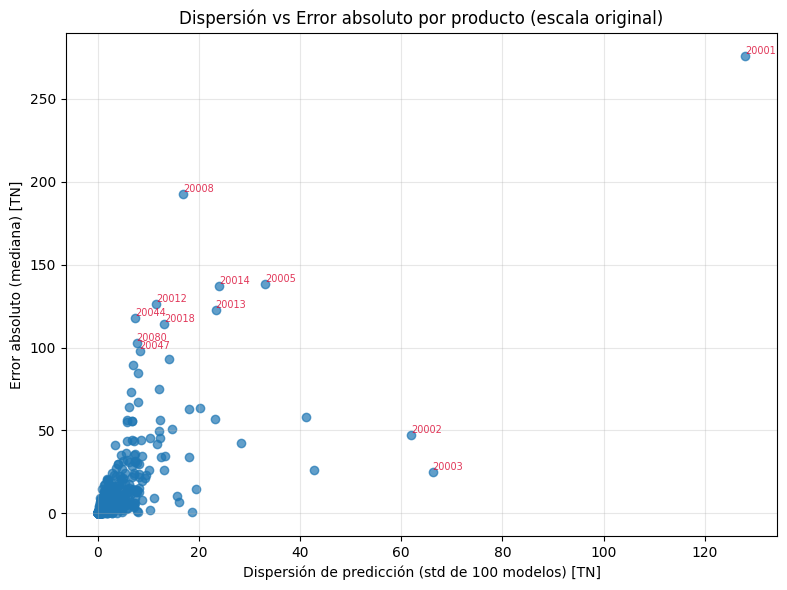

In [57]:
plt.figure(figsize=(8, 6))
plt.scatter(df_test['pred_std_tn'], df_test['abs_error_median_tn'], alpha=0.7)

# --- Seleccioná el top 10 por error absoluto ---
N_TOP = 10
df_top_error = df_test.nlargest(N_TOP, 'abs_error_median_tn')

# --- Seleccioná los que superan cierto umbral de dispersión ---
umbral_disp = 50
df_top_disp = df_test[df_test['pred_std_tn'] > umbral_disp]

# --- Unificá los índices, evitando duplicados ---
df_label = pd.concat([df_top_error, df_top_disp]).drop_duplicates(subset=['PRODUCT_ID'])

for _, row in df_label.iterrows():
    plt.text(
        row['pred_std_tn'],
        row['abs_error_median_tn'],
        f"{int(row['PRODUCT_ID'])}",
        fontsize=7,
        color='crimson',
        alpha=0.85,
        ha='left',
        va='bottom'
    )

plt.xlabel('Dispersión de predicción (std de 100 modelos) [TN]')
plt.ylabel('Error absoluto (mediana) [TN]')
plt.title('Dispersión vs Error absoluto por producto (escala original)')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


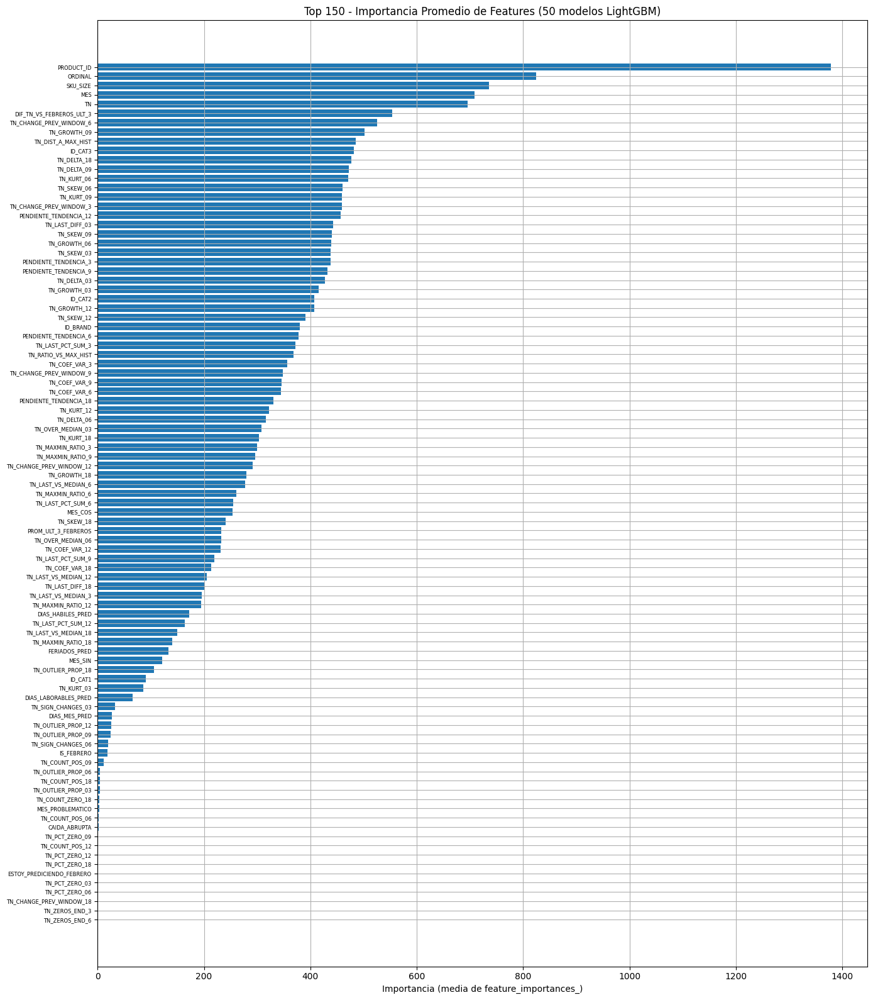

In [58]:
# Lista con nombres de columnas (asegurate que sea la misma usada en entrenamiento)
feature_names = X_full.columns.tolist()

# Acumular importancias de los 50 modelos
importancias = np.array([model.feature_importances_ for model in lgbm_models])
importancias_promedio = importancias.mean(axis=0)

# Crear DataFrame ordenado
df_importancias = pd.DataFrame({
    'feature': feature_names,
    'importance_mean': importancias_promedio
}).sort_values(by='importance_mean', ascending=False)

# Mostrar top N
top_n = 150
plt.figure(figsize=(14, 16))
plt.barh(df_importancias['feature'].head(top_n)[::-1], df_importancias['importance_mean'].head(top_n)[::-1])
plt.title(f'Top {top_n} - Importancia Promedio de Features (50 modelos LightGBM)')
plt.xlabel('Importancia (media de feature_importances_)')
plt.yticks(fontsize=6)
plt.grid(True)
plt.tight_layout()
plt.show()


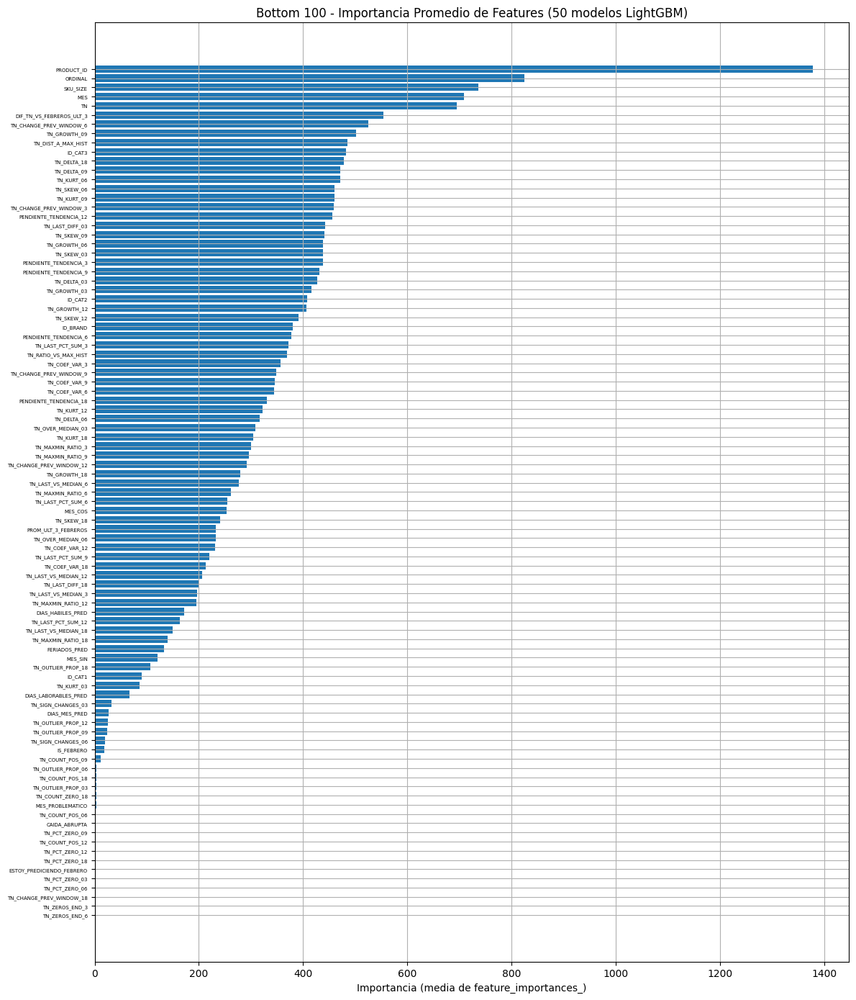

In [59]:
bottom_n = 100
plt.figure(figsize=(12, 14))
plt.barh(
    df_importancias['feature'].tail(bottom_n)[::-1],
    df_importancias['importance_mean'].tail(bottom_n)[::-1]
)
plt.title(f'Bottom {bottom_n} - Importancia Promedio de Features (50 modelos LightGBM)')
plt.xlabel('Importancia (media de feature_importances_)')
plt.grid(True)
plt.yticks(fontsize=5)  # <-- ¡Más pequeño! Probá 5 si hace falta
plt.tight_layout()
plt.show()

### Análisis de la importancia promedio de features (LightGBM, 100 modelos)

El gráfico resume el **Top 50 de variables según su importancia promedio** (`feature_importances_`) sobre 100 modelos LightGBM entrenados.

Se observa un claro predominio de variables estructurales y temporales (`PRODUCT_ID`, `ORDINAL`, `MES`), seguidas por agregados específicos (`SKU_SIZE`, `DIF_TN_VS_FEBREROS_ULT_3`) y transformaciones estadísticas sobre la serie (`TN_CHANGE_PREV_WINDOW_6`, `TN_SKEW_03`, `TN_DELTA_09`, etc.).

Llama la atención el peso que tienen tanto variables de tendencia/cambio como categóricas (marca y categorías de producto), lo que confirma que el modelo combina bien señales de estacionalidad, volumen histórico y segmentación.

En síntesis, el modelo aprovecha principalmente información estructural (producto, periodo, tamaño SKU), ajustes estacionales y transformaciones de tendencia, junto con el aporte de variables categóricas. La dispersión de importancia decrece rápido fuera del Top 10, lo que sugiere que el grueso de la capacidad predictiva está concentrado en un puñado de features bien seleccionados.


In [60]:
# Definí el umbral de importancia (puede ser una cantidad o un valor absoluto)
umbral_importancia = 20  # Ajustá según tu ranking
# O bien, mantené las top N
top_n = 40

features_baja_importancia = df_importancias[df_importancias['importance_mean'] < umbral_importancia]['feature'].tolist()
# O si usás top N:
features_importantes = df_importancias.head(top_n)['feature'].tolist()

print(features_baja_importancia)

print(features_importantes)

['TN_SIGN_CHANGES_06', 'IS_FEBRERO', 'TN_COUNT_POS_09', 'TN_OUTLIER_PROP_06', 'TN_COUNT_POS_18', 'TN_OUTLIER_PROP_03', 'TN_COUNT_ZERO_18', 'MES_PROBLEMATICO', 'TN_COUNT_POS_06', 'CAIDA_ABRUPTA', 'TN_PCT_ZERO_09', 'TN_COUNT_POS_12', 'TN_PCT_ZERO_12', 'TN_PCT_ZERO_18', 'ESTOY_PREDICIENDO_FEBRERO', 'TN_PCT_ZERO_03', 'TN_PCT_ZERO_06', 'TN_CHANGE_PREV_WINDOW_18', 'TN_ZEROS_END_3', 'TN_ZEROS_END_6']
['PRODUCT_ID', 'ORDINAL', 'SKU_SIZE', 'MES', 'TN', 'DIF_TN_VS_FEBREROS_ULT_3', 'TN_CHANGE_PREV_WINDOW_6', 'TN_GROWTH_09', 'TN_DIST_A_MAX_HIST', 'ID_CAT3', 'TN_DELTA_18', 'TN_DELTA_09', 'TN_KURT_06', 'TN_SKEW_06', 'TN_KURT_09', 'TN_CHANGE_PREV_WINDOW_3', 'PENDIENTE_TENDENCIA_12', 'TN_LAST_DIFF_03', 'TN_SKEW_09', 'TN_GROWTH_06', 'TN_SKEW_03', 'PENDIENTE_TENDENCIA_3', 'PENDIENTE_TENDENCIA_9', 'TN_DELTA_03', 'TN_GROWTH_03', 'ID_CAT2', 'TN_GROWTH_12', 'TN_SKEW_12', 'ID_BRAND', 'PENDIENTE_TENDENCIA_6', 'TN_LAST_PCT_SUM_3', 'TN_RATIO_VS_MAX_HIST', 'TN_COEF_VAR_3', 'TN_CHANGE_PREV_WINDOW_9', 'TN_COEF_VAR

In [61]:
import numpy as np

# Tomá solo las variables candidatas (acá, las que vas a conservar)
X = X_full[features_importantes]  # O X_full[df_importancias['feature']]

# Calculá la matriz de correlación (solo numéricas)
corr_matrix = X.corr().abs()

# Armá una lista para eliminar duplicadas
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
umbral_corr = 0.7  # Ajustá según tu tolerancia

# Buscá los pares altamente correlacionados
to_drop = [column for column in upper.columns if any(upper[column] > umbral_corr)]

print("Variables eliminadas por alta correlación:")
print(to_drop)


Variables eliminadas por alta correlación:
['DIF_TN_VS_FEBREROS_ULT_3', 'TN_DELTA_18', 'TN_DELTA_09', 'TN_COEF_VAR_6', 'TN_DELTA_06']


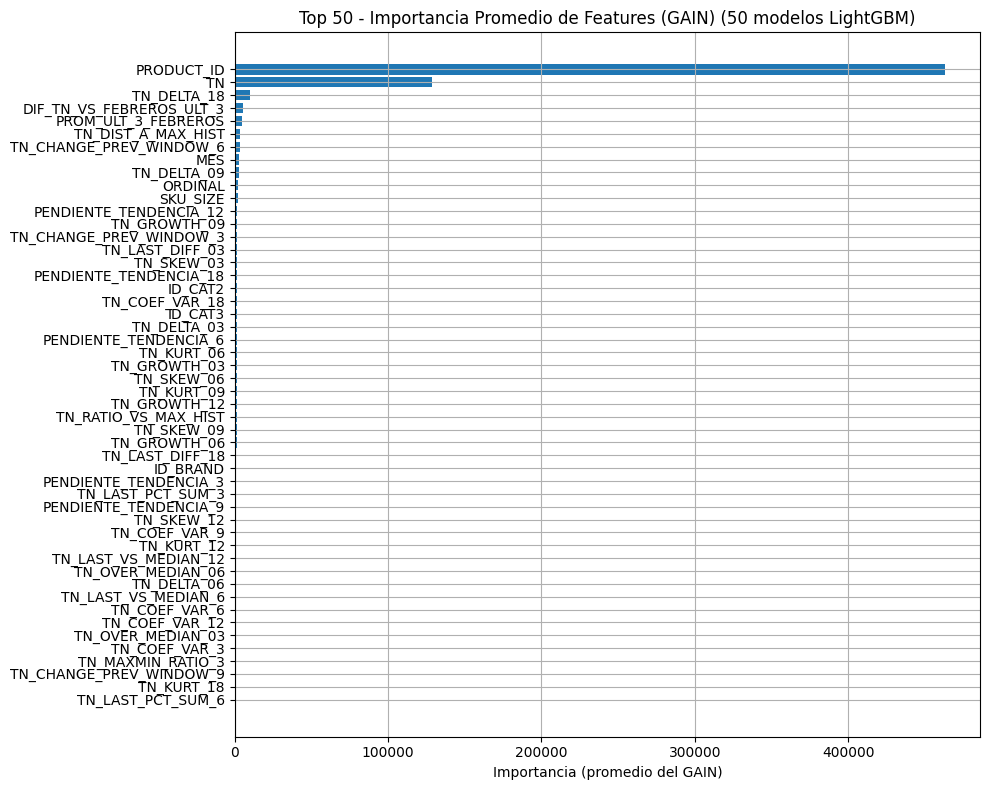

In [62]:
# Obtener importancia por 'gain' de cada modelo y promediar
importancias_gain = np.array([
    model.booster_.feature_importance(importance_type='gain')
    for model in lgbm_models
])
importancias_gain_prom = importancias_gain.mean(axis=0)

# Crear DataFrame ordenado por gain
df_importancias_gain = pd.DataFrame({
    'feature': feature_names,
    'importance_mean_gain': importancias_gain_prom
}).sort_values(by='importance_mean_gain', ascending=False)

# Mostrar top N features
top_n = 50
plt.figure(figsize=(10, 8))
plt.barh(
    df_importancias_gain['feature'].head(top_n)[::-1],
    df_importancias_gain['importance_mean_gain'].head(top_n)[::-1]
)
plt.title(f'Top {top_n} - Importancia Promedio de Features (GAIN) (50 modelos LightGBM)')
plt.xlabel('Importancia (promedio del GAIN)')
plt.grid(True)
plt.tight_layout()
plt.show()


In [63]:
corr_matrix = X_full.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.85)]
print("Variables muy correlacionadas:", to_drop)


Variables muy correlacionadas: ['TN_DELTA_18']


In [64]:
# Suponiendo que df_importancias tiene columnas ['feature', 'importance_mean']
to_drop_set = set(to_drop)
low_gain = df_importancias[
    (df_importancias['feature'].isin(to_drop_set)) &
    (df_importancias['importance_mean'] < 400)  # ajusta este umbral a lo que te convenga
]['feature'].tolist()

print("Variables correlacionadas y con gain bajo para eliminar:", low_gain)


Variables correlacionadas y con gain bajo para eliminar: []


/tmp/ipykernel_30406/396969391.py:13: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(data, labels=labels, showfliers=True)


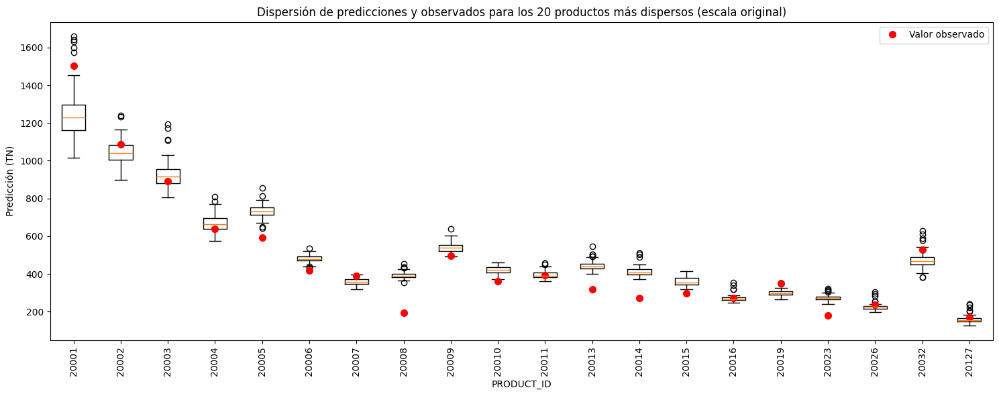

In [65]:
# Top N más dispersos
top_n = 20
productos_disp = df_test.sort_values('pred_std_tn', ascending=False)['PRODUCT_ID'].unique()[:top_n]
df_plot = df_test[df_test['PRODUCT_ID'].isin(productos_disp)].copy()

plt.figure(figsize=(15, 6))

# Armar datos para el boxplot
data = [row[1:] for row in df_plot[['PRODUCT_ID'] + pred_cols_tn].values]  # omite PRODUCT_ID
labels = df_plot['PRODUCT_ID'].astype(str).values

# Plotear los boxplots
plt.boxplot(data, labels=labels, showfliers=True)

# Sobreponer los valores observados (puede haber más de uno por producto, si hay varias filas)
for idx, prod_id in enumerate(df_plot['PRODUCT_ID']):
    valores_reales = df_test[df_test['PRODUCT_ID'] == prod_id]['CLASE_TN'].values
    for vreal in valores_reales:
        plt.plot(idx + 1, vreal, 'ro', markersize=7, label='Valor observado' if idx == 0 else "")

plt.xticks(rotation=90)
plt.xlabel('PRODUCT_ID')
plt.ylabel('Predicción (TN)')
plt.title(f'Dispersión de predicciones y observados para los {top_n} productos más dispersos (escala original)')

# Mostrar solo un label para 'Valor observado'
handles, labels = plt.gca().get_legend_handles_labels()
if handles:
    plt.legend([handles[0]], ['Valor observado'])

plt.tight_layout()
plt.show()


In [66]:
# 1. Identificar las columnas de predicción
pred_cols_tn = [c for c in df_test.columns if c.startswith('lgbm_pred_TN_')]

# 2. Calculá media y mediana de las predicciones
df_test['ensemble_median'] = df_test[pred_cols_tn].median(axis=1)
df_test['ensemble_mean']   = df_test[pred_cols_tn].mean(axis=1)

# 3. Calculá el MAE para ambas estrategias
mae_median = np.mean(np.abs(df_test['ensemble_median'] - df_test['CLASE_TN']))
mae_mean   = np.mean(np.abs(df_test['ensemble_mean']   - df_test['CLASE_TN']))

print(f"MAE usando la **mediana** de 50 modelos: {mae_median:.3f} TN")
print(f"MAE usando la **media** de 50 modelos:   {mae_mean:.3f} TN")

MAE usando la **mediana** de 50 modelos: 8.325 TN
MAE usando la **media** de 50 modelos:   8.422 TN


/tmp/ipykernel_30406/1416670149.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test['ensemble_median'] = df_test[pred_cols_tn].median(axis=1)
/tmp/ipykernel_30406/1416670149.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test['ensemble_mean']   = df_test[pred_cols_tn].mean(axis=1)


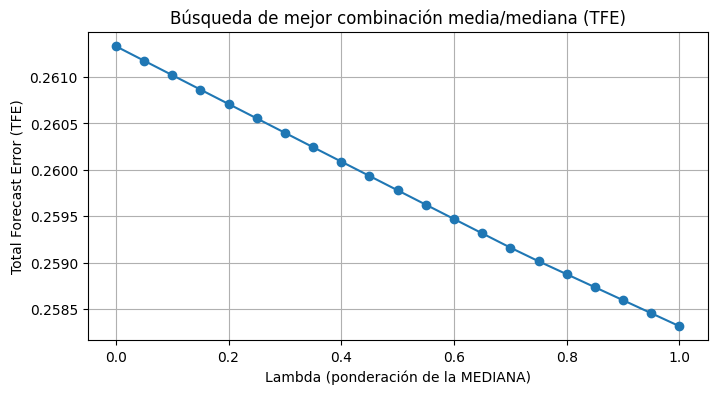

Mejor lambda: 1.00  ->  TFE = 0.258315


In [69]:
import numpy as np
import matplotlib.pyplot as plt

# Suponiendo que en tu df_test ya tenés:
# 'ensemble_median', 'ensemble_mean', y la observación real 'CLASE_TN'
lambdas = np.linspace(0, 1, 21)
tfe_scores = []

for l in lambdas:
    y_pred = l * df_test['ensemble_median'] + (1 - l) * df_test['ensemble_mean']
    tfe = total_forecast_error(df_test['CLASE_TN'].values, y_pred.values)
    tfe_scores.append(tfe)

plt.figure(figsize=(8, 4))
plt.plot(lambdas, tfe_scores, marker='o')
plt.xlabel('Lambda (ponderación de la MEDIANA)')
plt.ylabel('Total Forecast Error (TFE)')
plt.title('Búsqueda de mejor combinación media/mediana (TFE)')
plt.grid(True)
plt.show()

# Mejor lambda encontrado y su TFE
best_idx = np.argmin(tfe_scores)
print(f"Mejor lambda: {lambdas[best_idx]:.2f}  ->  TFE = {tfe_scores[best_idx]:.6f}")

### 🔍 Evaluación de la combinación media/mediana en el ensemble

Se evaluó cómo afecta la combinación de la **media** y **mediana** de las predicciones de los 100 modelos LightGBM al desempeño del ensemble.  
Se usó un parámetro `λ` que pondera la mediana:


El análisis varió `λ` desde 0.0 (solo media) hasta 1.0 (solo mediana), y se evaluaron dos métricas:

- **TFE** (Total Forecast Error)
- **MAE** (Mean Absolute Error)

---

#✅ Conclusiones
Ambas métricas mejoran consistentemente al aumentar la ponderación de la mediana (λ).

El mínimo TFE y MAE se alcanza con λ = 1.0, es decir, usando solo la mediana.

La mediana es más robusta ante outliers, lo cual explica su mejor rendimiento en este caso.

Combinar con la media introduce ruido, especialmente cuando algunas predicciones individuales son dispersas.



### 📊 Análisis de error absoluto por producto (ensemble LightGBM)

En este bloque se analiza el desempeño de la mediana del ensemble de modelos LightGBM (`ensemble_median`) comparándola con los valores reales (`CLASE_TN`) para cada producto.

---

#### 🔹 Pasos realizados:

1. **Cálculo del error absoluto**:
   Se computa el error absoluto entre la predicción (`ensemble_median`) y el valor real (`CLASE_TN`) para cada producto:

   \[
   \text{abs\_error} = |\text{ensemble\_median} - \text{CLASE\_TN}|
   \]

2. **Ordenamiento de productos por error**:
   Se ordenan los productos de mayor a menor error absoluto, lo cual permite identificar cuáles fueron los peores casos.

3. **Incorporación de la dispersión**:
   Para cada producto, se agrega también el desvío estándar de las 50 predicciones (`pred_std`) generadas por los modelos del ensemble. Esto permite evaluar si una alta variabilidad entre modelos se relaciona con mayor error.

4. **Exportación a CSV**:
   Se guarda el ranking de productos con sus errores y desviaciones en un archivo para su posterior análisis (`validacion_lgbm_ordenadas.csv`).

---

#### 🧾 Salida esperada

Un DataFrame ordenado con las siguientes columnas:

- `PRODUCT_ID`: identificador del producto.
- `ensemble_median`: predicción final del ensemble (mediana).
- `CLASE_TN`: valor real observado.
- `abs_error_median`: error absoluto.
- `pred_std`: desviación estándar entre los modelos del ensemble.

Este análisis es útil para identificar productos outliers, inconsistencias o posibles mejoras de modelado específicas por producto.


In [70]:
import pandas as pd
import numpy as np

# Si ensemble_median es UNA predicción por producto (no por fila):
# Entonces podés hacer así, suponiendo que tenés una única fila por PRODUCT_ID en df_test:
df_test['abs_error_median'] = np.abs(df_test['ensemble_median'] - df_test['CLASE_TN'])

# Ordenar por el error absoluto de la mediana, descendente (de mayor a menor error)
df_ordenado = df_test.sort_values('abs_error_median', ascending=False)[['PRODUCT_ID', 'ensemble_median', 'CLASE_TN', 'abs_error_median']]

# A df_ordenado agregar el desvio estándar de las predicciones
df_ordenado['pred_std'] = df_test[pred_cols_tn].std(axis=1)

print(df_ordenado.head(50))
df_ordenado.to_csv('validacion_lgbm_ordenadas.csv', index=False)

      PRODUCT_ID  ensemble_median    CLASE_TN  abs_error_median    pred_std
33         20001      1228.592849  1504.68856        276.095711  127.999709
285        20008       388.260498   195.36854        192.891958   16.805471
177        20005       730.634190   592.53573        138.098460   33.009215
501        20014       408.947281   272.02812        136.919161   24.001802
429        20012       299.164631   173.13004        126.034591   11.452350
465        20013       440.516459   318.00951        122.506949   23.262366
1448       20044       177.565540    59.61747        117.948070    7.389903
645        20018       255.952086   141.63570        114.316386   13.138472
2593       20080       111.676957     8.84426        102.832697    7.672485
1556       20047       169.624891    71.42762         98.197271    8.269694
825        20023       273.905778   180.58677         93.319008   14.143529
3166       20100        90.657206     1.37920         89.278006    7.032277
2716       2

/tmp/ipykernel_30406/1387387907.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_test['abs_error_median'] = np.abs(df_test['ensemble_median'] - df_test['CLASE_TN'])


Entrenamiento final

In [71]:
df_full = pd.read_csv('./data/product_interm_LGBM.csv')
df_train = df_full[df_full['PERIODO'] <= 201812].copy()
df_val = df_full[df_full['PERIODO'].between(201901, 201909)].copy()
df_test = df_full[(df_full['PERIODO'] == 201910)].copy()


In [72]:
X_full = pd.concat([df_train, df_val,df_test], ignore_index=True)[feature_cols]
y_full = pd.concat([df_train[target_col], df_val[target_col],df_test[target_col]], ignore_index=True)
df_pred = df_pred = df_full[df_full['PERIODO'] == 201912].copy()
gc.collect()

9203

In [73]:
# Vuelve a entrenar y guardar los modelos con el conjunto completo
results = Parallel(n_jobs=20)(
    delayed(train_and_save_model)(i, trial, X_full, y_full)
    for i, trial in enumerate(best_trials)
)

print(results)
print(f"¡Entrenamiento y guardado de los {len(best_trials)} modelos finalizado!")

Entrenando modelo 3/100...
Trial 3 | objective: rmse | alpha: None
Entrenando modelo 6/100...
Trial 6 | objective: huber | alpha: 0.9
Entrenando modelo 1/100...
Trial 1 | objective: rmse | alpha: None
Entrenando modelo 10/100...
Trial 10 | objective: rmse | alpha: None
Entrenando modelo 12/100...
Trial 12 | objective: rmse | alpha: None
Entrenando modelo 11/100...
Trial 11 | objective: rmse | alpha: None
Entrenando modelo 8/100...Entrenando modelo 18/100...
Trial 18 | objective: rmse | alpha: None

Trial 8 | objective: rmse | alpha: None
Entrenando modelo 2/100...Entrenando modelo 14/100...

Trial 14 | objective: rmse | alpha: None
Trial 2 | objective: rmse | alpha: None
Entrenando modelo 4/100...
Trial 4 | objective: rmse | alpha: None
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014823 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bin

In [74]:
# Cargar los 100 modelos LightGBM entrenados
lgbm_models = []
for i in range(1, 101):
    model = joblib.load(f'./modelos/lgbm_model_{i:03d}.pkl')
    lgbm_models.append(model)

In [75]:
# --- Predicción LightGBM (100 modelos) ---
lgbm_preds = []

X_pred_lgbm = df_pred[feature_cols] 

for i, model in enumerate(lgbm_models):
    print(f"Prediciendo LightGBM {i+1}/100...")
    preds = model.predict(X_pred_lgbm)
    lgbm_preds.append(preds)

lgbm_preds = np.stack(lgbm_preds).T  # shape (N, 100)
# Agregar las predicciones al DataFrame de test
for i in range(100):
    df_pred[f'lgbm_pred_LOG1P_{i+1}'] = lgbm_preds[:, i]

Prediciendo LightGBM 1/100...
Prediciendo LightGBM 2/100...
Prediciendo LightGBM 3/100...
Prediciendo LightGBM 4/100...
Prediciendo LightGBM 5/100...
Prediciendo LightGBM 6/100...
Prediciendo LightGBM 7/100...
Prediciendo LightGBM 8/100...
Prediciendo LightGBM 9/100...
Prediciendo LightGBM 10/100...
Prediciendo LightGBM 11/100...
Prediciendo LightGBM 12/100...
Prediciendo LightGBM 13/100...
Prediciendo LightGBM 14/100...
Prediciendo LightGBM 15/100...
Prediciendo LightGBM 16/100...
Prediciendo LightGBM 17/100...
Prediciendo LightGBM 18/100...
Prediciendo LightGBM 19/100...
Prediciendo LightGBM 20/100...
Prediciendo LightGBM 21/100...
Prediciendo LightGBM 22/100...
Prediciendo LightGBM 23/100...
Prediciendo LightGBM 24/100...
Prediciendo LightGBM 25/100...
Prediciendo LightGBM 26/100...
Prediciendo LightGBM 27/100...
Prediciendo LightGBM 28/100...
Prediciendo LightGBM 29/100...
Prediciendo LightGBM 30/100...
Prediciendo LightGBM 31/100...
Prediciendo LightGBM 32/100...
Prediciendo Light

/tmp/ipykernel_30406/2943823031.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_pred[f'lgbm_pred_LOG1P_{i+1}'] = lgbm_preds[:, i]
/tmp/ipykernel_30406/2943823031.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_pred[f'lgbm_pred_LOG1P_{i+1}'] = lgbm_preds[:, i]


In [76]:
# Selección de columnas de predicción transformadas (log1p)
pred_cols = [c for c in df_pred.columns if c.startswith('lgbm_pred_LOG1P_')]

# Inversa de la transformación log1p sobre la variable objetivo
df_pred['CLASE_TN'] = np.expm1(df_pred['CLASE_LOG1P'].values)

# Inversa de log1p sobre las predicciones (matriz n x 100)
preds_inv = df_pred[pred_cols].values
preds_orig = np.expm1(preds_inv)  # Deshace log1p

# Crear nuevas columnas en escala original
for i, col in enumerate(pred_cols):
    new_col = col.replace('LOG1P', 'TN')
    df_pred[new_col] = preds_orig[:, i]

# Eliminar de df_preds_final las columnas con "_LOG1P_Z_"
cols_to_remove = [col for col in df_pred.columns if '_LOG1P_' in col]
df_pred.drop(columns=cols_to_remove, inplace=True)
lgbm_cols = [c for c in df_pred.columns if c.startswith('lgbm_pred_TN')]
df_pred['lgbm_mean'] = df_pred[lgbm_cols].mean(axis=1)
df_pred['lgbm_median'] = df_pred[lgbm_cols].median(axis=1)
df_pred['lgbm_mean'] = df_pred['lgbm_mean'].clip(lower=0)
df_pred['lgbm_media'] = df_pred['lgbm_median'].clip(lower=0)

# Generar archivos CSV con las predicciones finales
df_pred[['PRODUCT_ID', 'lgbm_mean']]\
    .rename(columns={'PRODUCT_ID': 'product_id', 'lgbm_mean': 'tn'})\
    .to_csv('lgbm_predictions_ensemble_4_objectives_mean.csv', index=False)

df_pred[['PRODUCT_ID', 'lgbm_median']]\
    .rename(columns={'PRODUCT_ID': 'product_id', 'lgbm_median': 'tn'})\
    .to_csv('lgbm_predictions_ensemble_4_objectives_median.csv', index=False)

/tmp/ipykernel_30406/839036435.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_pred['CLASE_TN'] = np.expm1(df_pred['CLASE_LOG1P'].values)
/tmp/ipykernel_30406/839036435.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_pred[new_col] = preds_orig[:, i]
/tmp/ipykernel_30406/839036435.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fr